# Load libraries

In [26]:
library(Seurat)
library(Signac)
library(MAST)
library(ggplot2)
library(cowplot)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(RColorBrewer)
library(TFBSTools)
library(JASPAR2020)
library(motifmatchr)
library(chromVAR)
library(tidyr)
library(plyr)
library(dplyr)
library(stringr)
library(wesanderson)
library(SeuratWrappers)
library(reshape2)
library(clustree)
library(DoubletFinder)
library(viridis)
library(pheatmap)
library(glmGamPoi)
library(DESeq2)
library(pals)
library(BiocParallel)
library(ArchR)
library(MAST)
library(edgeR)
library(rtracklayer)
library(ComplexHeatmap)
library(circlize)
library(GenomicRanges)
library(GenomicFeatures)
library(biomaRt)
library(Matrix.utils)
library(ggplotify)
library(rpgm)
library(eulerr)
library(ensembldb)
library(DropletUtils)
library(parallel)
library(ggrepel)
library(paletteer)
library(scales)
library(colorspace)
library(PNWColors)
library(shades)
library(egg)
library(jaffelab)
library(ltc)
library(Rmisc)
library(ggh4x)
library(clusterProfiler)
library(org.Mm.eg.db)
library(presto)
library(ggbreak)
library(ggsignif)
library(effectsize)
library(data.table)

'%notin%' <- Negate('%in%')
scaleFUN <- function(x) sprintf("%.2f", x)

options(repr.matrix.max.cols=50, repr.matrix.max.rows=100)


Attaching package: 'shades'


The following object is masked from 'package:colorspace':

    coords


The following object is masked from 'package:rtracklayer':

    space


The following object is masked from 'package:Biostrings':

    complement


The following object is masked from 'package:GenomicFeatures':

    distance


The following object is masked from 'package:SummarizedExperiment':

    distance


The following object is masked from 'package:GenomicRanges':

    distance


The following objects are masked from 'package:IRanges':

    distance, space


The following object is masked from 'package:S4Vectors':

    space


The following object is masked from 'package:Signac':

    distance


Loading required package: rafalib


Attaching package: 'rafalib'


The following object is masked from 'package:devtools':

    install_bioc


Loading required package: lattice


Attaching package: 'lattice'


The following object is masked from 'package:rafalib':

    stripplot


cluster

In [2]:
# Create 'regionize' function for conveniency
regionize <- function(x) {
   y <- gsub(',', '', gsub(':', '-', x))
   paste0(unlist(strsplit(y,'-'))[1],'-',
          as.numeric(unlist(strsplit(y,'-'))[2]) - 5000,'-',
          as.numeric(unlist(strsplit(y,'-'))[3]) + 5000)
}

# Import RNA UMI files

In [3]:
BG_file_paths <- list.files('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/BG_RNA_UMI/', full.names = T)
CD_file_paths <- list.files('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/CD_RNA_UMI/', full.names = T)

In [ ]:
# Load UMI counts as tables (cannot run mclapply on multi-threaded function w/o running error)
BG_UMI_tables <- lapply(BG_file_paths, fread, data.table = FALSE)
CD_UMI_tables <- lapply(CD_file_paths, fread, data.table = FALSE)

In [ ]:
# Change row names
BG_UMI_df <- lapply(BG_UMI_tables, function(x) {rownames(x) <- x$gene
                                   x <- x[,-1]})
CD_UMI_df <- lapply(CD_UMI_tables, function(x) {rownames(x) <- x$gene
                                   x <- x[,-1]})

In [ ]:
# Convert to Seurat objects
BG_seurat_list <- lapply(BG_UMI_df, CreateSeuratObject)
CD_seurat_list <- lapply(CD_UMI_df, CreateSeuratObject)

In [ ]:
# Set condition metadata
BG_cond_list <- as.list(do.call(rbind,strsplit(BG_file_paths,'_'))[,9])
names(BG_cond_list) <- names(BG_seurat_list)

CD_cond_list <- as.list(do.call(rbind,strsplit(CD_file_paths,'_'))[,9])
names(CD_cond_list) <- names(CD_seurat_list)

In [ ]:
# Set timepoint metadata
BG_time_list <- as.list(do.call(rbind,strsplit(BG_file_paths,'_'))[,10])
names(BG_time_list) <- names(BG_seurat_list)

CD_time_list <- as.list(do.call(rbind,strsplit(CD_file_paths,'_'))[,10])
names(CD_time_list) <- names(CD_seurat_list)

In [ ]:
# Set sex metadata
BG_sex_list <- as.list(do.call(rbind,strsplit(BG_file_paths,'_'))[,11])
names(BG_sex_list) <- names(BG_seurat_list)

CD_sex_list <- as.list(do.call(rbind,strsplit(CD_file_paths,'_'))[,11])
names(CD_sex_list) <- names(CD_seurat_list)

In [ ]:
# Add condition metadata
BG_seurat_list[[1]]$Treatment <- BG_cond_list[[1]]
BG_seurat_list[[2]]$Treatment <- BG_cond_list[[2]]
BG_seurat_list[[3]]$Treatment <- BG_cond_list[[3]]
BG_seurat_list[[4]]$Treatment <- BG_cond_list[[4]]
BG_seurat_list[[5]]$Treatment <- BG_cond_list[[5]]
BG_seurat_list[[6]]$Treatment <- BG_cond_list[[6]]
BG_seurat_list[[7]]$Treatment <- BG_cond_list[[7]]
BG_seurat_list[[8]]$Treatment <- BG_cond_list[[8]]
BG_seurat_list[[9]]$Treatment <- BG_cond_list[[9]]
BG_seurat_list[[10]]$Treatment <- BG_cond_list[[10]]
BG_seurat_list[[11]]$Treatment <- BG_cond_list[[11]]
BG_seurat_list[[12]]$Treatment <- BG_cond_list[[12]]
BG_seurat_list[[13]]$Treatment <- BG_cond_list[[13]]
BG_seurat_list[[14]]$Treatment <- BG_cond_list[[14]]
BG_seurat_list[[15]]$Treatment <- BG_cond_list[[15]]
BG_seurat_list[[16]]$Treatment <- BG_cond_list[[16]]
BG_seurat_list[[17]]$Treatment <- BG_cond_list[[17]]
BG_seurat_list[[18]]$Treatment <- BG_cond_list[[18]]
BG_seurat_list[[19]]$Treatment <- BG_cond_list[[19]]
BG_seurat_list[[20]]$Treatment <- BG_cond_list[[20]]

CD_seurat_list[[1]]$Treatment <- CD_cond_list[[1]]
CD_seurat_list[[2]]$Treatment <- CD_cond_list[[2]]
CD_seurat_list[[3]]$Treatment <- CD_cond_list[[3]]
CD_seurat_list[[4]]$Treatment <- CD_cond_list[[4]]
CD_seurat_list[[5]]$Treatment <- CD_cond_list[[5]]
CD_seurat_list[[6]]$Treatment <- CD_cond_list[[6]]
CD_seurat_list[[7]]$Treatment <- CD_cond_list[[7]]
CD_seurat_list[[8]]$Treatment <- CD_cond_list[[8]]
CD_seurat_list[[9]]$Treatment <- CD_cond_list[[9]]
CD_seurat_list[[10]]$Treatment <- CD_cond_list[[10]]
CD_seurat_list[[11]]$Treatment <- CD_cond_list[[11]]
CD_seurat_list[[12]]$Treatment <- CD_cond_list[[12]]
CD_seurat_list[[13]]$Treatment <- CD_cond_list[[13]]
CD_seurat_list[[14]]$Treatment <- CD_cond_list[[14]]
CD_seurat_list[[15]]$Treatment <- CD_cond_list[[15]]
CD_seurat_list[[16]]$Treatment <- CD_cond_list[[16]]
CD_seurat_list[[17]]$Treatment <- CD_cond_list[[17]]
CD_seurat_list[[18]]$Treatment <- CD_cond_list[[18]]
CD_seurat_list[[19]]$Treatment <- CD_cond_list[[19]]
CD_seurat_list[[20]]$Treatment <- CD_cond_list[[20]]

In [ ]:
# Add time metadata
BG_seurat_list[[1]]$Time <- BG_time_list[[1]]
BG_seurat_list[[2]]$Time <- BG_time_list[[2]]
BG_seurat_list[[3]]$Time <- BG_time_list[[3]]
BG_seurat_list[[4]]$Time <- BG_time_list[[4]]
BG_seurat_list[[5]]$Time <- BG_time_list[[5]]
BG_seurat_list[[6]]$Time <- BG_time_list[[6]]
BG_seurat_list[[7]]$Time <- BG_time_list[[7]]
BG_seurat_list[[8]]$Time <- BG_time_list[[8]]
BG_seurat_list[[9]]$Time <- BG_time_list[[9]]
BG_seurat_list[[10]]$Time <- BG_time_list[[10]]
BG_seurat_list[[11]]$Time <- BG_time_list[[11]]
BG_seurat_list[[12]]$Time <- BG_time_list[[12]]
BG_seurat_list[[13]]$Time <- BG_time_list[[13]]
BG_seurat_list[[14]]$Time <- BG_time_list[[14]]
BG_seurat_list[[15]]$Time <- BG_time_list[[15]]
BG_seurat_list[[16]]$Time <- BG_time_list[[16]]
BG_seurat_list[[17]]$Time <- BG_time_list[[17]]
BG_seurat_list[[18]]$Time <- BG_time_list[[18]]
BG_seurat_list[[19]]$Time <- BG_time_list[[19]]
BG_seurat_list[[20]]$Time <- BG_time_list[[20]]

CD_seurat_list[[1]]$Time <- CD_time_list[[1]]
CD_seurat_list[[2]]$Time <- CD_time_list[[2]]
CD_seurat_list[[3]]$Time <- CD_time_list[[3]]
CD_seurat_list[[4]]$Time <- CD_time_list[[4]]
CD_seurat_list[[5]]$Time <- CD_time_list[[5]]
CD_seurat_list[[6]]$Time <- CD_time_list[[6]]
CD_seurat_list[[7]]$Time <- CD_time_list[[7]]
CD_seurat_list[[8]]$Time <- CD_time_list[[8]]
CD_seurat_list[[9]]$Time <- CD_time_list[[9]]
CD_seurat_list[[10]]$Time <- CD_time_list[[10]]
CD_seurat_list[[11]]$Time <- CD_time_list[[11]]
CD_seurat_list[[12]]$Time <- CD_time_list[[12]]
CD_seurat_list[[13]]$Time <- CD_time_list[[13]]
CD_seurat_list[[14]]$Time <- CD_time_list[[14]]
CD_seurat_list[[15]]$Time <- CD_time_list[[15]]
CD_seurat_list[[16]]$Time <- CD_time_list[[16]]
CD_seurat_list[[17]]$Time <- CD_time_list[[17]]
CD_seurat_list[[18]]$Time <- CD_time_list[[18]]
CD_seurat_list[[19]]$Time <- CD_time_list[[19]]
CD_seurat_list[[20]]$Time <- CD_time_list[[20]]

In [ ]:
# Add sex metadata
BG_seurat_list[[1]]$Sex <-  BG_sex_list[[1]]
BG_seurat_list[[2]]$Sex <-  BG_sex_list[[2]]
BG_seurat_list[[3]]$Sex <-  BG_sex_list[[3]]
BG_seurat_list[[4]]$Sex <-  BG_sex_list[[4]]
BG_seurat_list[[5]]$Sex <-  BG_sex_list[[5]]
BG_seurat_list[[6]]$Sex <-  BG_sex_list[[6]]
BG_seurat_list[[7]]$Sex <-  BG_sex_list[[7]]
BG_seurat_list[[8]]$Sex <-  BG_sex_list[[8]]
BG_seurat_list[[9]]$Sex <-  BG_sex_list[[9]]
BG_seurat_list[[10]]$Sex <- BG_sex_list[[10]]
BG_seurat_list[[11]]$Sex <- BG_sex_list[[11]]
BG_seurat_list[[12]]$Sex <- BG_sex_list[[12]]
BG_seurat_list[[13]]$Sex <- BG_sex_list[[13]]
BG_seurat_list[[14]]$Sex <- BG_sex_list[[14]]
BG_seurat_list[[15]]$Sex <- BG_sex_list[[15]]
BG_seurat_list[[16]]$Sex <- BG_sex_list[[16]]
BG_seurat_list[[17]]$Sex <- BG_sex_list[[17]]
BG_seurat_list[[18]]$Sex <- BG_sex_list[[18]]
BG_seurat_list[[19]]$Sex <- BG_sex_list[[19]]
BG_seurat_list[[20]]$Sex <- BG_sex_list[[20]]

CD_seurat_list[[1]]$Sex <-  CD_sex_list[[1]]
CD_seurat_list[[2]]$Sex <-  CD_sex_list[[2]]
CD_seurat_list[[3]]$Sex <-  CD_sex_list[[3]]
CD_seurat_list[[4]]$Sex <-  CD_sex_list[[4]]
CD_seurat_list[[5]]$Sex <-  CD_sex_list[[5]]
CD_seurat_list[[6]]$Sex <-  CD_sex_list[[6]]
CD_seurat_list[[7]]$Sex <-  CD_sex_list[[7]]
CD_seurat_list[[8]]$Sex <-  CD_sex_list[[8]]
CD_seurat_list[[9]]$Sex <-  CD_sex_list[[9]]
CD_seurat_list[[10]]$Sex <- CD_sex_list[[10]]
CD_seurat_list[[11]]$Sex <- CD_sex_list[[11]]
CD_seurat_list[[12]]$Sex <- CD_sex_list[[12]]
CD_seurat_list[[13]]$Sex <- CD_sex_list[[13]]
CD_seurat_list[[14]]$Sex <- CD_sex_list[[14]]
CD_seurat_list[[15]]$Sex <- CD_sex_list[[15]]
CD_seurat_list[[16]]$Sex <- CD_sex_list[[16]]
CD_seurat_list[[17]]$Sex <- CD_sex_list[[17]]
CD_seurat_list[[18]]$Sex <- CD_sex_list[[18]]
CD_seurat_list[[19]]$Sex <- CD_sex_list[[19]]
CD_seurat_list[[20]]$Sex <- CD_sex_list[[20]]

# Doublet removal for each sample with scrublet

In [ ]:
# Filter out low-count barcodes
BG_seurat_list_filter <- lapply(BG_seurat_list, function(x){subset(x, subset = nCount_RNA > 600)})
CD_seurat_list_filter <- lapply(CD_seurat_list, function(x){subset(x, subset = nCount_RNA > 600)})

In [ ]:
sample_names <- mapply(function(x,y,z){paste0(x,'_',y,'_',z)},
       x = BG_cond_list,
       y = BG_time_list,
       z = BG_sex_list)

In [ ]:
# Export matrix files for doublet removal with scrublet
mapply(function(x,y) {write10xCounts(x@assays$RNA@counts,
                                              path = paste0('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/BG_',y,'_mtx'))},
      x = BG_seurat_list_filter, 
      y = sample_names)

mapply(function(x,y) {write10xCounts(x@assays$RNA@counts,
                                              path = paste0('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/CD_',y,'_mtx'))},
      x = CD_seurat_list_filter, 
      y = sample_names)

In [ ]:
# Import scrublet results
BG_scrub_paths <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/', pattern = glob2rx("BG*scrublet_output_table.csv"), full.names = T)
BG_scrub_output <- lapply(BG_scrub_paths,read.csv)
names(sample_names) <- sample_names
names(BG_scrub_output) <- names(sample_names)
names(BG_seurat_list_filter) <- names(BG_scrub_output)

CD_scrub_paths <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/', pattern = glob2rx("CD*scrublet_output_table.csv"), full.names = T)
CD_scrub_output <- lapply(CD_scrub_paths,read.csv)
names(CD_scrub_output) <- names(sample_names)
names(CD_seurat_list_filter) <- names(CD_scrub_output)

BG_seurat_list_merge_filter_doub <- mapply(function(x,y) {
                                        x$doublet_score <- BG_scrub_output[[y]]$doublet_score
                                        x$predicted_doublet <- BG_scrub_output[[y]]$predicted_doublet
                                        return(x)},
                                        x = BG_seurat_list_filter,
                                        y = sample_names)
CD_seurat_list_merge_filter_doub <- mapply(function(x,y) {
                                        x$doublet_score <- CD_scrub_output[[y]]$doublet_score
                                        x$predicted_doublet <- CD_scrub_output[[y]]$predicted_doublet
                                        return(x)},
                                        x = CD_seurat_list_filter,
                                        y = sample_names)

In [ ]:
# Merge objects
BG_seurat_list_merge <- merge(BG_seurat_list_merge_filter_doub[[1]], y = c(BG_seurat_list_merge_filter_doub[[2]],
                                                                           BG_seurat_list_merge_filter_doub[[3]],
                                                                           BG_seurat_list_merge_filter_doub[[4]],
                                                                           BG_seurat_list_merge_filter_doub[[5]],
                                                                           BG_seurat_list_merge_filter_doub[[6]],
                                                                           BG_seurat_list_merge_filter_doub[[7]],
                                                                           BG_seurat_list_merge_filter_doub[[8]],
                                                                           BG_seurat_list_merge_filter_doub[[9]],
                                                                           BG_seurat_list_merge_filter_doub[[10]],
                                                                           BG_seurat_list_merge_filter_doub[[11]],
                                                                           BG_seurat_list_merge_filter_doub[[12]],
                                                                           BG_seurat_list_merge_filter_doub[[13]],
                                                                           BG_seurat_list_merge_filter_doub[[14]],
                                                                           BG_seurat_list_merge_filter_doub[[15]],
                                                                           BG_seurat_list_merge_filter_doub[[16]],
                                                                           BG_seurat_list_merge_filter_doub[[17]],
                                                                           BG_seurat_list_merge_filter_doub[[18]],
                                                                           BG_seurat_list_merge_filter_doub[[19]],
                                                                           BG_seurat_list_merge_filter_doub[[20]]))

CD_seurat_list_merge <- merge(CD_seurat_list_merge_filter_doub[[1]], y = c(CD_seurat_list_merge_filter_doub[[2]],
                                                                           CD_seurat_list_merge_filter_doub[[3]],
                                                                           CD_seurat_list_merge_filter_doub[[4]],
                                                                           CD_seurat_list_merge_filter_doub[[5]],
                                                                           CD_seurat_list_merge_filter_doub[[6]],
                                                                           CD_seurat_list_merge_filter_doub[[7]],
                                                                           CD_seurat_list_merge_filter_doub[[8]],
                                                                           CD_seurat_list_merge_filter_doub[[9]],
                                                                           CD_seurat_list_merge_filter_doub[[10]],
                                                                           CD_seurat_list_merge_filter_doub[[11]],
                                                                           CD_seurat_list_merge_filter_doub[[12]],
                                                                           CD_seurat_list_merge_filter_doub[[13]],
                                                                           CD_seurat_list_merge_filter_doub[[14]],
                                                                           CD_seurat_list_merge_filter_doub[[15]],
                                                                           CD_seurat_list_merge_filter_doub[[16]],
                                                                           CD_seurat_list_merge_filter_doub[[17]],
                                                                           CD_seurat_list_merge_filter_doub[[18]],
                                                                           CD_seurat_list_merge_filter_doub[[19]],
                                                                           CD_seurat_list_merge_filter_doub[[20]]))

In [ ]:
# Add name to metadata
BG_seurat_list_merge$library <- 'BG_v2'
CD_seurat_list_merge$library <- 'CD_v2'

In [ ]:
# Save the processed datasets
saveRDS(BG_seurat_list_merge, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/BG_seurat_list_merge.rds')
saveRDS(CD_seurat_list_merge, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/CD_seurat_list_merge.rds')

In [ ]:
# Read in processed datasets
BG_seurat_list_merge <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/BG_seurat_list_merge.rds')
CD_seurat_list_merge <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/CD_seurat_list_merge.rds')

In [ ]:
# Merge two objects
merged_datasets <- merge(BG_seurat_list_merge, y = CD_seurat_list_merge)

In [ ]:
names(merged_datasets@meta.data)[names(merged_datasets@meta.data) == 'Time'] <- 'Timepoint'

In [ ]:
# Load file from replicates 1-2
V1_merged_original <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/RNA/RDS/2022_01_07_SHAREseq_Postnatal_V1_Merged_RNA_Seurat_FilterV2.rds')

In [ ]:
# Combine replicates 3-4 with replicates 1-2 into single object
V1_merged_original$library <- 'CD_v1'
final_obj <- merge(merged_datasets, y = V1_merged_original)

In [ ]:
# Save the merged datasets
saveRDS(merged_datasets, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/merged_datasets.rds')
saveRDS(final_obj, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/final_obj.rds')

In [ ]:
# Read in merged object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/final_obj.rds')

In [ ]:
# Filter out low-count & high-count nuclei
final_obj_subset <- subset(final_obj, subset = nCount_RNA  < 80000 & nCount_RNA > 750)

In [ ]:
# Combine time and treatment into single variable
final_obj_subset$Timepoint_treatment <- paste0(final_obj_subset$Timepoint,'_',final_obj_subset$Treatment)

In [ ]:
# Save object after filtering
saveRDS(final_obj_subset, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/final_obj_subset_first_round.rds')

# Import ATAC fragment files and combine with RNA modality

In [ ]:
# Generate fragment files for each sample
BG_ATAC_paths <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/BG_ATAC_fragments/', full.names = T)
BG_ATAC_frags <- lapply(BG_ATAC_paths, function(x) {df <- fread(x, data.table = FALSE, header = FALSE, sep = '\t')
                                                    df$readCount <- 1
                                                    df$V4 <- gsub(',','.',df$V4)
                                                    names(df) <- c('#chrom','start','end','barcode','readCount')
                                                    return(df)})

CD_ATAC_paths <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/CD_ATAC_fragments/', full.names = T)
CD_ATAC_frags <- lapply(CD_ATAC_paths, function(x) {df <- fread(x, data.table = FALSE, header = FALSE, sep = '\t')
                                                    df$readCount <- 1
                                                    df$V4 <- gsub(',','.',df$V4)
                                                    names(df) <- c('#chrom','start','end','barcode','readCount')
                                                    return(df)})

In [ ]:
# Order by position
BG_ATAC_frags_sort <- lapply(BG_ATAC_frags, function(x) {x[order(x[,1],
                                                                 x[,2],
                                                                 x[,3]),]})
CD_ATAC_frags_sort <- lapply(CD_ATAC_frags, function(x) {x[order(x[,1],
                                                                 x[,2],
                                                                 x[,3]),]})

In [ ]:
# set names list
name_list <- as.list(do.call(rbind, strsplit(do.call(rbind, strsplit(BG_ATAC_paths,'//'))[,2], 'mm10'))[,1])
name_list <- as.list(do.call(rbind, strsplit(do.call(rbind, strsplit(CD_ATAC_paths,'//'))[,2], 'mm10'))[,1])

In [ ]:
# Save fragment files
save_files <- mapply(function(x,y) {write.table(x,
                                                gzfile(paste0('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/BG_ATAC_fragments/', y,'mm10.rmdup.cutoff.sort.Signac.tsv.gz')),
                                                       quote = FALSE,
                                                       sep = '\t',
                                                       row.names = FALSE)}, BG_ATAC_frags_sort, name_list)
save_files <- mapply(function(x,y) {write.table(x,
                                                paste0('/n/groups/neuroduo/Bruno/SHARE_seq_scripts/CD_ATAC_fragments/', y,'mm10.rmdup.cutoff.sort.Signac.tsv'),
                                                       quote = FALSE,
                                                       sep = '\t',
                                                       row.names = FALSE)}, CD_ATAC_frags_sort, name_list)

In [ ]:
# Create fragment list
BG_fragment_files <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/BG_ATAC_fragments/', pattern = '*mm10.rmdup.cutoff.sort.Signac.tsv.gz$', full.names = T)
BG_fragment_list <- mapply(CreateFragmentObject, BG_fragment_files)

CD_fragment_files <- list.files(path = '/n/groups/neuroduo/Bruno/SHARE_seq_scripts/CD_ATAC_fragments/', pattern = '*mm10.rmdup.cutoff.sort.Signac.tsv.gz$', full.names = T)
CD_fragment_list <- mapply(CreateFragmentObject, CD_fragment_files)

In [ ]:
# Create genome bin matrix (5kb bin vs. cells matrix)
CD_ATAC_matrix <- parallel::mclapply(CD_fragment_list, function(x) {GenomeBinMatrix(x, genome = seqlengths(BSgenome.Mmusculus.UCSC.mm10),
                                         binsize = 5000,
                                         process_n = 5000000,
                                         sep = c("-", "-"))}, mc.cores=8)

BG_ATAC_matrix <- parallel::mclapply(BG_fragment_list, function(x) {GenomeBinMatrix(x, genome = seqlengths(BSgenome.Mmusculus.UCSC.mm10),
                                         binsize = 5000,
                                         process_n = 5000000,
                                         sep = c("-", "-"))}, mc.cores=8)

In [ ]:
# Create chromatin assay objects
CD_chrom_assay_list <- parallel::mcmapply(function(x,y) {CreateChromatinAssay(counts = x,
                                                                         sep = c("-", "-"),
                                                                         fragments = y)},
                                          x = CD_ATAC_matrix, y = CD_fragment_list, mc.cores=8)

BG_chrom_assay_list <- parallel::mcmapply(function(x,y) {CreateChromatinAssay(counts = x,
                                                                         sep = c("-", "-"),
                                                                         fragments = y)},
                                          x = BG_ATAC_matrix, y = BG_fragment_list, mc.cores=8)

In [ ]:
# Save RDS objects
saveRDS(CD_ATAC_matrix, '/n/groups/neuroduo/Bruno/RDS_files/230713_CD_ATAC_matrix_list.rds')
saveRDS(CD_chrom_assay_list, '/n/groups/neuroduo/Bruno/RDS_files/230713_CD_chrom_assay_list.rds')

saveRDS(BG_ATAC_matrix, '/n/groups/neuroduo/Bruno/RDS_files/230713_BG_ATAC_matrix_list.rds')
saveRDS(BG_chrom_assay_list, '/n/groups/neuroduo/Bruno/RDS_files/230713_BG_chrom_assay_list.rds')

In [ ]:
# Read RDS objects
CD_chrom_assay_list <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230713_CD_chrom_assay_list.rds')
BG_chrom_assay_list <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230713_BG_chrom_assay_list.rds')

In [ ]:
# Create Seurat objects
CD_ATAC_obj_list <- parallel::mclapply(CD_chrom_assay_list, function(x) {CreateSeuratObject(counts = x,
                                                                                assay = 'ATAC')}, mc.cores = 8)

BG_ATAC_obj_list <- parallel::mclapply(BG_chrom_assay_list, function(x) {CreateSeuratObject(counts = x,
                                                                                assay = 'ATAC')}, mc.cores = 8)

In [ ]:
# Add metadata to Seurat objects
CD_ATAC_obj_list_metadata <- parallel::mcmapply(function(x,y) {z <- AddMetaData(object = x,
                                              metadata = rep(paste(do.call(rbind,str_split(y,'_'))[1,6], '_v2'), dim(x)[2]),
                                              col.name = 'library')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,9], dim(x)[2]),
                                              col.name = 'Treatment')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,10], dim(x)[2]),
                                              col.name = 'Timepoint')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,11], dim(x)[2]),
                                              col.name = 'Sex')
                                 z$Barcode <- 
                                return(z)
                                 }, x = CD_ATAC_obj_list, y = CD_fragment_files, mc.cores = 8)

BG_ATAC_obj_list_metadata <- parallel::mcmapply(function(x,y) {z <- AddMetaData(object = x,
                                              metadata = rep(paste(do.call(rbind,str_split(y,'_'))[1,6], '_v2'), dim(x)[2]),
                                              col.name = 'library')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,9], dim(x)[2]),
                                              col.name = 'Treatment')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,10], dim(x)[2]),
                                              col.name = 'Timepoint')
                                 z <- AddMetaData(object = z,
                                              metadata = rep(do.call(rbind,str_split(y,'_'))[1,11], dim(x)[2]),
                                              col.name = 'Sex')
                                 z$Barcode <- 
                                return(z)
                                 }, x = BG_ATAC_obj_list, y = BG_fragment_files, mc.cores = 8)

In [ ]:
# Merge the ATAC objects
CD_ATAC_obj_list_merge <- merge(CD_ATAC_obj_list_metadata[[1]],
                          y = c(CD_ATAC_obj_list_metadata[[2]],
                                CD_ATAC_obj_list_metadata[[3]],
                                CD_ATAC_obj_list_metadata[[4]],
                                CD_ATAC_obj_list_metadata[[5]],
                                CD_ATAC_obj_list_metadata[[6]],
                                CD_ATAC_obj_list_metadata[[7]],
                                CD_ATAC_obj_list_metadata[[8]],
                                CD_ATAC_obj_list_metadata[[9]],
                                CD_ATAC_obj_list_metadata[[10]],
                                CD_ATAC_obj_list_metadata[[11]],
                                CD_ATAC_obj_list_metadata[[12]],
                                CD_ATAC_obj_list_metadata[[13]],
                                CD_ATAC_obj_list_metadata[[14]],
                                CD_ATAC_obj_list_metadata[[15]],
                                CD_ATAC_obj_list_metadata[[16]],
                                CD_ATAC_obj_list_metadata[[17]],
                                CD_ATAC_obj_list_metadata[[18]],
                                CD_ATAC_obj_list_metadata[[19]],
                                CD_ATAC_obj_list_metadata[[20]]))

BG_ATAC_obj_list_merge <- merge(BG_ATAC_obj_list_metadata[[1]],
                          y = c(BG_ATAC_obj_list_metadata[[2]],
                                BG_ATAC_obj_list_metadata[[3]],
                                BG_ATAC_obj_list_metadata[[4]],
                                BG_ATAC_obj_list_metadata[[5]],
                                BG_ATAC_obj_list_metadata[[6]],
                                BG_ATAC_obj_list_metadata[[7]],
                                BG_ATAC_obj_list_metadata[[8]],
                                BG_ATAC_obj_list_metadata[[9]],
                                BG_ATAC_obj_list_metadata[[10]],
                                BG_ATAC_obj_list_metadata[[11]],
                                BG_ATAC_obj_list_metadata[[12]],
                                BG_ATAC_obj_list_metadata[[13]],
                                BG_ATAC_obj_list_metadata[[14]],
                                BG_ATAC_obj_list_metadata[[15]],
                                BG_ATAC_obj_list_metadata[[16]],
                                BG_ATAC_obj_list_metadata[[17]],
                                BG_ATAC_obj_list_metadata[[18]],
                                BG_ATAC_obj_list_metadata[[19]],
                                BG_ATAC_obj_list_metadata[[20]]))

In [ ]:
# Save merged ATAC objects
saveRDS(CD_ATAC_obj_list_merge, '/n/groups/neuroduo/Bruno/RDS_files/230713_CD_ATAC_obj_list_merge.rds')
saveRDS(BG_ATAC_obj_list_merge, '/n/groups/neuroduo/Bruno/RDS_files/230713_BG_ATAC_obj_list_merge.rds')

In [ ]:
# Read merged ATAC objects
CD_ATAC_obj_list_merge <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230713_CD_ATAC_obj_list_merge.rds')
BG_ATAC_obj_list_merge <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230713_BG_ATAC_obj_list_merge.rds')

In [ ]:
# Read in unfiltered ATAC data from replicates 1-2
V1_ATAC_unfilt <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/ATAC/RDS/2021_09_14_SHAREseq_Postnatal_V1_Merged_ATAC_Seurat_unfiltered.rds')

In [4]:
# Read in RDS object of filtered RNA data from total dataset
final_obj_subset <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/final_obj_subset_first_round.rds')

In [ ]:
# Add sample index to object
final_obj_subset$sample_index <- substr(colnames(final_obj_subset),19,nchar(colnames(final_obj_subset)))

In [ ]:
# Add sublibrary metadata to object
final_obj_subset$sublibrary <- ifelse(final_obj_subset$sample_index %in% c('P1.10','P1.09','P1.13','P1.14'),'lib1',
                                      ifelse(final_obj_subset$sample_index %in% c('P1.11','P1.15','P1.12'),'lib2',''))

In [ ]:
# Generate list of filtered cell barcodes
valid_barcode <- paste0(substr(gsub('.*_','', gsub(',','.',colnames(final_obj_subset))), 1,nchar(gsub('.*_','', gsub(',','.',colnames(final_obj_subset))))-6),
                        '_',
                       final_obj_subset$library,
                       '_',
                       final_obj_subset$Treatment,
                       '_',
                       final_obj_subset$Timepoint,
                       '_',
                       final_obj_subset$Sex,
                       '_',
                       final_obj_subset$sublibrary,
                       substr(final_obj_subset$orig.ident,16,nchar(final_obj_subset$orig.ident)))

final_obj_subset_rename <- RenameCells(final_obj_subset, new.names = valid_barcode)

In [ ]:
# Generate list of raw barcodes from ATAC data, R1-R2
V1_ATAC_unfilt$barcode <- substr(colnames(V1_ATAC_unfilt),20,nchar(colnames(V1_ATAC_unfilt))-7)
V1_ATAC_unfilt$library <- 'CD_v1'
V1_ATAC_orig_barcodes <- paste0(gsub(',','.',V1_ATAC_unfilt$barcode),
                        '_',
                       V1_ATAC_unfilt$library,
                       '_',
                       V1_ATAC_unfilt$Treatment,
                       '_',
                       V1_ATAC_unfilt$Timepoint,
                       '_',
                       V1_ATAC_unfilt$Sex,
                       '_',
                      substr(V1_ATAC_unfilt$dataset,14,nchar(V1_ATAC_unfilt$dataset)))
V1_ATAC_unfilt_rename <- RenameCells(V1_ATAC_unfilt, new.names = V1_ATAC_orig_barcodes)

In [ ]:
BG_ATAC_obj_list_merge$sample_index <- substr(colnames(BG_ATAC_obj_list_merge),19,nchar(colnames(BG_ATAC_obj_list_merge))-2)
BG_ATAC_obj_list_merge$sample_index <- gsub('_','',BG_ATAC_obj_list_merge$sample_index)
CD_ATAC_obj_list_merge$sample_index <- substr(colnames(CD_ATAC_obj_list_merge),19,nchar(colnames(CD_ATAC_obj_list_merge))-2)
CD_ATAC_obj_list_merge$sample_index <- gsub('_','',CD_ATAC_obj_list_merge$sample_index)

In [ ]:
# Generate list of unfiltered barcodes from ATAC data, R3-R4
BG_ATAC_obj_list_merge$barcode <- substr(colnames(BG_ATAC_obj_list_merge),1,17)
BG_ATAC_obj_list_merge$sublibrary <- ifelse(BG_ATAC_obj_list_merge$sample_index %in% c('P1.01','P1.05','P1.02','P1.06'),'lib1',
                                      ifelse(BG_ATAC_obj_list_merge$sample_index %in% c('P1.03','P1.07','P1.04'),'lib2',''))
BG_ATAC_obj_list_barcodes <- paste0(gsub(',','.',BG_ATAC_obj_list_merge$barcode),
                        '_',
                       gsub(" ", "", BG_ATAC_obj_list_merge$library),
                       '_',
                       BG_ATAC_obj_list_merge$Treatment,
                       '_',
                       BG_ATAC_obj_list_merge$Timepoint,
                       '_',
                       BG_ATAC_obj_list_merge$Sex,
                       '_',
                       BG_ATAC_obj_list_merge$sublibrary)
BG_ATAC_obj_list_merge_rename <- RenameCells(BG_ATAC_obj_list_merge, new.names = BG_ATAC_obj_list_barcodes)

CD_ATAC_obj_list_merge$barcode <- substr(colnames(CD_ATAC_obj_list_merge),1,17)
CD_ATAC_obj_list_merge$sublibrary <- ifelse(CD_ATAC_obj_list_merge$sample_index %in% c('P1.01','P1.05','P1.02','P1.06'),'lib1',
                                      ifelse(CD_ATAC_obj_list_merge$sample_index %in% c('P1.03','P1.07','P1.04'),'lib2',''))
CD_ATAC_obj_list_barcodes <- paste0(gsub(',','.',CD_ATAC_obj_list_merge$barcode),
                        '_',
                       gsub(" ", "", CD_ATAC_obj_list_merge$library),
                       '_',
                       CD_ATAC_obj_list_merge$Treatment,
                       '_',
                       CD_ATAC_obj_list_merge$Timepoint,
                       '_',
                       CD_ATAC_obj_list_merge$Sex,
                       '_',
                       CD_ATAC_obj_list_merge$sublibrary)
CD_ATAC_obj_list_merge_rename <- RenameCells(CD_ATAC_obj_list_merge, new.names = CD_ATAC_obj_list_barcodes)

In [ ]:
# Filter R1-R2 ATAC data based on shared barcodes w/RNA dataset
V1_ATAC_filt_rename <- V1_ATAC_unfilt_rename[,colnames(V1_ATAC_unfilt_rename) %in% colnames(final_obj_subset_rename)]

In [ ]:
# Filter R3-R4 ATAC data based on shared barcodes w/RNA dataset
BG_ATAC_obj_list_merge_rename_filt <- BG_ATAC_obj_list_merge_rename[,colnames(BG_ATAC_obj_list_merge_rename) %in% colnames(final_obj_subset_rename)]
CD_ATAC_obj_list_merge_rename_filt <- CD_ATAC_obj_list_merge_rename[,colnames(CD_ATAC_obj_list_merge_rename) %in% colnames(final_obj_subset_rename)]

In [ ]:
# Filter RNA data
final_obj_subset_rename_filt <- final_obj_subset_rename[,colnames(final_obj_subset_rename) %in% c(colnames(V1_ATAC_filt_rename),colnames(BG_ATAC_obj_list_merge_rename_filt),colnames(CD_ATAC_obj_list_merge_rename_filt))]

In [ ]:
# Merge the ATAC objects
final_ATAC_merge <- merge(V1_ATAC_filt_rename, y = c(BG_ATAC_obj_list_merge_rename_filt,CD_ATAC_obj_list_merge_rename_filt))

In [ ]:
# Combine the RNA and ATAC objects into a single Seurat object
final_obj_subset_rename_filt[['ATAC']] <- final_ATAC_merge[['ATAC']]

In [ ]:
# Save the final merged object
saveRDS(final_obj_subset_rename_filt,'/n/groups/neuroduo/Bruno/RDS_files/230724_final_obj_subset_rename_filt.rds')

# Perform first-round clustering on the RNA modality

In [ ]:
# Read the merged object
final_obj_subset_rename_filt <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230724_final_obj_subset_rename_filt.rds')

In [ ]:
# filter out doublets
final_obj_subset_rename_filt_nodoub <- final_obj_subset_rename_filt[,final_obj_subset_rename_filt$predicted_doublet != 'True' | is.na(final_obj_subset_rename_filt$predicted_doublet)]

In [ ]:
# Save rds object
saveRDS(final_obj_subset_rename_filt_nodoub, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230724_final_obj_subset_rename_filt_nodoub.rds')

In [ ]:
# read rds object
final_obj_subset_rename_filt_nodoub <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230724_final_obj_subset_rename_filt_nodoub.rds')

In [ ]:
# Normalize the data
DefaultAssay(final_obj_subset_rename_filt_nodoub) <- 'RNA'
final_obj_subset_rename_filt_nodoub <- NormalizeData(final_obj_subset_rename_filt_nodoub)

In [ ]:
# Compute mitochondrial read percentage
DefaultAssay(final_obj_subset_rename_filt_nodoub) <- 'RNA'
final_obj_subset_rename_filt_nodoub <- FindVariableFeatures(final_obj_subset_rename_filt_nodoub, selection.method = "vst", nfeatures = 2000)
final_obj_subset_rename_filt_nodoub[["percent.mt"]] <- PercentageFeatureSet(final_obj_subset_rename_filt_nodoub, pattern = "^mt-")

In [ ]:
# Scale data, regressing out nCount_RNA, nFeature_RNA, percent.mt
final_obj_subset_rename_filt_nodoub <- ScaleData(final_obj_subset_rename_filt_nodoub, vars.to.regress=c('nCount_RNA','nFeature_RNA','percent.mt'))

In [ ]:
# Run PCA & UMAP
final_obj_subset_rename_filt_nodoub <- RunPCA(final_obj_subset_rename_filt_nodoub)
final_obj_subset_rename_filt_nodoub <- RunUMAP(final_obj_subset_rename_filt_nodoub, reduction = "pca", dims = 1:15)

In [ ]:
# Cluster the data
final_obj_subset_rename_filt_nodoub <- FindNeighbors(final_obj_subset_rename_filt_nodoub, reduction = "pca", dims = 1:15)
final_obj_subset_rename_filt_nodoub <- FindClusters(final_obj_subset_rename_filt_nodoub, resolution = 0.2)

In [ ]:
# Generate dotplot of known marker genes
DotPlot(final_obj_subset_rename_filt_nodoub, features = c('Slc17a7','Gad1','Csf1r','Ogn','Vtn','Vip','Mki67','Sst','Bgn','Aqp4','Mog','Vim','Pecam1','Cldn5','Col6a2', 'Prrx1','Sox10'))

In [ ]:
# Rename clusters to annotated cell identity
Idents(final_obj_subset_rename_filt_nodoub) <- 'seurat_clusters'
final_obj_subset_rename_filt_nodoub_rename <- RenameIdents(object  = final_obj_subset_rename_filt_nodoub,
                                                       '0'  = 'EX',
                                                       '1'  = 'EX',
                                                       '2'  = 'EX',
                                                       '3'  = 'Astro',
                                                       '4'  = 'MGE IN',
                                                       '5'  = 'EX',
                                                       '6'  = 'Oligo',
                                                       '7'  = 'Micro',
                                                       '8'  = 'CGE IN',
                                                       '9'  = 'Oligo',
                                                       '10' = 'Endo',
                                                       '11' = 'VLMC',
                                                       '12' = 'SMC-Peri',
                                                       '13' = 'OPC',
                                                       '14' = 'NA')

# Drop out ambiguous cluster (putative doublet or low-quality nuclei)
final_obj_subset_rename_filt_nodoub_rename$Identity <- Idents(final_obj_subset_rename_filt_nodoub_rename)
final_obj_subset_rename_filt_nodoub_rename <- subset(final_obj_subset_rename_filt_nodoub_rename, subset = Identity != 'NA')

In [ ]:
# Plot dotplot of marker genes per cluster
options(repr.plot.width=9, repr.plot.height=5)

final_obj_subset_rename_filt_nodoub_rename$Identity <- factor(final_obj_subset_rename_filt_nodoub_rename$Identity, levels = c("EX", "MGE IN", "CGE IN", "Astro","Endo","Micro", "Oligo", "OPC","SMC-Peri","VLMC"))

Idents(final_obj_subset_rename_filt_nodoub_rename) <- final_obj_subset_rename_filt_nodoub_rename$Identity 
DotPlot(final_obj_subset_rename_filt_nodoub_rename,
        features = c('Slc17a7','Gad1','Sst','Vip','Aqp4','Pecam1','Csf1r','Mog','Mki67','Vtn','Ogn'),
        cols = c("grey90", "#ee1800")) + theme(legend.title = element_text(size = 18),
                                               legend.text = element_text(size = 15),
                                               axis.text.x = element_text(angle = 90,
                                                                          vjust = 0.5,
                                                                          hjust=1, size=20,
                                                                          face='italic'),
                                               legend.key.height = unit(0.3, 'cm'),
                                               axis.text.y = element_text(size=20),
                                               axis.title.x = element_text(size=20),
                                               axis.title.y = element_text(size=20)) + xlab('') + ylab('Cell classes') + scale_radius(breaks = c(0,25, 50, 75), range = c(0.1, 7),labels = c(0,25, 50, 75)) + scale_color_gradient(low = "grey90", high = "#ee1800", breaks = c(-0.5,2),labels = c(-0.5,2)) + guides(color=guide_colourbar("Average\nexpression"),

In [ ]:
# Save clustered object
saveRDS(final_obj_subset_rename_filt_nodoub_rename, '/n/groups/neuroduo/Bruno/RDS_files/230725_final_obj_subset_rename_filt_nodoub_rename.rds')

# Load in BICCN metadata and set consistent color scheme

In [ ]:
BICCN_metadata <- fread('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/metadata.csv',nThread = 10)
col_df <- data.frame(subtype = unique(BICCN_metadata$subclass_label),
          color = unique(BICCN_metadata$subclass_color))
col_df_filt <- col_df[col_df$subtype %in% c('L2/3 IT CTX',
                             'L4/5 IT CTX',
                             'L5 IT CTX',
                             'L5/6 NP CTX',
                             'L5 PT CTX',
                             'L6 IT CTX',
                             'L6 CT CTX',
                             'L6b CTX',
                             'Pvalb',
                             'Sst',
                             'Sst Chodl',
                             'Lamp5',
                             'Meis2',
                             'Vip',
                             'CR',
                             'Astro',
                             'Endo',
                             'Micro-PVM',
                             'Oligo',
                             'SMC-Peri',
                             'VLMC'),]

# Subset excitatory neurons & re-cluster to improve subtype detection

In [ ]:
# Read RDS object
final_obj_subset_rename_filt_nodoub_rename <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230725_final_obj_subset_rename_filt_nodoub_rename.rds')

In [ ]:
# Subset excitatory neurons
final_obj_subset_rename_filt_ex <- final_obj_subset_rename_filt_nodoub_rename[,final_obj_subset_rename_filt_nodoub_rename$Identity %in% c('EX')]

In [ ]:
# Re-scale data
final_obj_subset_rename_filt_ex <- ScaleData(final_obj_subset_rename_filt_ex, vars.to.regress=c('nCount_RNA','nFeature_RNA','percent.mt'))

In [ ]:
# Run PCA & UMAP
final_obj_subset_rename_filt_ex <- RunPCA(final_obj_subset_rename_filt_ex)
final_obj_subset_rename_filt_ex <- RunUMAP(final_obj_subset_rename_filt_ex, reduction = "pca", dims = 1:14)

In [ ]:
# Re-cluster excitatory neurons
final_obj_subset_rename_filt_ex <- FindNeighbors(final_obj_subset_rename_filt_ex, reduction = "pca", dims = 1:14)
final_obj_subset_rename_filt_ex <- FindClusters(final_obj_subset_rename_filt_ex, resolution = 0.3)

In [ ]:
# Plot dotplot of marker genes per cluster
options(repr.plot.width=8, repr.plot.height=5)

Idents(final_obj_subset_rename_filt_ex) <- 'seurat_clusters'
DotPlot(final_obj_subset_rename_filt_ex,
        features = c('Ccbe1','Stard8','Cux2','Whrn','Ptprm','Kit','Cxcl14','Doc2b','Reln','Zfp804b','Foxp2','Inpp4b'),
        cols = c("grey90", "#ee1800")) + theme(legend.title = element_text(size = 18),
                                               legend.text = element_text(size = 15),
                                               axis.text.x = element_text(angle = 90,
                                                                          vjust = 0.5,
                                                                          hjust=1, size=20,
                                                                          face='italic'),
                                               legend.key.height = unit(0.3, 'cm'),
                                               axis.text.y = element_text(size=20),
                                               axis.title.x = element_text(size=20),
                                               axis.title.y = element_text(size=20)) + xlab('') + ylab('Excitatory neuron subtypes') + scale_radius(breaks = c(0,25, 50, 75), range = c(0.5, 7),labels = c(0,25, 50, 75)) + scale_color_gradient(low = "grey90", high = "#ee1800", breaks = c(-0.5,2),labels = c(-0.5,2)) + guides(color=guide_colourbar("Average\nexpression"),

In [ ]:
# Rename clusters to annotated cell identity
# Eliminate cluster 2 as low-quality cells
final_obj_subset_rename_filt_ex_rename <- RenameIdents(object  = final_obj_subset_rename_filt_ex,
                                                       '0'  = 'L2/3',
                                                       '1'  = 'L4',
                                                       '2'  = 'L6CT',
                                                       '3'  = 'NA',
                                                       '4'  = 'L2/3',
                                                       '5'  = 'L6IT',
                                                       '6'  = 'L5PT',
                                                       '7'  = 'L5IT',
                                                       '8'  = 'L6CT',
                                                       '9'  = 'L2/3',
                                                       '10' = 'L2/3',
                                                       '11' = 'L5NP',
                                                       '12' = 'L6IT',
                                                       '13' = 'L5PT',
                                                       '14' = 'L6b')

final_obj_subset_rename_filt_ex_rename$Identity <- Idents(final_obj_subset_rename_filt_ex_rename)
final_obj_subset_rename_filt_ex_rename <- subset(final_obj_subset_rename_filt_ex_rename, subset = Identity != 'NA')

In [ ]:
# Re-cluster the cells after dropping out low quality cells
final_obj_subset_rename_filt_ex_rename <- ScaleData(final_obj_subset_rename_filt_ex_rename, vars.to.regress=c('nCount_RNA','nFeature_RNA','percent.mt'))
final_obj_subset_rename_filt_ex_rename <- RunPCA(final_obj_subset_rename_filt_ex_rename)
final_obj_subset_rename_filt_ex_rename <- RunUMAP(final_obj_subset_rename_filt_ex_rename, reduction = "pca", dims = 1:14)
final_obj_subset_rename_filt_ex_rename <- FindNeighbors(final_obj_subset_rename_filt_ex_rename, reduction = "pca", dims = 1:14)
final_obj_subset_rename_filt_ex_rename <- FindClusters(final_obj_subset_rename_filt_ex_rename, resolution = 0.3)

In [ ]:
# Plot UMAP, w/ relabeled identities, timepoint, and condition
options(repr.plot.width=17, repr.plot.height=6, repr.plot.res=500)
DefaultAssay(final_obj_subset_rename_filt_ex_rename) <- 'RNA'

p1 <- DimPlot(final_obj_subset_rename_filt_ex_rename, group.by = 'Identity',
              cols = c('L2/3' = col_df_filt[col_df_filt$subtype == 'L2/3','color'],
                       'L4' = col_df_filt[col_df_filt$subtype == 'L4','color'],
                       'L5IT' = col_df_filt[col_df_filt$subtype == 'L5IT','color'],
                       'L5NP' = col_df_filt[col_df_filt$subtype == 'L5NP','color'],
                       'L5PT' = col_df_filt[col_df_filt$subtype == 'L5PT','color'],
                       'L6IT' = col_df_filt[col_df_filt$subtype == 'L6IT','color'],
                       'L6CT' = col_df_filt[col_df_filt$subtype == 'L6CT','color'],
                       'L6b' = col_df_filt[col_df_filt$subtype == 'L6b','color'])) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=28)) + guides(color=guide_legend(nrow=3,byrow=TRUE,override.aes = list(size=4)))
p2 <- DimPlot(final_obj_subset_rename_filt_ex_rename, group.by = 'Timepoint',
              cols = colorspace::lighten(pnw_palette("Sunset2",5),0.1), shuffle = TRUE) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=28)) + guides(color=guide_legend(nrow=3,byrow=TRUE,override.aes = list(size=4)))
p3 <- DimPlot(final_obj_subset_rename_filt_ex_rename, group.by = 'Treatment', shuffle = TRUE,
              cols = colorspace::lighten(c("#675478FF", "#DE9B71FF"),0.1)) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=28)) + guides(color=guide_legend(nrow=3,byrow=TRUE,override.aes = list(size=4)))

plot_grid(p1, p2, p3, ncol = 3, rel_widths = c(1,1,1))

In [ ]:
# Save excitatory neuron object as rds file
saveRDS(final_obj_subset_rename_filt_ex_rename, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230804_final_obj_subset_rename_filt_ex_rename.rds')

# Subset inhibitory neurons & re-cluster to improve subtype detection

In [ ]:
# Subset inhibitory neurons
final_obj_subset_rename_filt_in <- final_obj_subset_rename_filt_nodoub_rename[,final_obj_subset_rename_filt_nodoub_rename$Identity %in% c('CGE IN','MGE IN')]

In [ ]:
# Re-cluster the data
final_obj_subset_rename_filt_in <- ScaleData(final_obj_subset_rename_filt_in, vars.to.regress=c('nCount_RNA','nFeature_RNA','percent.mt'))
final_obj_subset_rename_filt_in <- RunPCA(final_obj_subset_rename_filt_in)
final_obj_subset_rename_filt_in <- RunUMAP(final_obj_subset_rename_filt_in, reduction = "pca", dims = 1:15)
final_obj_subset_rename_filt_in <- FindNeighbors(final_obj_subset_rename_filt_in, reduction = "pca", dims = 1:15)
final_obj_subset_rename_filt_in <- FindClusters(final_obj_subset_rename_filt_in, resolution = 0.3)

In [ ]:
# Rename clusters to annotated cell identity
final_obj_subset_rename_filt_in_rename <- RenameIdents(object  = final_obj_subset_rename_filt_in,
                                                       '0'  = 'Sst+',
                                                       '1'  = 'Pvalb+',
                                                       '2'  = 'Vip+',
                                                       '3'  = 'Immature',
                                                       '4'  = 'Pvalb+',
                                                       '5'  = 'Lamp5+',
                                                       '6'  = 'Meis2+',
                                                       '7'  = 'Oligo',
                                                       '8'  = 'Micro',
                                                       '9'  = 'CR cells',
                                                       '10' = 'Sst+/Chodl+')

final_obj_subset_rename_filt_in_rename$Identity <- Idents(final_obj_subset_rename_filt_in_rename)
final_obj_subset_rename_filt_in_rename_neu <- subset(final_obj_subset_rename_filt_in_rename, subset = Identity %notin% c('Oligo','Micro'))

In [ ]:
# Re-cluster the data
final_obj_subset_rename_filt_in_rename_neu <- ScaleData(final_obj_subset_rename_filt_in_rename_neu, vars.to.regress=c('nCount_RNA','nFeature_RNA','percent.mt'))
final_obj_subset_rename_filt_in_rename_neu <- RunPCA(final_obj_subset_rename_filt_in_rename_neu)
final_obj_subset_rename_filt_in_rename_neu <- RunUMAP(final_obj_subset_rename_filt_in_rename_neu, reduction = "pca", dims = 1:15)
final_obj_subset_rename_filt_in_rename_neu <- FindNeighbors(final_obj_subset_rename_filt_in_rename_neu, reduction = "pca", dims = 1:15)
final_obj_subset_rename_filt_in_rename_neu <- FindClusters(final_obj_subset_rename_filt_in_rename_neu, resolution = 0.3)

In [ ]:
# Plot UMAP, w/ relabeled identities, timepoint, and condition
options(repr.plot.width=17, repr.plot.height=6, repr.plot.res=500)
DefaultAssay(final_obj_subset_rename_filt_in_rename_neu) <- 'RNA'

p1 <- DimPlot(final_obj_subset_rename_filt_in_rename_neu, group.by = 'Identity',
              cols = c('Pvalb+' = '#D93137',
                       'Lamp5+' = '#DA808C',
                       'Sst+' = '#FF9900',
                       'Vip+' = '#B864CC',
                       'Immature' = '#91614E',
                       'Meis2+' = '#FF0000',
                       'CR cells' = '#00FF66',
                       'Sst+/Chodl+' = '#B1B10C'), shuffle=TRUE) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=30)) + guides(color=guide_legend(nrow=4,byrow=TRUE,override.aes = list(size=4)))
p2 <- DimPlot(final_obj_subset_rename_filt_in_rename_neu, group.by = 'Timepoint',
              cols = colorspace::lighten(pnw_palette("Sunset2",5),0.1)) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=30)) + guides(color=guide_legend(nrow=4,byrow=TRUE,override.aes = list(size=4)))
p3 <- DimPlot(final_obj_subset_rename_filt_in_rename_neu, group.by = 'Treatment',
              cols = colorspace::lighten(c("#675478FF", "#DE9B71FF"),0.1), shuffle = TRUE) + ggtitle("") + theme_void() + theme(legend.position = 'none',legend.text = element_text(size=30)) + guides(color=guide_legend(nrow=4,byrow=TRUE,override.aes = list(size=4)))

plot_grid(p1, p2, p3, ncol = 3, rel_widths = c(1,1,1))

In [ ]:
# Save inhibitory neuron object as rds file
saveRDS(final_obj_subset_rename_filt_in_rename_neu, '/n/groups/neuroduo/Bruno/RDS_files/230725_final_obj_subset_rename_filt_in_rename_neu.rds')

# Assign excitatory and inhibitory neuron type identities to original Seurat object

In [ ]:
# Read in rds file
final_obj_subset_rename_filt_in_rename_neu <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230725_final_obj_subset_rename_filt_in_rename_neu.rds')
final_obj_subset_rename_filt_ex_rename <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230804_final_obj_subset_rename_filt_ex_rename.rds')

In [ ]:
# Change mis-assigned IN neuron clusters to Micro & Oligo
final_obj_subset_rename_filt_nodoub_rename$Identity[colnames(final_obj_subset_rename_filt_in_rename[,final_obj_subset_rename_filt_in_rename$Identity == 'Micro'])] <- 'Micro'
final_obj_subset_rename_filt_nodoub_rename$Identity[colnames(final_obj_subset_rename_filt_in_rename[,final_obj_subset_rename_filt_in_rename$Identity == 'Oligo'])] <- 'Oligo'

In [ ]:
# Drop out any excitatory neurons that were filtered out
final_obj <- final_obj_subset_rename_filt_nodoub_rename[,(final_obj_subset_rename_filt_nodoub_rename$Identity !='EX') |
                                                                                          (final_obj_subset_rename_filt_nodoub_rename$Identity == 'EX' &
                                                                                          colnames(final_obj_subset_rename_filt_nodoub_rename) %in% colnames(final_obj_subset_rename_filt_ex_rename))]

In [ ]:
# Set subtype-level annotation
final_obj$subtype <- as.vector(final_obj$Identity)
final_obj$subtype[colnames(final_obj_subset_rename_filt_ex_rename)] <- as.vector(final_obj_subset_rename_filt_ex_rename$Identity)
final_obj$subtype[colnames(final_obj_subset_rename_filt_in_rename)] <- as.vector(final_obj_subset_rename_filt_in_rename$Identity)

final_obj$Identity <- as.character(final_obj$Identity)
final_obj$Identity[is.na(as.character(final_obj$Identity))] <- 'IN'
final_obj$Identity[final_obj$Identity %in% c('MGE IN', 'CGE IN')] <- 'IN'

In [ ]:
# Save final dataset here
saveRDS(final_obj, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230725_final_obj.rds')

# Compute gene-activity score per cell with Signac

In [ ]:
# Read in final dataset
final_obj <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/230725_final_obj.rds')

In [ ]:
# Computing gene activity score
library(future)
plan("multisession", workers = 20)
gene.activities <- GeneActivity(final_obj, assay = 'ATAC', process_n = 20000)

In [ ]:
# Add gene activity scores to seurat object
final_obj[['gene_activity']] <- CreateAssayObject(counts = gene.activities)

In [ ]:
# Save object with gene activity scores added
saveRDS(final_obj, '/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity.rds')

In [ ]:
# Perform MAGIC imputation of gene activity score for top 5000 variable genes (speed up runtime)
DefaultAssay(final_obj) <- 'gene_activity'
final_obj <- NormalizeData(final_obj, assay = 'gene_activity')
final_obj <- magic(final_obj, genes = var.genes@assays$RNA@var.features)

[1] "Added MAGIC output to MAGIC_gene_activity. To use it, pass assay='MAGIC_gene_activity' to downstream methods or set seurat_object@active.assay <- 'MAGIC_gene_activity'."


In [ ]:
# Add Class attribute
final_obj$Class <- ifelse(final_obj$Identity %in% c('MGE IN','CGE IN'),'InN',
                          ifelse(final_obj$Identity == 'EX','ExN','Non-neuronal'))
final_obj$Class <- factor(final_obj$Class, levels = c('Non-neuronal',
                                                     'ExN',
                                                     'InN'))

In [ ]:
# Add BICCN colors
BICCN_metadata <- fread('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/metadata.csv',nThread = 10)
col_df <- data.frame(subtype = unique(BICCN_metadata$subclass_label),
          color = unique(BICCN_metadata$subclass_color))
col_df_filt <- col_df[col_df$subtype %in% c('L2/3 IT CTX',
                             'L4/5 IT CTX',
                             'L5 IT CTX',
                             'L5/6 NP CTX',
                             'L5 PT CTX',
                             'L6 IT CTX',
                             'L6 CT CTX',
                             'L6b CTX',
                             'Pvalb',
                             'Sst',
                             'Sst Chodl',
                             'Lamp5',
                             'Meis2',
                             'Vip',
                             'CR',
                             'Astro',
                             'Endo',
                             'Micro-PVM',
                             'Oligo',
                             'SMC-Peri',
                             'VLMC'),]

col_df_filt$subtype <- c('Pvalb+',
                         'Lamp5+',
                         'Vip+',
                         'Sst+',
                         'L4',
                         'Meis2+',
                         'L5NP',
                         'L5PT',
                         'Sst+/Chodl+',
                         'L2/3',
                         'L5IT',
                         'L6IT',
                         'L6CT',
                         'L6b',
                         'Oligo',
                         'CR cells',
                         'Astro',
                         'SMC-Peri',
                         'Micro',
                         'Endo',
                         'VLMC')
df <- data.frame(subtype  = c('Immature','OPC'),
           color = c('#F8766D','#675c00'))
col_df_filt <- rbind(col_df_filt, df)
col_df_filt[col_df_filt$subtype == 'CR cells','color'] <- '#ba6190'
col_df_filt[col_df_filt$subtype == 'Meis2+','color'] <- '#e07a00'

In [ ]:
# Plot UMAP, w/ relabeled identities, timepoint, and condition
options(repr.plot.width=20, repr.plot.height=7, repr.plot.res=500)

final_obj$subtype <- factor(final_obj$subtype, levels = col_df_filt$subtype)
p1 <- DimPlot(final_obj, group.by = 'subtype', cols = col_df_filt$color,shuffle=TRUE) + ggtitle("") + theme_void() + 
theme(legend.position = 'none')
p2 <- DimPlot(final_obj, group.by = 'Timepoint',  cols = colorspace::lighten(pnw_palette("Sunset2",5),0.1), shuffle=TRUE) + ggtitle("") + theme_void()
p3 <- DimPlot(final_obj, group.by = 'Treatment', cols = c("#675478FF", "#DE9B71FF"), shuffle = TRUE) + ggtitle("") + theme_void() + 
theme(legend.position = 'none')

plot_grid(p1, p2, p3, ncol = 3)

In [ ]:
# Save object after running MAGIC imputation on gene activity scores
saveRDS(final_obj, '/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

# Plot marker gene expression and gene activity score dot plots

In [2]:
# Read in object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

Warning message:
"The `legend.title.align` argument of `theme()` is deprecated as of ggplot2
3.5.0.
ℹ Please use theme(legend.title = element_text(hjust)) instead."
Scale for size is already present.
Adding another scale for size, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


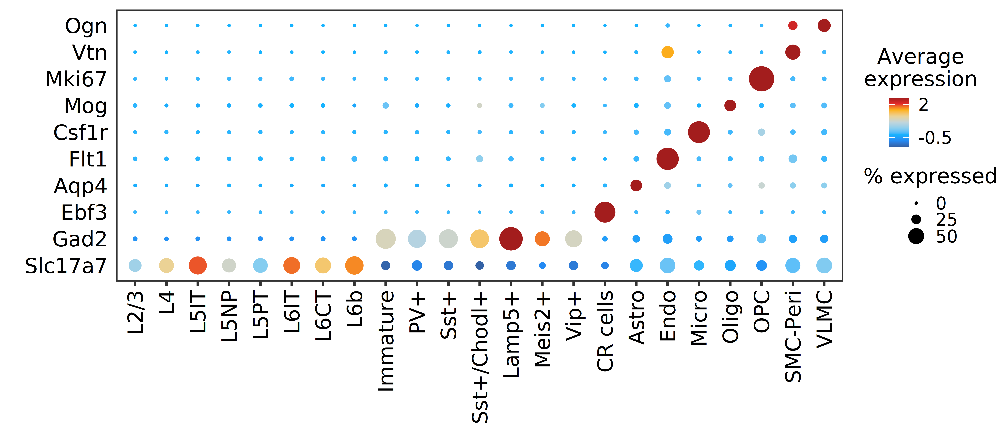

In [61]:
# Generate dot plot of all cell types
options(repr.plot.width=8, repr.plot.height=3.5, repr.plot.res=900)

DefaultAssay(final_obj) <- 'RNA'
final_obj$subtype_plotting <- gsub('Pvalb+','PV',final_obj$subtype)

final_obj$subtype_plotting <- factor(final_obj$subtype_plotting, levels = c('L2/3',
                                                          'L4',
                                                          'L5IT',
                                                          'L5NP',
                                                          'L5PT',
                                                          'L6IT',
                                                          'L6CT',
                                                          'L6b',
                                                          'Immature',
                                                          'PV+',
                                                          'Sst+',
                                                          'Sst+/Chodl+',
                                                          'Lamp5+',
                                                          'Meis2+',
                                                          'Vip+',
                                                          'CR cells',
                                                          'Astro',
                                                          'Endo',
                                                          'Micro',
                                                          'Oligo',
                                                          'OPC',
                                                          'SMC-Peri',
                                                          'VLMC'
                                                          ))



Idents(final_obj) <- final_obj$subtype_plotting
DotPlot(final_obj,
        features = c(
                     'Slc17a7',
                     'Gad2',
                     'Ebf3',
                     'Aqp4',
                     'Flt1',
                     'Csf1r',
                     'Mog',
                     'Mki67',
                     'Vtn',
                     'Ogn')) + 
theme_bw()+
theme(legend.position = 'right',
      legend.key.height = unit(0.2, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      axis.ticks.y = element_blank(),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(0,0,0,5),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(0, 25, 50), range = c(0.1, 6),labels = c(0, 25, 50)) + 
scale_color_gradientn(colors = ArchRPalettes$solarExtra, breaks = c(-0.5,2),labels = c(-0.5,2)) +
guides(color=guide_colourbar("Average\nexpression",
                             title.position = "top",
                             title.hjust = 0.5,
                             order=1),
       size=guide_legend("% expressed",
                         title.position = "top",
                         order=2)) + coord_flip()

Scale for size is already present.
Adding another scale for size, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


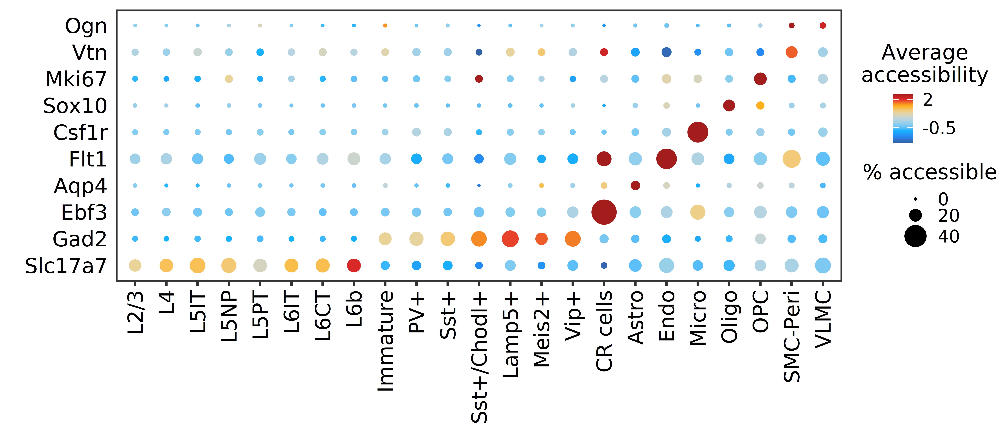

In [63]:
# Generate dot plot of all cell types
options(repr.plot.width=8, repr.plot.height=3.5, repr.plot.res=900)

final_obj$subtype_plotting <- factor(final_obj$subtype_plotting, levels = c('L2/3',
                                                          'L4',
                                                          'L5IT',
                                                          'L5NP',
                                                          'L5PT',
                                                          'L6IT',
                                                          'L6CT',
                                                          'L6b',
                                                          'Immature',
                                                          'PV+',
                                                          'Sst+',
                                                          'Sst+/Chodl+',
                                                          'Lamp5+',
                                                          'Meis2+',
                                                          'Vip+',
                                                          'CR cells',
                                                          'Astro',
                                                          'Endo',
                                                          'Micro',
                                                          'Oligo',
                                                          'OPC',
                                                          'SMC-Peri',
                                                          'VLMC'
                                                          ))
Idents(final_obj) <- final_obj$subtype_plotting
DotPlot(final_obj,
        assay = 'gene_activity',
        features = c('Slc17a7',
                     'Gad2',
                     'Ebf3',
                     'Aqp4',
                     'Flt1',
                     'Csf1r',
                     'Sox10',
                     'Mki67',
                     'Vtn',
                     'Ogn')) + 
theme_bw()+
theme(legend.position = 'right',
      axis.ticks.y = element_blank(),
      legend.key.height = unit(0.2, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(0,0,0,5),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(0,20, 40), range = c(0.1, 6),labels = c(0,20, 40)) + 
scale_color_gradientn(colors = ArchRPalettes$solarExtra, breaks = c(-0.5,2),labels = c(-0.5,2)) +
guides(color=guide_colourbar("Average\naccessibility", 
                             title.position = "top", 
                             title.hjust = 0.5,
                             order = 1),
       size=guide_legend("% accessible", 
                         title.position = "top"))  + coord_flip()

In [ ]:
# Generate dot plot of excitatory neurons
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

final_obj_ex$subtype <- factor(final_obj_ex$subtype, levels = c("L2/3", "L4", "L5IT", "L5NP", "L5PT", "L6IT", "L6CT", "L6b"))
Idents(final_obj_ex) <- final_obj_ex$subtype
DotPlot(final_obj_ex,
        assay='RNA',
        features = c('Ccbe1','Whrn','Deptor','Tshz2','Reln','Cdh9','Syt6','Svil')) + 
theme_bw()+
theme(legend.position = 'bottom',
      legend.key.height = unit(0.4, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      axis.ticks.y = element_blank(),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(-15,0,0,-20),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(0,25, 50, 75), range = c(0.1, 7),labels = c(0,25, 50, 75)) + scale_color_gradientn(colors = ArchRPalettes$solarExtra, breaks = c(-0.5,2),labels = c(-0.5,2)) +                                                                                                                                                     
guides(color=guide_colourbar("Average\nexpression", title.position = "top", title.hjust = 0.5,order=1),
       size=guide_legend("% expressed", title.position = "top",order=2))

In [ ]:
# Generate dot plot of excitatory neurons
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

Idents(final_obj_ex) <- final_obj_ex$subtype
DotPlot(final_obj_ex,
        assay='gene_activity',
        features = c('Ccbe1','Whrn','Deptor','Tshz2','Reln','Cdh9','Syt6','Svil')) + 
theme_bw()+
theme(legend.position = 'bottom',
      legend.key.height = unit(0.4, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      axis.ticks.y = element_blank(),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(-15,0,0,-20),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(20, 40, 60), range = c(0.1, 7),labels = c(20, 40, 60)) + 
scale_color_gradientn(colors = ArchRPalettes$solarExtra, limits = c(-1.5,2.45),breaks = c(-1,2),labels = c(-2,2)) +                                                                                                                                                   
guides(color=guide_colourbar("Average\naccessibility", title.position = "top", title.hjust = 0.5,order=1),
       size=guide_legend("% accessible", title.position = "top",order=2))

In [ ]:
final_obj_in$subtype <- gsub('Sst\\+/Chodl\\+', 'Sst+/\nChodl+', final_obj_in$subtype)

In [ ]:
# Generate dot plot of inhibitory neurons
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

Idents(final_obj_in) <- final_obj_in$subtype
DotPlot(final_obj_in,
        assay='RNA',
        features = c('Tubb2b','Pvalb','Sst','Chodl','Lamp5','Igfbpl1','Vip','Ebf3')) + 
theme_bw()+
theme(legend.position = 'bottom',
      legend.key.height = unit(0.4, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      axis.ticks.y = element_blank(),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(-15,0,0,-20),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(0,25, 50, 75), range = c(0.1, 7),labels = c(0,25, 50, 75)) + scale_color_gradientn(colors = ArchRPalettes$solarExtra, breaks = c(-0.5,2),labels = c(-0.5,2)) +                                                                                                                                                     
guides(color=guide_colourbar("Average\nexpression", title.position = "top", title.hjust = 0.5),
       size=guide_legend("% expressed", title.position = "top"))

In [ ]:
# Generate dot plot of inhibitory neurons
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

Idents(final_obj) <- final_obj$subtype
DotPlot(final_obj_in,
        assay='gene_activity',
        features = c('Tubb2b','Pvalb','Sst','Chodl','Lamp5','Igfbpl1','Vip','Ebf3')) + 
theme_bw()+
theme(legend.position = 'bottom',
      legend.key.height = unit(0.4, 'cm'),
      legend.key.width = unit(0.4, 'cm'),
      axis.ticks.y = element_blank(),
      legend.title.align=0.5,
      legend.title = element_text(size=12),
      legend.text = element_text(size=10),
      legend.box.margin=margin(-15,0,0,-20),
      legend.margin=margin(0,0,0,0),
      axis.text.y = element_text(size=12,color='black'),
      panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
      axis.text.x = element_text(angle=90,hjust=1,vjust=0.5,size=12,face='italic',color='black')) + xlab("") + ylab("") + 
scale_radius(breaks = c(0,25, 50, 75), range = c(0.1, 7),labels = c(0,25, 50, 75)) + scale_color_gradientn(colors = ArchRPalettes$solarExtra, breaks = c(-0.5,2),labels = c(-0.5,2)) +                                                                                                                                                     
guides(color=guide_colourbar("Average\naccessibility", title.position = "top", title.hjust = 0.5),
       size=guide_legend("% accessible", title.position = "top"))

# Call peaks and count fragments in peaks

In [ ]:
# Read in object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

In [ ]:
# Peak-calling on entire dataset 
library(future)
plan("multicore", workers = 20)
DefaultAssay(final_obj) <- 'ATAC'
peaks <- CallPeaks(
  object = final_obj,
  macs2.path = "/n/groups/neuroduo/Bruno/venv/bin/macs2"
)

In [ ]:
# Save peaks called on entire dataset
saveRDS(peaks, '/n/groups/neuroduo/Bruno/RDS_files/230725_NR_DR_V1_all_cells_peaks.rds')

In [ ]:
# Read peaks called on entire dataset
peaks <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230725_NR_DR_V1_all_cells_peaks.rds')

In [ ]:
# Run FeatureCounts on peaks
library(future)
plan("multisession", workers = 20)
DefaultAssay(final_obj) <- 'ATAC'
start.time <- Sys.time()
df <- FeatureMatrix(Fragments(final_obj),
                    features = peaks,
                    cells = colnames(final_obj),
                    process_n = 20000)
end.time <- Sys.time()
time.taken <- end.time - start.time
time.taken

In [ ]:
# Save feature matrix
saveRDS(df, '/n/groups/neuroduo/Bruno/RDS_files/230725_V1_all_cells_peaks_feature_matrix.rds')

In [15]:
# Read feature matrix
feature_matrix <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230725_V1_all_cells_peaks_feature_matrix.rds')

In [ ]:
# Create genome annotation file 
annotation <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotation),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotation) <- ucsc.levels
genome(annotation) <- "mm10"

In [ ]:
# Generate chromatin assay
DefaultAssay(final_obj) <- 'ATAC'
chromatin_assay <- CreateChromatinAssay(counts = feature_matrix,
                                        fragments = Fragments(final_obj),
                                        genome = 'mm10',
                                        annotation = annotation)

In [ ]:
# Add chromatin assay object to Seurat object
final_obj[['peaks']] <- chromatin_assay

In [ ]:
# Save RDS object after adding peakset to object
saveRDS(final_obj, '/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

# Generate RNA & ATAC QC plots

In [17]:
# Read RDS object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

In [18]:
# Add replicate info as metadata column
final_obj$Replicatev2 <- ifelse(grepl('1a|1b', final_obj$orig.ident) & final_obj$Sex == 'F', '1',
                              ifelse(grepl('1a|1b', final_obj$orig.ident) & final_obj$Sex == 'M', '2',
                                     ifelse(final_obj$Sex == 'F','3','4')))

Warning message:
"The `slot` argument of `FetchData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>."
Warning message:
"`PackageCheck()` was deprecated in SeuratObject 5.0.0.
ℹ Please use `rlang::check_installed()` instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>."


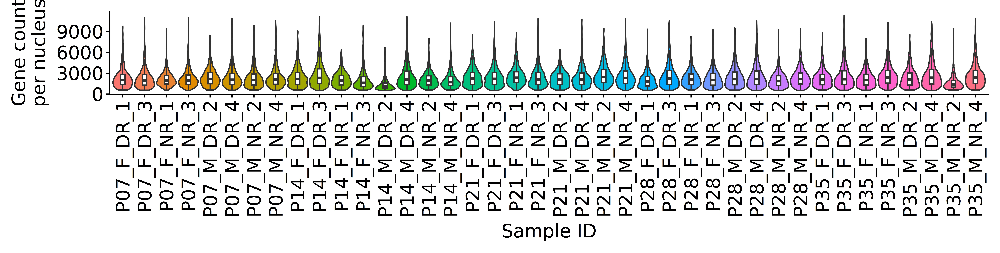

In [19]:
# Generat violin plot of RNA gene count per nucleus
options(repr.plot.width=15, repr.plot.height=3.8,repr.plot.res=900) 
final_obj$Replicatev2_sex <- paste0(final_obj$Sex, '_', final_obj$Replicatev2)
final_obj$Replicatev2_sex <- factor(final_obj$Replicatev2_sex, levels = c('F_1','M_2','F_3','M_4'))
final_obj$Replicatev2_sex_treatment_timepoint <- paste0(final_obj$Timepoint,'_',final_obj$Sex, '_', final_obj$Treatment, '_', final_obj$Replicatev2)


VlnPlot(final_obj,features='nFeature_RNA',group.by = 'Replicatev2_sex_treatment_timepoint',pt.size=0) + geom_boxplot(width=0.2, fill="white",outliers=FALSE) + 
theme(legend.position='none',plot.title=element_blank(),axis.text=element_text(size=20),
      axis.text.x=element_text(angle=90,vjust=0.5),
      axis.title=element_text(size=20),
     axis.title.y=element_text(margin=margin(0,8,0,0)),
     axis.title.x=element_text(margin=margin(7,0,0,0))) + 
xlab('Sample ID') + 
ylab('Gene count\nper nucleus') #+ scale_fill_manual(values = as.vector(ArchRPalettes$calm[1:8]))

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


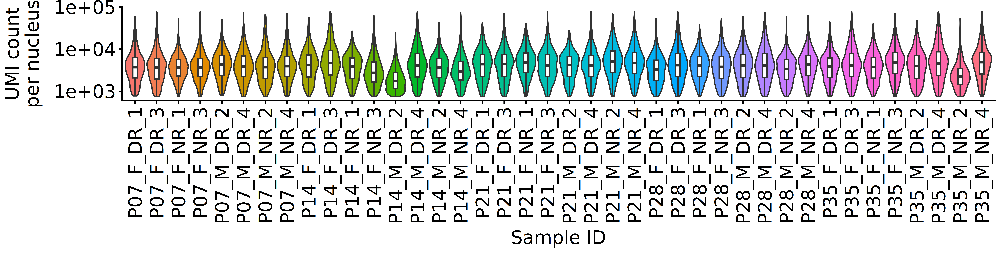

In [20]:
# Generat violin plot of RNA transcript count per nucleus
options(repr.plot.width=15, repr.plot.height=3.8,repr.plot.res=900) 
final_obj$Replicatev2_sex <- paste0(final_obj$Sex, '_', final_obj$Replicatev2)
final_obj$Replicatev2_sex <- factor(final_obj$Replicatev2_sex, levels = c('F_1','M_2','F_3','M_4'))
final_obj$Replicatev2_sex_treatment_timepoint <- paste0(final_obj$Timepoint,'_',final_obj$Sex, '_', final_obj$Treatment, '_', final_obj$Replicatev2)


VlnPlot(final_obj,features='nCount_RNA',group.by = 'Replicatev2_sex_treatment_timepoint',pt.size=0) + geom_boxplot(width=0.2, fill="white",outliers=FALSE) + 
theme(legend.position='none',plot.title=element_blank(),axis.text=element_text(size=20),
      axis.text.x=element_text(angle=90,vjust=0.5),
      axis.title=element_text(size=20),
      plot.margin=margin(2,0,0,0),
     axis.title.y=element_text(margin=margin(0,12,0,0)),
     axis.title.x=element_text(margin=margin(7,0,0,0))) + 
xlab('Sample ID') + 
ylab('UMI count\nper nucleus') + scale_y_log10() 

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


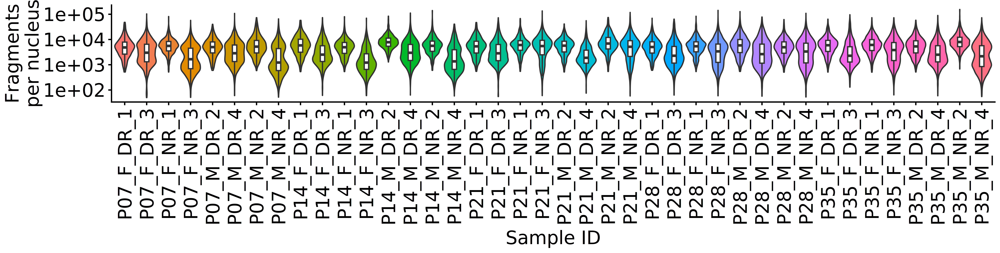

In [7]:
# Generat violin plot of ATAC fragment count per nucleus
options(repr.plot.width=15, repr.plot.height=3.8,repr.plot.res=900) 
final_obj$Replicatev2_sex <- paste0(final_obj$Sex, '_', final_obj$Replicatev2)
final_obj$Replicatev2_sex <- factor(final_obj$Replicatev2_sex, levels = c('F_1','M_2','F_3','M_4'))
final_obj$Replicatev2_sex_treatment_timepoint <- paste0(final_obj$Timepoint,'_',final_obj$Sex, '_', final_obj$Treatment, '_', final_obj$Replicatev2)

VlnPlot(final_obj,features='nCount_ATAC',group.by = 'Replicatev2_sex_treatment_timepoint',pt.size=0) + geom_boxplot(width=0.2, fill="white",outliers=FALSE) + 
theme(legend.position='none',plot.title=element_blank(),axis.text=element_text(size=20),
      axis.text.x=element_text(angle=90,vjust=0.5),
      axis.title=element_text(size=20),
      plot.margin=margin(0,0,0,0),
     axis.title.y=element_text(margin=margin(0,12,0,0)),
     axis.title.x=element_text(margin=margin(7,0,0,0))) + 
xlab('Sample ID') + 
ylab('Fragments\nper nucleus') + scale_y_log10() 

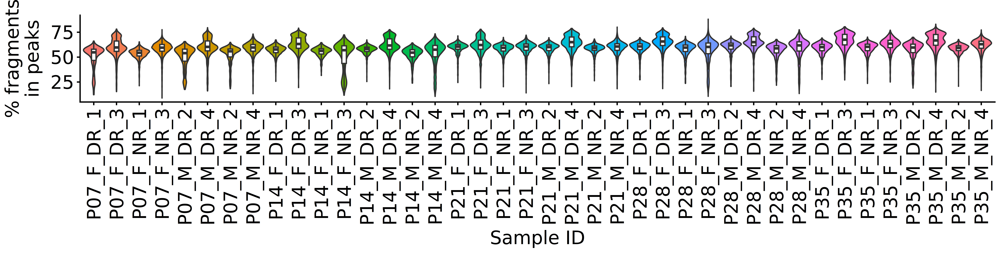

In [8]:
# Generat violin plot of percentage of ATAC fragments in peaks per nucleus
options(repr.plot.width=15, repr.plot.height=3.8,repr.plot.res=900) 
final_obj$Replicatev2_sex <- paste0(final_obj$Sex, '_', final_obj$Replicatev2)
final_obj$Replicatev2_sex <- factor(final_obj$Replicatev2_sex, levels = c('F_1','M_2','F_3','M_4'))
final_obj$Replicatev2_sex_treatment_timepoint <- paste0(final_obj$Timepoint,'_',final_obj$Sex, '_', final_obj$Treatment, '_', final_obj$Replicatev2)

final_obj$FRIP <- (final_obj$nCount_peaks / final_obj$nCount_ATAC) * 100

VlnPlot(final_obj,features='FRIP',group.by = 'Replicatev2_sex_treatment_timepoint',pt.size=0) + geom_boxplot(width=0.2, fill="white",outliers=FALSE) + 
theme(legend.position='none',plot.title=element_blank(),axis.text=element_text(size=20),
      axis.text.x=element_text(angle=90,vjust=0.5),
      axis.title=element_text(size=20),
       plot.margin=margin(11,0,0,0),
     axis.title.y=element_text(margin=margin(0,12,0,0)),
     axis.title.x=element_text(margin=margin(7,0,0,0))) + 
xlab('Sample ID') + 
ylab('% fragments\nin peaks')

# Generate ViolinPlot of GR expression across cortical cell types

In [ ]:
# Read RDS object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

In [27]:
BICCN_metadata <- fread('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/metadata.csv',nThread = 10)
col_df <- data.frame(subtype = unique(BICCN_metadata$subclass_label),
          color = unique(BICCN_metadata$subclass_color))
col_df_filt <- col_df[col_df$subtype %in% c('L2/3 IT CTX',
                             'L4/5 IT CTX',
                             'L5 IT CTX',
                             'L5/6 NP CTX',
                             'L5 PT CTX',
                             'L6 IT CTX',
                             'L6 CT CTX',
                             'L6b CTX',
                             'Pvalb',
                             'Sst',
                             'Sst Chodl',
                             'Lamp5',
                             'Meis2',
                             'Vip',
                             'CR',
                             'Astro',
                             'Endo',
                             'Micro-PVM',
                             'Oligo',
                             'SMC-Peri',
                             'VLMC'),]

col_df_filt$subtype <- c('Pvalb+',
                         'Lamp5+',
                         'Vip+',
                         'Sst+',
                         'L4',
                         'Meis2+',
                         'L5NP',
                         'L5PT',
                         'Sst+/Chodl+',
                         'L2/3',
                         'L5IT',
                         'L6IT',
                         'L6CT',
                         'L6b',
                         'Oligo',
                         'CR cells',
                         'Astro',
                         'SMC-Peri',
                         'Micro',
                         'Endo',
                         'VLMC')
df <- data.frame(subtype  = c('Immature','OPC'),
           color = c('#F8766D','#675c00'))
col_df_filt <- rbind(col_df_filt, df)
col_df_filt[col_df_filt$subtype == 'CR cells','color'] <- '#ba6190'
col_df_filt[col_df_filt$subtype == 'Meis2+','color'] <- '#e07a00'

In [28]:
col_df_filt <- col_df_filt[match(c('Astro',
                                         'Oligo',
                                         'OPC',
                                         'SMC-Peri',
                                         'VLMC',
                                         'Endo',
                                         'Micro',
                                         'Pvalb+',
                                         'Sst+',
                                         'Sst+/Chodl+',
                                         'Vip+',
                                         'Immature',
                                         'Meis2+',
                                         'Lamp5+',
                                         'CR cells',
                                         'L2/3',
                                         'L4',
                                         'L5IT', 
                                         'L5PT',
                                         'L5NP',
                                          'L6IT',
                                         'L6CT',
                                         'L6b'),col_df_filt$subtype),]

In [29]:
# Set factor level
final_obj$subtype2 <- factor(final_obj$subtype, levels = col_df_filt$subtype)

Warning message:
"Groups with fewer than two datapoints have been dropped.
ℹ Set `drop = FALSE` to consider such groups for position adjustment purposes."


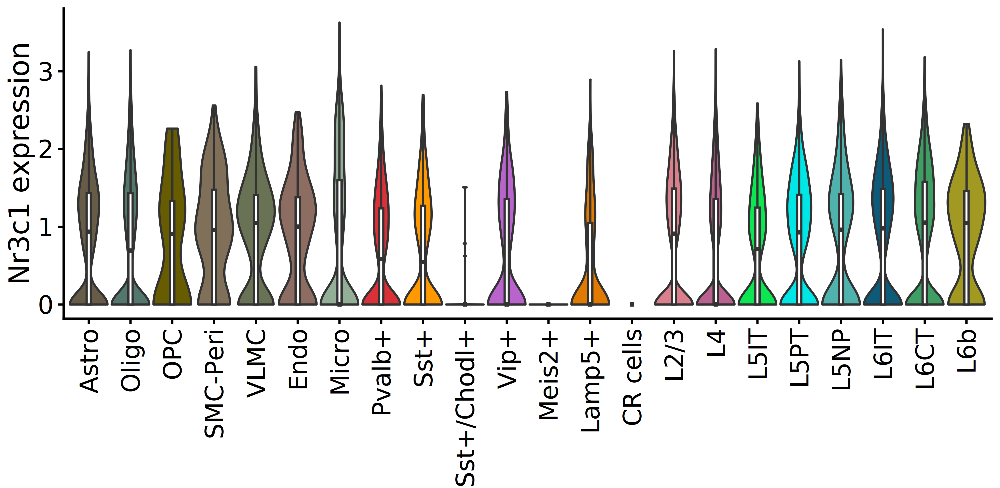

In [59]:
# Generate the plot
options(repr.plot.width=9, repr.plot.height=4.4, repr.plot.res=500)
final_obj_P35 <- subset(final_obj, subset = Timepoint == 'P35')
VlnPlot(final_obj_P35, assay='RNA',features = 'Nr3c1', group.by = 'subtype2',pt.size=0) + 
geom_boxplot(width=0.1,fill="white",outlier.size=0) + 
theme(legend.position='none', plot.title=element_blank(), axis.title.x=element_blank(),
     axis.text=element_text(size=16),
      plot.margin=margin(0,0,10,0),
      axis.text.x=element_text(angle=90,hjust=1,vjust=0.5),
      axis.title.y=element_text(size=18))+ 
ylab('Nr3c1 expression') + 
scale_fill_manual(values = col_df_filt$color)

# Perform pseudo-bulk DE analysis between NR and DR within each cluster & timepoint

In [ ]:
# Read RDS object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

In [5]:
# Add replicate info as metadata column
final_obj$Replicatev2 <- ifelse(grepl('1a|1b', final_obj$orig.ident) & final_obj$Sex == 'F', '1',
                              ifelse(grepl('1a|1b', final_obj$orig.ident) & final_obj$Sex == 'M', '2',
                                     ifelse(final_obj$Sex == 'F','3','4')))

final_obj$Treatment_replicatev2 <- paste0(final_obj$Treatment, '_', final_obj$Replicatev2)

# Combine cell-type and timepoint info into single metadata column (if not already present)
final_obj$Celltype_timepoint <- paste0(final_obj$subtype, '_', final_obj$Timepoint)

In [6]:
# Convert Seurat to SingleCellExperiment object
final_obj_RNA <- CreateSeuratObject(final_obj[['RNA']])
final_obj_RNA <- AddMetaData(final_obj_RNA, final_obj@meta.data)           
final_obj_sce <- as.SingleCellExperiment(final_obj_RNA)

In [7]:
# Split sce object into list of objects for each cluster & timepoint
sce_list <- list()
for (i in unique(colData(final_obj_sce)$Celltype_timepoint)){
  try({
      sce_list[[i]] <- final_obj_sce[,colData(final_obj_sce)$Celltype_timepoint == i]
  })
}

In [8]:
# Drop out comparisons with extreme group imbalance (4-fold difference) or low cell numbers (<15)
row_lt1 <- which(sapply(sce_list, function(x) {sum(table(colData(x)$Treatment) < 15)}) > 0)

row_lt2 <- which(sapply(sce_list, function(x) { table(colData(x)$Treatment)[2] /
                                                table(colData(x)$Treatment)[1] }) > 4 | 
                 sapply(sce_list, function(x) { table(colData(x)$Treatment)[2] /
                                                table(colData(x)$Treatment)[1] }) < 0.25)
sce_list_filt <- sce_list[-c(row_lt1,row_lt2)]

In [9]:
# Aggregate counts across cells per treatment+replicate ('pseudo-bulk SUM') for each cluster-timepoint pairing
bulk_matrix_listv2 <- mclapply(sce_list_filt, function(x) {
                                                    df <- aggregate(t(counts(x)),
                                                                    list(colData(x)$Treatment_replicatev2),
                                                                    FUN=sum)
                                                    }, mc.cores = 10)

In [10]:
# Convert pseudo-bulk matrix to dataframe
bulk_df_listv2 <- mclapply(bulk_matrix_listv2, function(x) {
                                                        x_df <- as.data.frame(t(x))
                                                        x_df[] <- lapply(x_df, as.numeric);
                                                        x_df
                                                    }, mc.cores = 10)

In [11]:
# Filter out cluster-timepoint pairings without all bio reps
bulk_df_listv2_subset <- bulk_df_listv2[lengths(bulk_df_listv2) == 8]

In [12]:
# Create metadata dataframe for each cluster-timepoint pairing
metadata_listv2 <- mclapply(bulk_df_listv2_subset, function(x) {
                          metadata_df <- data.frame(Sample = colnames(bulk_df_listv2_subset[[1]]),
                          Treatment = c('DR','DR','DR','DR','NR','NR','NR','NR'),
                          Replicate = c('1','2','3','4','1','2','3','4'))
                                                }, mc.cores = 10)
metadata_listv2 <- mclapply(metadata_listv2, function(x) {rownames(x) <- x$Sample; x
                                                }, mc.cores = 10)
names(metadata_listv2) <- names(bulk_df_listv2_subset)

In [13]:
# Create edgeR object
edgeR_obj_listv2 <- list()
for (i in names(bulk_df_listv2_subset)){
  try({
      edgeR_obj_listv2[[i]] <- DGEList(counts = bulk_df_listv2_subset[[i]], samples = metadata_listv2[[i]])
  })
}
names(edgeR_obj_listv2) <- names(bulk_df_listv2_subset)

In [14]:
# Filter objects by counts
edgeR_obj_listv2_filt <- list()
for (i in names(edgeR_obj_listv2)){
  try({
      threshold <- mean(colSums(edgeR_obj_listv2[[i]]$counts)) * 0.00001
      edgeR_obj_listv2_filt[[i]] <- edgeR_obj_listv2[[i]][rowSums(edgeR_obj_listv2[[i]]$counts>=threshold) >= 2, , keep.lib.sizes=FALSE]
  })
}
names(edgeR_obj_listv2_filt) <- names(edgeR_obj_listv2)

In [15]:
# Normalize sample
edgeR_obj_listv2_filt_norm <- list()
for (i in names(edgeR_obj_listv2_filt)){
  try({
      edgeR_obj_listv2_filt_norm[[i]] <- calcNormFactors(edgeR_obj_listv2_filt[[i]])
  })
}
names(edgeR_obj_listv2_filt_norm) <- names(edgeR_obj_listv2_filt)

In [16]:
# Create design
designv2 <- model.matrix(~ Treatment, data = edgeR_obj_listv2_filt_norm[[1]]$samples)

In [17]:
# Estimate dispersions
edgeR_obj_listv2_filt_norm_disp <- list()
for (i in names(edgeR_obj_listv2_filt_norm)){
  try({
      edgeR_obj_listv2_filt_norm_disp[[i]] <- estimateDisp(edgeR_obj_listv2_filt_norm[[i]], designv2)
  })
}
names(edgeR_obj_listv2_filt_norm_disp) <- names(edgeR_obj_listv2_filt_norm)

In [18]:
# Run QLFit
fit_listv2 <- list()
for (i in names(edgeR_obj_listv2_filt_norm_disp)){
  try({
      fit_listv2[[i]] <- glmQLFit(edgeR_obj_listv2_filt_norm_disp[[i]], designv2)
  })
}
names(fit_listv2) <- names(edgeR_obj_listv2_filt_norm_disp)

In [19]:
# Run QLFTest & extract results
qlf_listv2 <- list()
for (i in names(edgeR_obj_listv2_filt_norm_disp)){
  try({
      qlf_listv2[[i]] <- glmQLFTest(fit_listv2[[i]], coef=2)
  })
}
names(qlf_listv2) <- names(edgeR_obj_listv2_filt_norm_disp)

res_listv2_edger <- list()
for (i in names(qlf_listv2)){
  try({
      res_listv2_edger[[i]] <- as.data.frame(topTags(qlf_listv2[[i]], n=Inf))
  })
}
names(res_listv2_edger) <- names(qlf_listv2)

In [21]:
# Save edgeR results
saveRDS(res_listv2_edger, '250508_res_listv3_edger.rds')

In [12]:
# Export data to individual csv files for supplementary table 1
names(res_listv2_edger) <- gsub('L2/3', 'L23', names(res_listv2_edger),fixed=F) # Replace dash to avoid file save issue
names(res_listv2_edger) <- gsub('Sst\\+/Chodl+', 'Sst+Chodl+', names(res_listv2_edger),fixed=F) # Replace dash to avoid file save issue

for (i in names(res_listv2_edger)){
  try({
      res_listv2_edger[[i]]$gene <- rownames(res_listv2_edger[[i]])
      res_listv2_edger[[i]] <- res_listv2_edger[[i]][,c(6,1,2,3,4,5)]
      write.table(data.frame(res_listv2_edger[[i]][order(res_listv2_edger[[i]]$PValue),]),
            paste0('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/DEG_output/',i,'.csv'),
            quote = FALSE,
            col.names=TRUE,
            row.names=FALSE,
            sep = ',')
      
  })
}

In [85]:
# Write DEGs for cluster and timepoint of interest to file for BETA analysis with GR sites
cti <- 'Astro_P07'
write.table(data.frame(res_listv2_edger[[cti]][order(res_listv2_edger[[cti]]$FDR),c(1,5)]),
            paste0('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/', gsub('/', '_', cti), '_DEGs.xls'),
            quote = FALSE,
            col.names=FALSE,
            sep = '\t')

cti <- 'Astro_P14'
write.table(data.frame(res_listv2_edger[[cti]][order(res_listv2_edger[[cti]]$FDR),c(1,5)]),
            paste0('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/', gsub('/', '_', cti), '_DEGs.xls'),
            quote = FALSE,
            col.names=FALSE,
            sep = '\t')

cti <- 'Astro_P21'
write.table(data.frame(res_listv2_edger[[cti]][order(res_listv2_edger[[cti]]$FDR),c(1,5)]),
            paste0('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/', gsub('/', '_', cti), '_DEGs.xls'),
            quote = FALSE,
            col.names=FALSE,
            sep = '\t')

cti <- 'Astro_P28'
write.table(data.frame(res_listv2_edger[[cti]][order(res_listv2_edger[[cti]]$FDR),c(1,5)]),
            paste0('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/', gsub('/', '_', cti), '_DEGs.xls'),
            quote = FALSE,
            col.names=FALSE,
            sep = '\t')

cti <- 'Astro_P35'
write.table(data.frame(res_listv2_edger[[cti]][order(res_listv2_edger[[cti]]$FDR),c(1,5)]),
            paste0('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/', gsub('/', '_', cti), '_DEGs.xls'),
            quote = FALSE,
            col.names=FALSE,
            sep = '\t')

# Visualize DEG numbers for each cell type on lineplot for Figure 1

In [158]:
res_list_edger_RNA <- readRDS('250508_res_listv3_edger.rds')

In [159]:
# Collect number of up-regulated and down-regulated genes per celltype-timepoint pairing
up_gene_list <- mclapply(res_list_edger_RNA, function(x) { y <- x[complete.cases(x),]
                                                dim(y[(y$FDR < 0.05) &
                                                               (y$logFC > 0),])[1]
                                                    }, mc.cores = 10)
names(up_gene_list) <- names(res_list_edger_RNA)
down_gene_list <- mclapply(res_list_edger_RNA, function(x) { y <- x[complete.cases(x),]
                                                    dim(y[(y$FDR < 0.05) &
                                                               (y$logFC < 0),])[1]
                                                    }, mc.cores = 10)
names(down_gene_list) <- names(res_list_edger_RNA)

In [160]:
# Convert lists to dataframes
up_gene_df <- as.data.frame(unlist(up_gene_list))
names(up_gene_df) <- 'Gene_count'
down_gene_df <- as.data.frame(unlist(down_gene_list))
names(down_gene_df) <- 'Gene_count'

In [161]:
# Split rownames into cell-type and treatment columns, then cast the dataframe
down_gene_df$Celltype <- do.call(rbind, strsplit(rownames(down_gene_df), '_'))[,1]
down_gene_df$Timepoint <- do.call(rbind, strsplit(rownames(down_gene_df), '_'))[,2]

up_gene_df$Celltype <- do.call(rbind, strsplit(rownames(up_gene_df), '_'))[,1]
up_gene_df$Timepoint <- do.call(rbind, strsplit(rownames(up_gene_df), '_'))[,2]

down_gene_df_dcast <- as.data.frame(dcast(setDT(down_gene_df), Celltype~Timepoint, value.var = 'Gene_count'))
up_gene_df_dcast <- as.data.frame(dcast(setDT(up_gene_df), Celltype~Timepoint, value.var = 'Gene_count'))

In [162]:
# Set NA values to 0
up_gene_df_dcast[is.na(up_gene_df_dcast)] <- 0
down_gene_df_dcast[is.na(down_gene_df_dcast)] <- 0

In [163]:
# Set row names
rownames(up_gene_df_dcast) <- up_gene_df_dcast[,1]
up_gene_df_dcast <- up_gene_df_dcast[,-1]

rownames(down_gene_df_dcast) <- down_gene_df_dcast[,1]
down_gene_df_dcast <- down_gene_df_dcast[,-1]

In [164]:
sum_gene_df_dcast <- up_gene_df_dcast + down_gene_df_dcast
names(sum_gene_df_dcast)[1] <- 'P7'

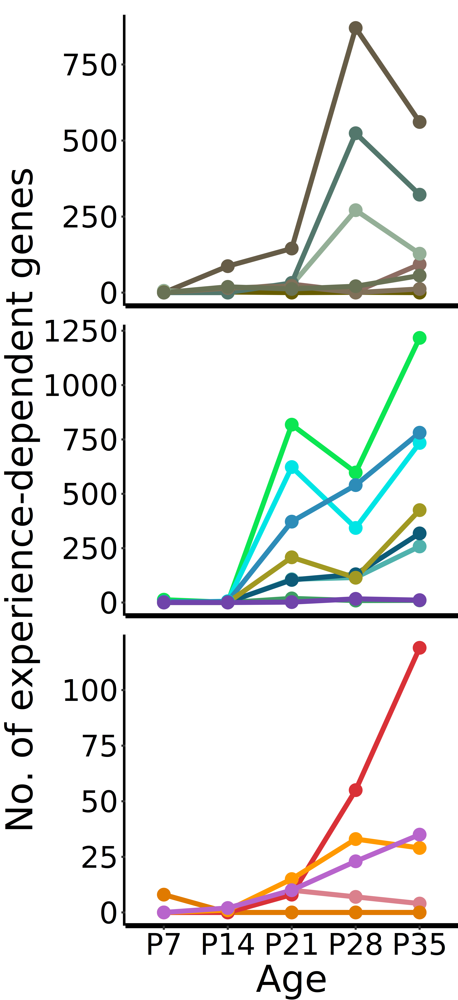

In [170]:
# Generate plot for excitatory neurons
options(repr.plot.width = 4.3 , repr.plot.height = 9.375,repr.plot.res=900)
 
sum_gene_df_dcast_ex <- sum_gene_df_dcast[row.names(sum_gene_df_dcast) %in% c('L2/3',
                                                                           'L4',
                                                                           'L5IT',
                                                                           'L5NP',
                                                                           'L5PT',
                                                                           'L6b',
                                                                           'L6CT',
                                                                           'L6IT'),]

sum_gene_df_dcast_in <- sum_gene_df_dcast[row.names(sum_gene_df_dcast) %in% c('CR cells',
                                                                           'Vip+',
                                                                           'Meis2+',
                                                                           'Lamp5+',
                                                                           'Sst+/Chodl+',
                                                                           'Sst+',
                                                                           'Pvalb+',
                                                                           'Immature'),]

sum_gene_df_dcast_non <- sum_gene_df_dcast[row.names(sum_gene_df_dcast) %in% c('Astro',
                                                                            'Endo',
                                                                            'Micro',
                                                                            'Oligo',
                                                                            'OPC',
                                                                            'SMC-Peri',
                                                                            'VLMC'),]

p1 <- ggplot(data=reshape2::melt(as.matrix(sum_gene_df_dcast_non)), aes(x=Var2, y=value, group=Var1)) +
  geom_line(aes(color=Var1),size = 1.2)+
  geom_point(shape=16,aes(color=Var1),size = 4) + theme_classic() +
theme(legend.position = 'none',
      axis.text.y = element_text(size=20,color='black'),
      axis.text.x = element_blank(),
      axis.title.x = element_blank(),
      axis.title.y = element_blank(),
      axis.ticks.x = element_blank(),
     plot.margin = margin(10, 0, 0, 10),
      axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2)) +
scale_color_manual(values = c('Astro' = col_df_filt[col_df_filt$subtype=='Astro','color'],
                              'Endo' = col_df_filt[col_df_filt$subtype=='Endo','color'],
                              'Micro' = col_df_filt[col_df_filt$subtype=='Micro','color'],
                              'Oligo' = col_df_filt[col_df_filt$subtype=='Oligo','color'],
                              'OPC' = col_df_filt[col_df_filt$subtype=='OPC','color'],
                              'SMC-Peri' = col_df_filt[col_df_filt$subtype=='SMC-Peri','color'],
                              'VLMC' = col_df_filt[col_df_filt$subtype=='VLMC','color'])) +
guides(color=guide_legend("Cell type", title.position = "top"))

p2 <- ggplot(data=reshape2::melt(as.matrix(sum_gene_df_dcast_ex)), aes(x=Var2, y=value, group=Var1)) +
  geom_line(aes(color=Var1),size = 1.2)+
  geom_point(shape=16,aes(color=Var1),size = 4) + theme_classic() +
theme(legend.position = 'none',
      axis.text.y = element_text(size=20,color='black'),
      axis.text.x = element_blank(),
      axis.title.x = element_blank(),
      axis.title.y = element_blank(),
      axis.ticks.x = element_blank(),
      axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2),
     plot.margin = margin(10, 0, 0, 10)) +
xlab('Age') + ylab('No. DEGs per cell type') +
scale_color_manual(values = c(  'L2/3' = col_df_filt[col_df_filt$subtype=='L2/3','color'],
                                'L4' = col_df_filt[col_df_filt$subtype=='L4','color'],
                                'L5IT' = col_df_filt[col_df_filt$subtype=='L5IT','color'],
                                'L5NP' = col_df_filt[col_df_filt$subtype=='L5NP','color'],
                                'L5PT' = col_df_filt[col_df_filt$subtype=='L5PT','color'],
                                'L6IT' = col_df_filt[col_df_filt$subtype=='L6IT','color'],
                                'L6CT' = col_df_filt[col_df_filt$subtype=='L6CT','color'],
                                'L6b' = col_df_filt[col_df_filt$subtype=='L6b','color'])) +
guides(color=guide_legend("Cell type", title.position = "top"))

p3 <- ggplot(data=reshape2::melt(as.matrix(sum_gene_df_dcast_in)), aes(x=Var2, y=value, group=Var1)) +
  geom_line(aes(color=Var1),size = 1.2)+
  geom_point(shape=16,aes(color=Var1),size=4) + theme_classic() +
theme(legend.position = 'none',
     axis.text = element_text(size=20,color='black'),
     axis.title.x = element_text(size=25),
     axis.title.y = element_blank(),
    axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2),
     plot.margin = margin(10, 0, 0, 10)) +
xlab('Age') +
scale_color_manual(values = c('Pvalb+' = col_df_filt[col_df_filt$subtype=='Pvalb+','color'],
                              'Lamp5+' = col_df_filt[col_df_filt$subtype=='Lamp5+','color'],
                              'Sst+' = col_df_filt[col_df_filt$subtype=='Sst+','color'],
                              'Vip+' = col_df_filt[col_df_filt$subtype=='Vip+','color'],
                              'Immature' = col_df_filt[col_df_filt$subtype=='Immature','color'],
                              'Meis2+' = col_df_filt[col_df_filt$subtype=='Meis2+','color'],
                              'CR cells' = col_df_filt[col_df_filt$subtype=='CR cells','color'],
                              'Sst+/Chodl+' = col_df_filt[col_df_filt$subtype=='Sst+/Chodl+','color'])) +
guides(color=guide_legend("Cell type", title.position = "top"))


grid.arrange(gtable_frame(ggarrange(p1, p2, p3, draw=F)),
             left = textGrob("No. of experience-dependent genes",rot=90,gp = gpar(fontsize=25)))

# Plot GR gene regulatory score for astrocyte experience-regulated genes for Fig. 2

In [12]:
# Read in DEGs
res_list_edger_RNA <- readRDS('250508_res_listv3_edger.rds')

In [13]:
# Average replicates prior to clustering
mean_rep_cpm <- data.frame(P07_DR = rowMeans(cpm(edgeR_obj)[,1:4]),
                           P07_NR = rowMeans(cpm(edgeR_obj)[,5:8]),
                           P14_DR = rowMeans(cpm(edgeR_obj)[,9:12]),
                           P14_NR = rowMeans(cpm(edgeR_obj)[,13:16]),
                           P21_DR = rowMeans(cpm(edgeR_obj)[,17:20]),
                           P21_NR = rowMeans(cpm(edgeR_obj)[,21:24]),
                           P28_DR = rowMeans(cpm(edgeR_obj)[,25:28]),
                           P28_NR = rowMeans(cpm(edgeR_obj)[,29:32]),
                           P35_DR = rowMeans(cpm(edgeR_obj)[,33:36]),
                           P35_NR = rowMeans(cpm(edgeR_obj)[,37:40]))

In [14]:
uniq_astro_DEG <- unique(c(rownames(res_list_edger_RNA[['Astro_P14']][res_list_edger_RNA[['Astro_P14']]$FDR<0.05,]),
                           rownames(res_list_edger_RNA[['Astro_P21']][res_list_edger_RNA[['Astro_P21']]$FDR<0.05,]),
                           rownames(res_list_edger_RNA[['Astro_P28']][res_list_edger_RNA[['Astro_P28']]$FDR<0.05,]),
                           rownames(res_list_edger_RNA[['Astro_P35']][res_list_edger_RNA[['Astro_P35']]$FDR<0.05,])))

In [15]:
names(mean_rep_cpm) <- gsub('_', ' ', names(mean_rep_cpm))

Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."


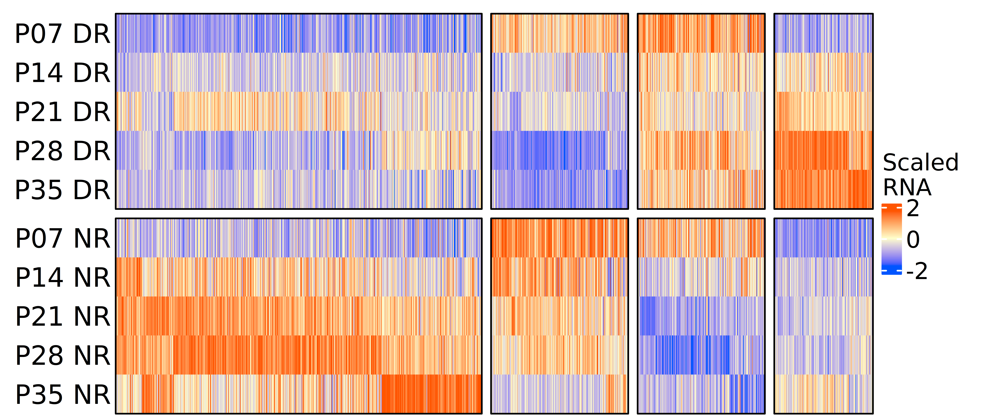

In [29]:
options(repr.plot.width = 8.4, repr.plot.height = 3.5,repr.plot.res=900)

# compute distance metric
dist_mat <- dist(t(scale(t(mean_rep_cpm[uniq_astro_DEG,]))), method = 'euclidean')
# run hclust
hclust_complete <- hclust(dist_mat, method = 'average')
# run cutree
cut_avg_wardD2 <- cutree(hclust_complete, k = 4)

col_fun = colorRamp2(c(-1.75, 0, 1.75), c("#0055FFFF", "#FFFFCCFF", "#FF5500FF"))

rowsplit <- data.frame(c(rep('1',table(cut_avg_wardD2)[[1]]),
                         rep('2',table(cut_avg_wardD2)[[2]]),
                         rep('3',table(cut_avg_wardD2)[[3]]),
                         rep('4',table(cut_avg_wardD2)[[4]])))

colsplit <- data.frame(c(rep('1',5),
                         rep('2',5)))

ht1 <- Heatmap(scale(t(mean_rep_cpm[names(cut_avg_wardD2[order(cut_avg_wardD2)]),]))[c(1,3,5,7,9,2,4,6,8,10),],
        cluster_rows = FALSE,
        cluster_columns=FALSE,
        show_row_names=TRUE,
        row_names_side = 'left',
        show_column_names=FALSE,
        row_names_gp = gpar(fontsize = 16),
        column_title_gp = gpar(fontsize = 0),
        row_title_gp = gpar(fontsize = 0),
        name = "Scaled\nRNA",
        row_split = colsplit,   
        row_gap = unit(2, "mm"), 
        column_gap = unit(2, "mm"),
        column_split = rowsplit, 
        heatmap_legend_param = list(legend_direction = "vertical", 
                                    legend_width = unit(1.3, "cm"),
                                    legend_height = unit(1, "cm"),
                                    labels = c('-2','0','2'),
                                     at = c(-2,0,2),
                                     labels_gp = gpar(fontsize = 14),
                                    title_gp = gpar(fontsize = 14),
                                    title_position = "topleft"),
        col = col_fun,
              border=TRUE)

draw(ht1, heatmap_legend_side = "right",padding = unit(c(0.5, 1, 1, 10), "mm"))


In [19]:
# Collect significant DEGs detected any time point into single dataframe
astro_P14_sig <- res_list_edger_RNA[['Astro_P14']][res_list_edger_RNA[['Astro_P14']]$FDR<0.05,]
astro_P14_sig$gene <- rownames(astro_P14_sig)

astro_P21_sig <- res_list_edger_RNA[['Astro_P21']][res_list_edger_RNA[['Astro_P21']]$FDR<0.05,]
astro_P21_sig$gene <- rownames(astro_P21_sig)

astro_P28_sig <- res_list_edger_RNA[['Astro_P28']][res_list_edger_RNA[['Astro_P28']]$FDR<0.05,]
astro_P28_sig$gene <- rownames(astro_P28_sig)

astro_P35_sig <- res_list_edger_RNA[['Astro_P35']][res_list_edger_RNA[['Astro_P35']]$FDR<0.05,]
astro_P35_sig$gene <- rownames(astro_P35_sig)

astro_sig_rbind <- rbind(astro_P14_sig,
                     astro_P21_sig,
                     astro_P28_sig,
                     astro_P35_sig)
astro_sig_rbind_uniq <- astro_sig_rbind[unique(astro_sig_rbind$gene),] # Filter for unique DEGs

# Subset DE results based on cluster identity 
c1_astro <- astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %in% names(cut_avg_wardD2[cut_avg_wardD2==1]),] # up1
c2_astro <- astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %in% names(cut_avg_wardD2[cut_avg_wardD2==2]),] # up2
c3_astro <- astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %in% names(cut_avg_wardD2[cut_avg_wardD2==3]),] # down1
c4_astro <- astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %in% names(cut_avg_wardD2[cut_avg_wardD2==4]),] # down2

In [28]:
dim(c1_astro)
dim(c2_astro)
dim(c3_astro)
dim(c4_astro)

[1] 630   6

[1] 236   6

[1] 219   6

[1] 170   6

In [46]:
# Collect unique, non-differential genes across tests 
astro_P14_nonsig <- res_listv2_edger[['Astro_P14']][rownames(res_listv2_edger[['Astro_P14']]) %notin% 
                                                      astro_sig_rbind_uniq$gene,]
astro_P14_nonsig$gene <- rownames(astro_P14_nonsig)

astro_P21_nonsig <- res_listv2_edger[['Astro_P21']][rownames(res_listv2_edger[['Astro_P21']]) %notin% 
                                                      astro_sig_rbind_uniq$gene,]
astro_P21_nonsig$gene <- rownames(astro_P21_nonsig)

astro_P28_nonsig <- res_listv2_edger[['Astro_P28']][rownames(res_listv2_edger[['Astro_P28']]) %notin% 
                                                      astro_sig_rbind_uniq$gene,]
astro_P28_nonsig$gene <- rownames(astro_P28_nonsig)

astro_P35_nonsig <- res_listv2_edger[['Astro_P35']][rownames(res_listv2_edger[['Astro_P35']]) %notin% 
                                                      astro_sig_rbind_uniq$gene,]
astro_P35_nonsig$gene <- rownames(astro_P35_nonsig)

# Merge into single dataframe 
astro_nonsig_rbind <- rbind(astro_P14_nonsig,
                     astro_P21_nonsig,
                     astro_P28_nonsig,
                     astro_P35_nonsig)
astro_nonsig_rbind_uniq <- astro_nonsig_rbind[unique(astro_nonsig_rbind$gene),] # Filter for unique, non-significant genes

In [52]:
# Write c1 DEGs + non-significant genes
write.table(rbind(c1_astro,astro_nonsig_rbind_uniq)[,c(6,1,5)],
            '/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/SHARE_astro_c1_genes_final.xls',
            sep='\t',
            row.names=FALSE,
            col.names=FALSE,
            quote=FALSE)

# Write c2 DEGs + non-significant genes
write.table(rbind(c2_astro,astro_nonsig_rbind_uniq)[,c(6,1,5)],
            '/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/SHARE_astro_c2_genes_final.xls',
            sep='\t',
            row.names=FALSE,
            col.names=FALSE,
            quote=FALSE)

# Write c3 DEGs + non-significant genes
write.table(rbind(c3_astro,astro_nonsig_rbind_uniq)[,c(6,1,5)],
            '/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/SHARE_astro_c3_genes_final.xls',
            sep='\t',
            row.names=FALSE,
            col.names=FALSE,
            quote=FALSE)

# Write c4 DEGs + non-significant genes
write.table(rbind(c4_astro,astro_nonsig_rbind_uniq)[,c(6,1,5)],
            '/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/SHARE_astro_c4_genes_final.xls',
            sep='\t',
            row.names=FALSE,
            col.names=FALSE,
            quote=FALSE)

# Write all DEGs + non-significant genes
write.table(rbind(astro_sig_rbind_uniq,astro_nonsig_rbind_uniq)[,c(6,1,5)],
            '/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/SHARE_astro_all_DEG_genes_final.xls',
            sep='\t',
            row.names=FALSE,
            col.names=FALSE,
            quote=FALSE)

In [146]:
# Read in c1 scores
c1_score_up <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c1_genes_final_200K_uptarget_associate_peaks.bed',
                    sep='\t')
c1_score_down <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c1_genes_final_200K_downtarget_associate_peaks.bed',
                    sep='\t')

# Sum score per up gene
c1_sum_up <- c1_score_up %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c1_sum_up$group <- 'up'

# Sum score per down gene
c1_sum_down <- c1_score_down %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c1_sum_down$group <- 'down'

# Merge 
c1_sum <- rbind(c1_sum_up,c1_sum_down)

# Fill in missing genes with no GR binding w/ score of 0
c1_sig <- c1_sum[c1_sum$Symbol %in% c1_astro$gene,]
c1_sig_merge <- rbind(c1_sig,
                      data.frame(Symbol = c1_astro[c1_astro$gene %notin% c1_sig$Symbol,'gene'],
                                 Sum = rep(0, length(c1_astro[c1_astro$gene %notin% c1_sig$Symbol,'gene'])),
                                group = rep('up', length(c1_astro[c1_astro$gene %notin% c1_sig$Symbol,'gene']))))
c1_sig_merge$sig <- 'c1'

In [147]:
# Read in c2 scores
c2_score_up <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c2_genes_final_200K_uptarget_associate_peaks.bed',
                    sep='\t')
c2_score_down <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c2_genes_final_200K_downtarget_associate_peaks.bed',
                    sep='\t')

# Sum score per up gene
c2_sum_up <- c2_score_up %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c2_sum_up$group <- 'up'

# Sum score per down gene
c2_sum_down <- c2_score_down %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c2_sum_down$group <- 'down'

# Merge 
c2_sum <- rbind(c2_sum_up, c2_sum_down)

# Fill in missing genes with no GR binding w/ score of 0
c2_sig <- c2_sum[c2_sum$Symbol %in% c2_astro$gene,]
c2_sig_merge <- rbind(c2_sig,
                      data.frame(Symbol = c2_astro[c2_astro$gene %notin% c2_sig$Symbol,'gene'],
                                 Sum = rep(0, length(c2_astro[c2_astro$gene %notin% c2_sig$Symbol,'gene'])),
                                group = rep('up', length(c2_astro[c2_astro$gene %notin% c2_sig$Symbol,'gene']))))
c2_sig_merge$sig <- 'c2'

In [148]:
# Read in c3 scores
c3_score_up <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c3_genes_final_200K_uptarget_associate_peaks.bed',
                    sep='\t')
c3_score_down <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c3_genes_final_200K_downtarget_associate_peaks.bed',
                    sep='\t')

# Sum score per up gene
c3_sum_up <- c3_score_up %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c3_sum_up$group <- 'up'

# Sum score per down gene
c3_sum_down <- c3_score_down %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c3_sum_down$group <- 'down'

# Merge 
c3_sum <- rbind(c3_sum_up, c3_sum_down)

# Fill in missing genes with no GR binding w/ score of 0
c3_sig <- c3_sum[c3_sum$Symbol %in% c3_astro$gene,]
c3_sig_merge <- rbind(c3_sig,
                      data.frame(Symbol = c3_astro[c3_astro$gene %notin% c3_sig$Symbol,'gene'],
                                 Sum = rep(0, length(c3_astro[c3_astro$gene %notin% c3_sig$Symbol,'gene'])),
                                group = rep('down', length(c3_astro[c3_astro$gene %notin% c3_sig$Symbol,'gene']))))
c3_sig_merge$sig <- 'c3'

In [149]:
# Read in c4 scores
c4_score_up <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c4_genes_final_200K_uptarget_associate_peaks.bed',
                    sep='\t')
c4_score_down <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_c4_genes_final_200K_downtarget_associate_peaks.bed',
                    sep='\t')

# Sum score per up gene
c4_sum_up <- c4_score_up %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c4_sum_up$group <- 'up'

# Sum score per down gene
c4_sum_down <- c4_score_down %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
c4_sum_down$group <- 'down'

# Merge 
c4_sum <- rbind(c4_sum_up, c4_sum_down)

# Fill in missing genes with no GR binding w/ score of 0
c4_sig <- c4_sum[c4_sum$Symbol %in% c4_astro$gene,]
c4_sig_merge <- rbind(c4_sig,
                      data.frame(Symbol = c4_astro[c4_astro$gene %notin% c4_sig$Symbol,'gene'],
                                 Sum = rep(0, length(c4_astro[c4_astro$gene %notin% c4_sig$Symbol,'gene'])),
                                group = rep('down', length(c4_astro[c4_astro$gene %notin% c4_sig$Symbol,'gene']))))
c4_sig_merge$sig <- 'c4'

In [93]:
# Read in all DEG scores
all_score_up <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_all_DEG_genes_final_200K_uptarget_associate_peaks.bed',
                    sep='\t')
all_score_down <- read.csv('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/BETA_analysis/BETA_OUTPUT/SHARE_astro_all_DEG_genes_final_200K_downtarget_associate_peaks.bed',
                    sep='\t')

# Sum score per up gene
all_sum_up <- all_score_up %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
all_sum_up$sig <- 'sig-up'

# Sum score per down gene
all_sum_down <- all_score_down %>% 
          group_by(Symbol) %>% 
          summarise(Sum = sum(Score))
all_sum_down$sig <- 'sig-down'

# Merge 
all_sum <- rbind(all_sum_up, all_sum_down)

# Fill in missing genes with no GR binding w/ score of 0
astro_sig_rbind_uniq$sig <- ifelse(astro_sig_rbind_uniq$logFC>0,'sig-up','sig-down')

all_sig <- all_sum[all_sum$Symbol %in% astro_sig_rbind_uniq$gene,]
all_sig_merge <- rbind(all_sig,
                      data.frame(Symbol = astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %notin% all_sig$Symbol,'gene'],
                                 Sum = rep(0, length(astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %notin% all_sig$Symbol,'gene'])),
                                 sig = astro_sig_rbind_uniq[astro_sig_rbind_uniq$gene %notin% all_sig$Symbol,'sig']))

In [251]:
# Find non-sig genes & fill in missing genes with score of 0
astro_nonsig_rbind_uniq$sig <- 'Non-sig'

nonsig <- all_sum[all_sum$Symbol %in% astro_nonsig_rbind_uniq$gene,]
nonsig$sig <- gsub('sig-up','Non-sig',nonsig$sig)
nonsig$sig <- gsub('sig-down','Non-sig',nonsig$sig)


nonsig_merge <- rbind(nonsig,
                      data.frame(Symbol = astro_nonsig_rbind_uniq[astro_nonsig_rbind_uniq$gene %notin% nonsig$Symbol,'gene'],
                                 Sum = rep(0, length(astro_nonsig_rbind_uniq[astro_nonsig_rbind_uniq$gene %notin% nonsig$Symbol,'gene'])),
                                 sig = astro_nonsig_rbind_uniq[astro_nonsig_rbind_uniq$gene %notin% nonsig$Symbol,'sig']))

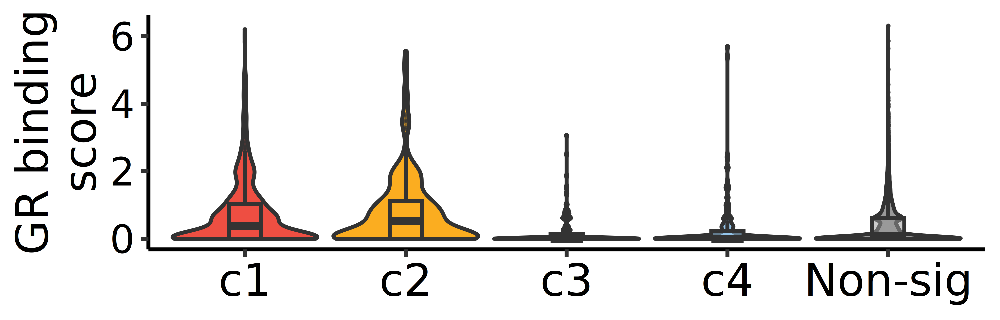

In [256]:
options(repr.plot.width = 5, repr.plot.height = 1.6,repr.plot.res=1200)

# Generate df for plotting & set factor order
df_plotting <- rbind(nonsig_merge,
             c1_sig_merge[,c(1,2,4)],
             c2_sig_merge[,c(1,2,4)],
             c3_sig_merge[,c(1,2,4)],
             c4_sig_merge[,c(1,2,4)])

df_plotting$sig <- factor(df_plotting$sig, levels = c('c1','c2','c3','c4','Non-sig'))

# 200kb
ggplot(df_plotting, aes(x=sig, y=Sum,fill=sig)) + geom_violin(scale='width')+ 
geom_boxplot(outlier.size=0,alpha=0.5,width=0.2) + theme_classic() + 
theme(legend.position='none',
      axis.text=element_text(size=14,color='black'),
      axis.text.x=element_text(size=16,color='black'),
      axis.title=element_text(size=16,color='black'),
     axis.title.x=element_blank())+ 
ylab('GR binding\nscore') + scale_fill_manual(values = c(as.vector(paletteer::paletteer_d("fishualize::Pseudocheilinus_tetrataenia")[1:4]),'grey60'))

In [264]:
# Run stats
t.test(df_plotting[df_plotting$sig=='c1','Sum'],
       df_plotting[df_plotting$sig=='Non-sig','Sum'],alternative = 'greater')

t.test(df_plotting[df_plotting$sig=='c2','Sum'],
       df_plotting[df_plotting$sig=='Non-sig','Sum'],alternative = 'greater')

t.test(df_plotting[df_plotting$sig=='c3','Sum'],
       df_plotting[df_plotting$sig=='Non-sig','Sum'],alternative = 'greater')

t.test(df_plotting[df_plotting$sig=='c4','Sum'],
       df_plotting[df_plotting$sig=='Non-sig','Sum'],alternative = 'greater')


	Welch Two Sample t-test

data:  df_plotting[df_plotting$sig == "c1", "Sum"] and df_plotting[df_plotting$sig == "Non-sig", "Sum"]
t = 8.1257, df = 592.65, p-value = 1.3e-15
alternative hypothesis: true difference in means is greater than 0
95 percent confidence interval:
 0.2705827       Inf
sample estimates:
mean of x mean of y 
0.7273472 0.3879551 



	Welch Two Sample t-test

data:  df_plotting[df_plotting$sig == "c2", "Sum"] and df_plotting[df_plotting$sig == "Non-sig", "Sum"]
t = 6.7849, df = 299.99, p-value = 3.1e-11
alternative hypothesis: true difference in means is greater than 0
95 percent confidence interval:
 0.3112977       Inf
sample estimates:
mean of x mean of y 
0.7992779 0.3879551 



	Welch Two Sample t-test

data:  df_plotting[df_plotting$sig == "c3", "Sum"] and df_plotting[df_plotting$sig == "Non-sig", "Sum"]
t = -6.6596, df = 214.15, p-value = 1
alternative hypothesis: true difference in means is greater than 0
95 percent confidence interval:
 -0.2510777        Inf
sample estimates:
mean of x mean of y 
0.1867809 0.3879551 



	Welch Two Sample t-test

data:  df_plotting[df_plotting$sig == "c4", "Sum"] and df_plotting[df_plotting$sig == "Non-sig", "Sum"]
t = -2.0867, df = 188.07, p-value = 0.9809
alternative hypothesis: true difference in means is greater than 0
95 percent confidence interval:
 -0.1985029        Inf
sample estimates:
mean of x mean of y 
0.2771929 0.3879551 


In [153]:
# Generate expression matrices for individual gene clusters

mat_scale_c1_melt <- reshape2::melt(mat_scale[names(cut_avg_wardD2[cut_avg_wardD2==1]),])
mat_scale_c1_melt$time <- ifelse(grepl('P07',mat_scale_c1_melt$Var2),'7',
                            ifelse(grepl('P14',mat_scale_c1_melt$Var2),'14',
                                 ifelse(grepl('P21', mat_scale_c1_melt$Var2),'21',
                                        ifelse(grepl('P28',mat_scale_c1_melt$Var2),'28','35'))))

mat_scale_c1_melt$rear <- ifelse(grepl('DR', mat_scale_c1_melt$Var2),'DR','NR')


mat_scale_c2_melt <- reshape2::melt(mat_scale[names(cut_avg_wardD2[cut_avg_wardD2==2]),])
mat_scale_c2_melt$time <- ifelse(grepl('P07',mat_scale_c2_melt$Var2),'7',
                            ifelse(grepl('P14',mat_scale_c2_melt$Var2),'14',
                                 ifelse(grepl('P21', mat_scale_c2_melt$Var2),'21',
                                        ifelse(grepl('P28',mat_scale_c2_melt$Var2),'28','35'))))

mat_scale_c2_melt$rear <- ifelse(grepl('DR', mat_scale_c2_melt$Var2),'DR','NR')


mat_scale_c3_melt <- reshape2::melt(mat_scale[names(cut_avg_wardD2[cut_avg_wardD2==3]),])
mat_scale_c3_melt$time <- ifelse(grepl('P07',mat_scale_c3_melt$Var2),'7',
                            ifelse(grepl('P14',mat_scale_c3_melt$Var2),'14',
                                 ifelse(grepl('P21', mat_scale_c3_melt$Var2),'21',
                                        ifelse(grepl('P28',mat_scale_c3_melt$Var2),'28','35'))))

mat_scale_c3_melt$rear <- ifelse(grepl('DR', mat_scale_c3_melt$Var2),'DR','NR')


mat_scale_c4_melt <- reshape2::melt(mat_scale[names(cut_avg_wardD2[cut_avg_wardD2==4]),])
mat_scale_c4_melt$time <- ifelse(grepl('P07',mat_scale_c4_melt$Var2),'7',
                            ifelse(grepl('P14',mat_scale_c4_melt$Var2),'14',
                                 ifelse(grepl('P21', mat_scale_c4_melt$Var2),'21',
                                        ifelse(grepl('P28',mat_scale_c4_melt$Var2),'28','35'))))

mat_scale_c4_melt$rear <- ifelse(grepl('DR', mat_scale_c4_melt$Var2),'DR','NR')

df_c1=summarySE(mat_scale_c1_melt, measurevar="value", groupvars=c("time","rear"))
df_c2=summarySE(mat_scale_c2_melt, measurevar="value", groupvars=c("time","rear"))
df_c3=summarySE(mat_scale_c3_melt, measurevar="value", groupvars=c("time","rear"))
df_c4=summarySE(mat_scale_c4_melt, measurevar="value", groupvars=c("time","rear"))

# Set cluster ID
df_c1$clus <- 'c1'
df_c2$clus <- 'c2'
df_c3$clus <- 'c3'
df_c4$clus <- 'c4'

# Merge into single df for plotting
df_merge <- rbind(df_c1,df_c2,df_c3,df_c4)

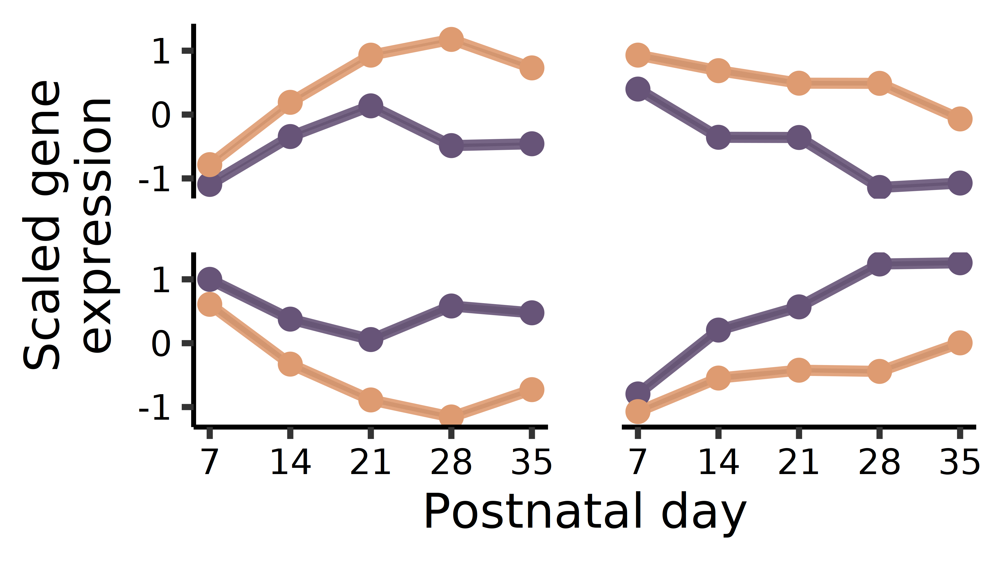

In [259]:
# Generate plot
p <- ggplot(df_merge, aes(x=as.numeric(time), y=value, color = rear)) +
theme_classic() +
geom_ribbon(aes(x=as.numeric(time),ymax = value + se, ymin = value - se),
              alpha = 1,
              fill = "grey40",
              linetype=0) + 
geom_line(aes(group=rear), size=.9, alpha=0.9) + geom_point(size=1.9) + facet_wrap2(~clus, ncol =2, scales = "free_x") +
scale_x_continuous(breaks=c(7,14,21,28,35)) + scale_y_continuous(breaks=c(-1,0,1)) + 
xlab('Postnatal day') + ylab('Scaled gene\nexpression') + 
theme(axis.text=element_text(color='black',size=8),
      axis.title=element_text(color='black',size=11),
      strip.background = element_blank(),
      strip.text = element_blank(),
      axis.line = element_line(colour = 'black', size = 0.4),
      panel.spacing.x = unit(6, "mm"),  # horizontal spacing between columns
        panel.spacing.y = unit(0, "mm"),
      legend.position='none') + 
scale_color_manual(labels = c('DR', 'NR'), values = rev(c("#DE9B71FF", "#675478FF"))) 

options(repr.plot.width = 3.2, repr.plot.height = 1.8,repr.plot.res=1200)

# Convert to grob
g <- ggplotGrob(p)

# Find all bottom x-axis grobs
axis_b_inds <- which(grepl("axis-b", g$layout$name))

# Keep only the first 2 (which correspond to the bottom 2 facets)
if (length(axis_b_inds) > 2) {
  for (i in axis_b_inds[-c(1,2)]) {
    g$grobs[[i]] <- nullGrob()
  }
}

# Draw the modified plot
grid.newpage()
grid.draw(g)

# Hierarchical clustering of vision-regulated genes across each cell type to distinguish cell-type-specific vs. ubiquitous DEGs

In [430]:
# Combine edgeR results to single dataframe
res_list_edger_name <- mclapply(res_list_edger_RNA, function(x) { x$gene_name <- rownames(x); x
                                                    }, mc.cores = 10)
DEG_df <- dplyr::bind_rows(res_list_edger_name, .id = "condition")

# Add cell-type & timepoint columns
DEG_df$celltype <- do.call(rbind, str_split(DEG_df$condition,'_'))[,1]
DEG_df$timepoint <- do.call(rbind, str_split(DEG_df$condition,'_'))[,2]

In [431]:
# Set the log2FC of non-significant DEGs to 0
DEG_df[(DEG_df$FDR >=0.05) | (is.na(DEG_df$FDR)),'logFC'] <- 0

In [432]:
DEG_df_grouped <- DEG_df %>%
                    group_by(gene_name, celltype) %>%
                    summarise(max_FC = logFC[which.max(abs(logFC))])

`summarise()` has grouped output by 'gene_name'. You can override using the
`.groups` argument.


In [433]:
# Cast dataframe to create gene vs. cell-type dataframe composed of log2FoldChange values of sig. genes 
DEG_df_dcast <- dcast(setDT(DEG_df_grouped), gene_name~celltype, value.var = 'max_FC')

In [434]:
# Subset genes for plotting that are differentially-expressed in 1 or more cell-types
DEG_df_dcast_sig <- DEG_df_dcast[DEG_df_dcast$gene_name %in% DEG_df[DEG_df$FDR < 0.05, 'gene_name'],]

# Change all NA to 0
DEG_df_dcast_sig[is.na(DEG_df_dcast_sig)] <- 0

In [436]:
# Transpose dataframe and set gene names as column names
DEG_df_dcast_sig_t <- t(DEG_df_dcast_sig)
colnames(DEG_df_dcast_sig_t) <- DEG_df_dcast_sig_t[1,]
DEG_df_dcast_sig_t <- DEG_df_dcast_sig_t[-1,]
class(DEG_df_dcast_sig_t) <- "numeric"

In [437]:
# Split into cell type-specific and shared DEGs (non-binarized matrix)
DEG_df_dcast_sig_t_cts <- DEG_df_dcast_sig_t[,colSums(DEG_df_dcast_sig_t!=0)==1]
DEG_df_dcast_sig_t_shared <- DEG_df_dcast_sig_t[,colSums(DEG_df_dcast_sig_t!=0)!=1]

In [438]:
reord_shared <- t(DEG_df_dcast_sig_t_shared)[,rev(c('L2/3',
                                'Astro',
                                'L6CT',
                                'L4',
                                'Oligo',
                                'Micro',
                                'L6IT',
                                'L5PT',
                                'L5IT', 
                                'Pvalb+',
                                'VLMC',
                                'Endo',
                                'Sst+',
                                'SMC-Peri',
                                'Meis2+',
                                'Lamp5+',
                                'L5NP',
                                'OPC',
                                'Vip+',
                                'L6b',
                                'Immature',
                                'CR cells'))]

reord_cts <- t(DEG_df_dcast_sig_t_cts)[,rev(c('L2/3',
                                'Astro',
                                'L6CT',
                                'L4',
                                'Oligo',
                                'Micro',
                                'L6IT',
                                'L5PT',
                                'L5IT', 
                                'Pvalb+',
                                'VLMC',
                                'Endo',
                                'Sst+',
                                'SMC-Peri',
                                'Meis2+',
                                'Lamp5+',
                                'L5NP',
                                'OPC',
                                'Vip+',
                                'L6b',
                                'Immature',
                                'CR cells'))]

In [439]:
# Re-order by log2FC for each cell type (ranked by DEG # per cell type)
reord_cts_order <- rbind(reord_cts[reord_cts[, "L2/3"] != 0, ][order(reord_cts[reord_cts[, "L2/3"] != 0, "L2/3"]), ],
                         reord_cts[reord_cts[, "Astro"] != 0, ][order(reord_cts[reord_cts[, "Astro"] != 0, "Astro"]), ],
                         reord_cts[reord_cts[, "L6CT"] != 0, ][order(reord_cts[reord_cts[, "L6CT"] != 0, "L6CT"]), ],
                         reord_cts[reord_cts[, "L4"] != 0, ][order(reord_cts[reord_cts[, "L4"] != 0, "L4"]), ],
                         reord_cts[reord_cts[, "Oligo"] != 0, ][order(reord_cts[reord_cts[, "Oligo"] != 0, "Oligo"]), ],
                         reord_cts[reord_cts[, "Micro"] != 0, ][order(reord_cts[reord_cts[, "Micro"] != 0, "Micro"]), ],
                         reord_cts[reord_cts[, "L6IT"] != 0, ][order(reord_cts[reord_cts[, "L6IT"] != 0, "L6IT"]), ],
                         reord_cts[reord_cts[, "L5PT"] != 0, ][order(reord_cts[reord_cts[, "L5PT"] != 0, "L5PT"]), ],
                         reord_cts[reord_cts[, "L5IT"] != 0, ][order(reord_cts[reord_cts[, "L5IT"] != 0, "L5IT"]), ],
                         reord_cts[reord_cts[, "Pvalb+"] != 0, ][order(reord_cts[reord_cts[, "Pvalb+"] != 0, "Pvalb+"]), ],
                         reord_cts[reord_cts[, "VLMC"] != 0, ][order(reord_cts[reord_cts[, "VLMC"] != 0, "VLMC"]), ],
                         reord_cts[reord_cts[, "Endo"] != 0, ][order(reord_cts[reord_cts[, "Endo"] != 0, "Endo"]), ],
                         reord_cts[reord_cts[, "Sst+"] != 0, ][order(reord_cts[reord_cts[, "Sst+"] != 0, "Sst+"]), ],
                         reord_cts[reord_cts[, "SMC-Peri"] != 0, ][order(reord_cts[reord_cts[, "SMC-Peri"] != 0, "SMC-Peri"]), ],
                         reord_cts[reord_cts[, "Meis2+"] != 0, ][order(reord_cts[reord_cts[, "Meis2+"] != 0, "Meis2+"]), ],
                         reord_cts[reord_cts[, "Lamp5+"] != 0, ][order(reord_cts[reord_cts[, "Lamp5+"] != 0, "Lamp5+"]), ],
                         reord_cts[reord_cts[, "L5NP"] != 0, ][order(reord_cts[reord_cts[, "L5NP"] != 0, "L5NP"]), ],
                         reord_cts[reord_cts[, "OPC"] != 0, ][order(reord_cts[reord_cts[, "OPC"] != 0, "OPC"]), ],
                         reord_cts[reord_cts[, "Vip+"] != 0, ,drop=FALSE][order(reord_cts[reord_cts[, "Vip+"] != 0, "Vip+"]), ],
                         reord_cts[reord_cts[, "L6b"] != 0, ,drop=FALSE][order(reord_cts[reord_cts[, "L6b"] != 0, "L6b"]), ])

reord_cts_order <- reord_cts_order[,-c(1,2)]
reord_shared <- reord_shared[,-c(1,2)]

Warning message:
"border color is set for the matrix with large numbers of rows or
columns. You might only be able to see the border colors in the plot.
Set `border_color = NA` to get rid of it."
Warning message:
"border color is set for the matrix with large numbers of rows or
columns. You might only be able to see the border colors in the plot.
Set `border_color = NA` to get rid of it."


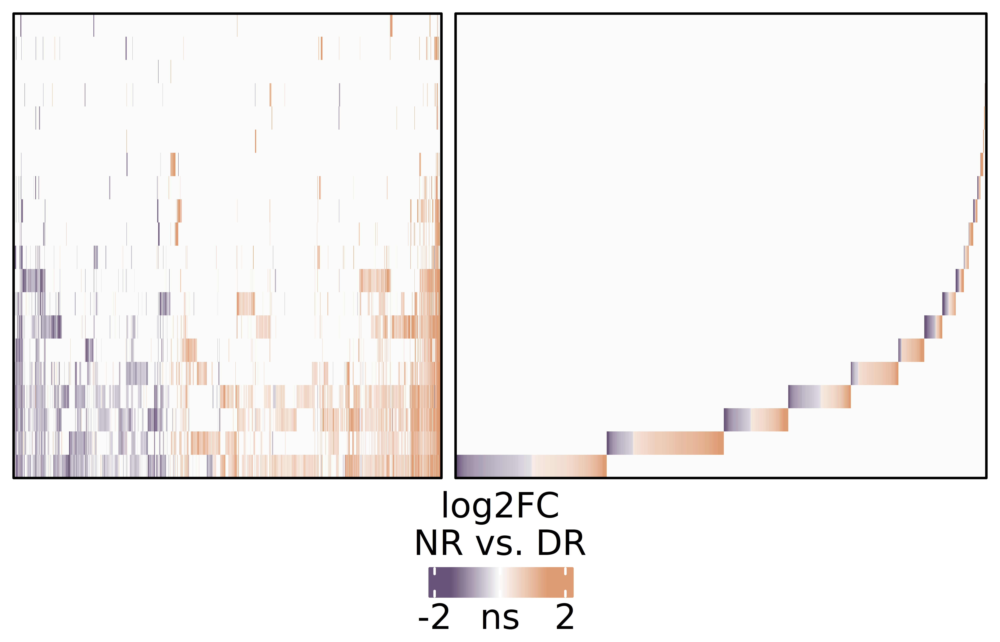

In [451]:
# Generate plot  
options(repr.plot.width = 5.6, repr.plot.height = 3.6,repr.plot.res=1200)
p1 <- ComplexHeatmap::pheatmap(t(reord_shared), 
         cluster_rows = F,
         cluster_cols = T,
         fontsize = 10,
        row_names_side = "left",
        border_color = 'NA',
        breaks = seq(-1.5,1.5, length.out=100), 
        color = colorRampPalette(rev(c("#DE9B71FF", "grey99", "#675478FF")))(100), 
         heatmap_legend_param = list(title = "log2FC\nNR vs. DR",
                                     at = c(-2, 0, 2),      
                                     labels = c("-2", "ns", "2"),
                                     legend_height = unit(0.6, "cm"),
                                     legend_width = unit(2, "cm"),
                                     title_position = "topcenter",
                                     legend_direction = "horizontal", 
                                     title_gp = gpar(fontsize = 14),
                                     labels_gp = gpar(fontsize = 14)),
         show_column_dend = FALSE,
                               legend = TRUE,
        clustering_method='ward.D2',
        name='heatmap1',
         show_rownames = F,
         show_colnames = F)

p2 <- ComplexHeatmap::pheatmap(t(reord_cts_order), 
         cluster_rows = F,
         cluster_cols = F,
         fontsize = 10,
        use_raster=FALSE,
        row_names_side = "left",
        border_color = 'NA',
        breaks = seq(-1.5,1.5, length.out=100), 
        color = colorRampPalette(rev(c("#DE9B71FF", "grey99", "#675478FF")))(100), 
        legend=FALSE,
        show_column_dend = FALSE,
        name='heatmap2',
         show_rownames = F,
         show_colnames = F)


p_list <- p1 + p2

draw(p_list, heatmap_legend_side="bottom", annotation_legend_side="bottom")
decorate_heatmap_body('heatmap1',
                      {
                        grid.rect(gp = gpar(col = "black", lwd = 1))
                      })
decorate_heatmap_body('heatmap2',
                     {
                       grid.rect(gp = gpar(col = "black", lwd = 1))
                     })

# Visualize DEGs of interest on line plots

In [3]:
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')

In [4]:
# Convert to SCE
DefaultAssay(final_obj) <- 'RNA'
final_obj_sce <- as.SingleCellExperiment(final_obj)

Warning message:
"`PackageCheck()` was deprecated in SeuratObject 5.0.0.
ℹ Please use `rlang::check_installed()` instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>."
Warning message:
"The `slot` argument of `GetAssayData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>."


In [38]:
# Load in DEG results
edger_RNA <- readRDS('250508_res_listv3_edger.rds')

In [6]:
# Subset excitatory, inhibitory, and non-neuronal cells
final_obj_sce_ex <- final_obj_sce[,colData(final_obj_sce)$subtype %in% c('L2/3','L4','L5IT','L5PT',
                                                                         'L5NP','L6CT','L6IT','L6b')]
final_obj_sce_in <- final_obj_sce[,colData(final_obj_sce)$subtype %in% c('Lamp5+','Pvalb+','Sst+','Vip+',
                                                                         'Immature','CR cells','Meis2+')]
final_obj_sce_non <- final_obj_sce[,colData(final_obj_sce)$subtype %in% c('Astro','Endo','Oligo',
                                                                          'Micro','SMC-Peri','VLMC')]

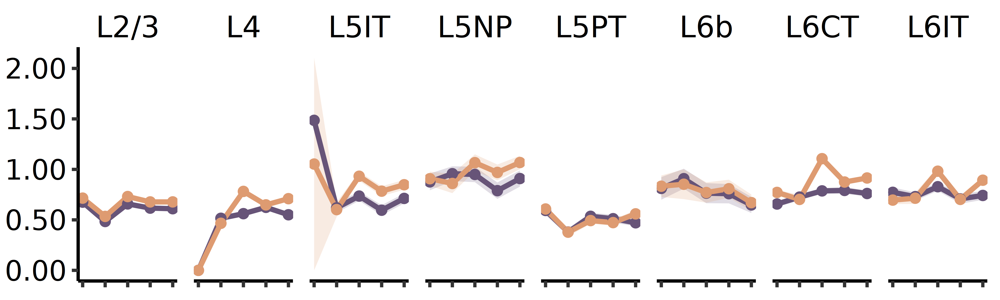

In [111]:
# Excitatory neuron gene
goi <- 'Srrm4'
df <- data.frame(counts = logcounts(final_obj_sce_ex)[goi,],
                Timepoint = colData(final_obj_sce_ex)$Timepoint,
                Treatment = colData(final_obj_sce_ex)$Treatment,
                Subtype = colData(final_obj_sce_ex)$subtype)

tgc_ex <- summarySE(df, measurevar="counts", groupvars=c("Timepoint","Treatment","Subtype"))

tgc_ex$Timepoint <- as.numeric(substr(tgc_ex$Timepoint, 2, nchar(tgc_ex$Timepoint)))

tgc_ex$Subtype <- factor(tgc_ex$Subtype, levels = c('L2/3','L4','L5IT','L5NP',
                                                    'L5PT','L6b','L6CT','L6IT'))

strip <- strip_themed(background_x = elem_list_rect(fill = c('white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white')))
scaleFUN <- function(x) sprintf("%.2f", x)
p1 <- ggplot(tgc_ex, aes(x=Timepoint, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Timepoint),ymax = counts + se, ymin = counts - se, fill = Treatment),
              alpha = 0.2,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=.8) +
    geom_point(shape=19,size=1.5) +
    facet_wrap2(~ Subtype, ncol = 8, strip = strip,trim_blank=FALSE) +
    labs(x = "",
       y = "log(CPM + 1)") +
    ggtitle(goi) +
  theme_classic() +
  theme(legend.position = 'none',
        plot.title = element_blank(),
        axis.text = element_text(color = 'black'),
        axis.line = element_line(color='black'),
        panel.spacing = unit(0.5, "lines"),
        axis.title = element_blank(),
            panel.background = element_rect(fill='transparent'), #transparent panel bg
    plot.background = element_rect(fill='transparent', color=NA), #transparent plot bg
    panel.grid.major = element_blank(), #remove major gridlines
    panel.grid.minor = element_blank(), #remove minor gridlines
    legend.background = element_rect(fill='transparent'), #transparent legend bg
    legend.box.background = element_rect(fill='transparent'),
        axis.text.y = element_text(size = 12,color='black'),
        axis.text.x = element_blank(),
        strip.text = element_text(color = "black", size = 12.7,margin = margin(-0.05,0,1,0, "mm")),
        strip.background = element_rect(colour = 'transparent',fill='transparent')) + 
scale_y_continuous(labels=scaleFUN) +
scale_color_manual(values = c("#675478FF","#DE9B71FF")) + scale_fill_manual(values = c("#675478FF","#DE9B71FF")) + scale_x_continuous(breaks=c(7,14,21,28,35))
options(repr.plot.width = 6, repr.plot.height = 1.8,repr.plot.res=800)
p1


Warning message in qt(conf.interval/2 + 0.5, datac$N - 1):
"NaNs produced"


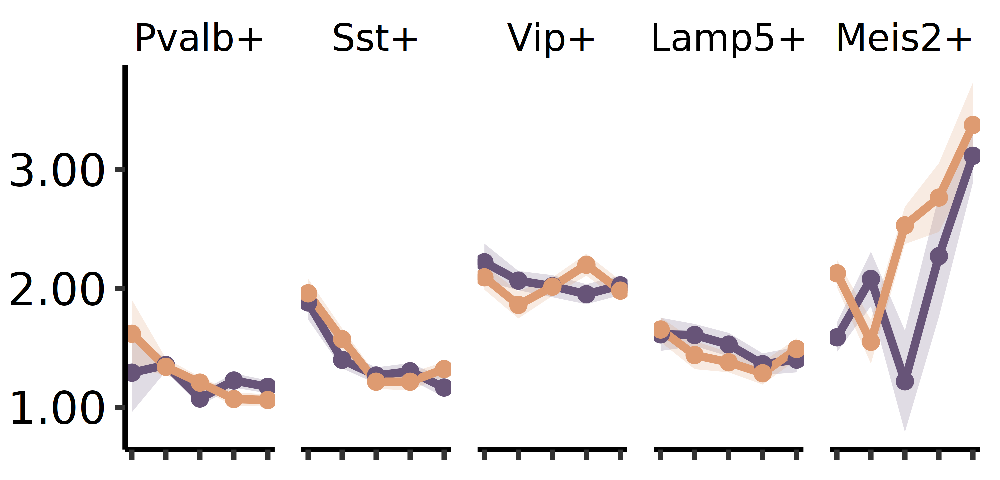

In [59]:
goi <- 'Dcc'
df <- data.frame(counts = logcounts(final_obj_sce_in)[goi,],
                Timepoint = colData(final_obj_sce_in)$Timepoint,
                Treatment = colData(final_obj_sce_in)$Treatment,
                Subtype = colData(final_obj_sce_in)$subtype)

tgc_in <- summarySE(df, measurevar="counts", groupvars=c("Timepoint","Treatment","Subtype"))

tgc_in$Timepoint <- as.numeric(substr(tgc_in$Timepoint, 2, nchar(tgc_in$Timepoint)))

tgc_in$Subtype <- factor(tgc_in$Subtype, levels = c('Pvalb+','Sst+','Vip+',
                                                    'Lamp5+','Meis2+','CR cells','Immature'))

tgc_in <- tgc_in[!tgc_in$Subtype %in% c('Immature','CR cells'),]


strip <- strip_themed(background_x = elem_list_rect(fill = c('white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white')))
scaleFUN <- function(x) sprintf("%.2f", x)

p1 <- ggplot(tgc_in, aes(x=Timepoint, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Timepoint),ymax = counts + se, ymin = counts - se, fill = Treatment),
              alpha = 0.2,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=0.8) +
    geom_point(size=1.5) +
    facet_wrap2(~ Subtype, ncol = 5, strip = strip,trim_blank=FALSE) +
    labs(x = "",
       y = "log(CPM + 1)") +
    ggtitle(goi) +
  theme_classic() +
  theme(legend.position = 'none',
        plot.title = element_blank(),
        axis.text = element_text(color = 'black'),
        axis.line = element_line(color='black'),
        panel.spacing = unit(0.5, "lines"),
        axis.title = element_blank(),
            panel.background = element_rect(fill='transparent'), #transparent panel bg
    plot.background = element_rect(fill='transparent', color=NA), #transparent plot bg
    panel.grid.major = element_blank(), #remove major gridlines
    panel.grid.minor = element_blank(), #remove minor gridlines
    legend.background = element_rect(fill='transparent'), #transparent legend bg
    legend.box.background = element_rect(fill='transparent'),
        axis.text.y = element_text(size = 12,color='black'),
        axis.text.x = element_blank(),
        strip.text = element_text(color = "black", size = 10,margin = margin(-0.05,0,1,0, "mm")),
        strip.background = element_rect(colour = 'transparent',fill='transparent')) + 
scale_y_continuous(labels=scaleFUN) +
scale_color_manual(values = c("#675478FF","#DE9B71FF")) + scale_fill_manual(values = c("#675478FF","#DE9B71FF")) + scale_x_continuous(breaks=c(7,14,21,28,35))
options(repr.plot.width = 6 * 5/8, repr.plot.height = 1.8,repr.plot.res=800)
p1

Warning message in qt(conf.interval/2 + 0.5, datac$N - 1):
"NaNs produced"


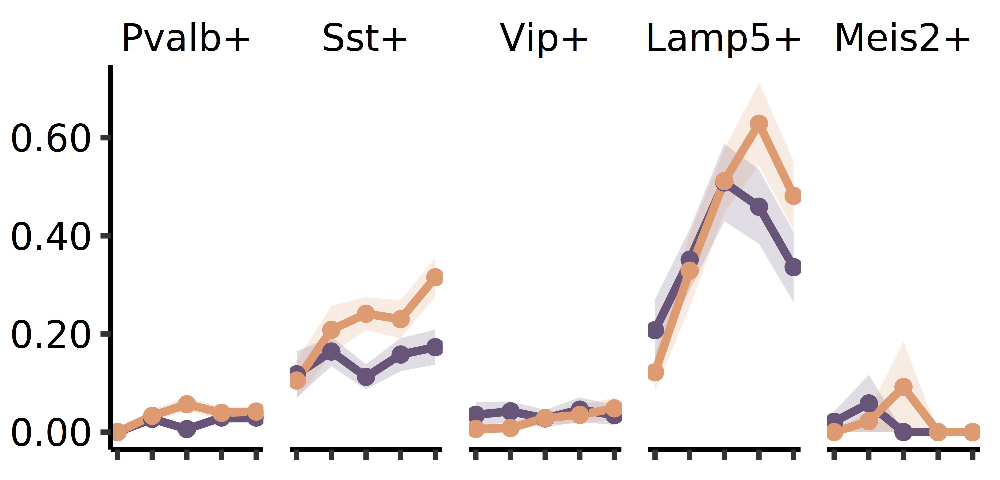

In [115]:
goi <- 'Npy'
df <- data.frame(counts = logcounts(final_obj_sce_in)[goi,],
                Timepoint = colData(final_obj_sce_in)$Timepoint,
                Treatment = colData(final_obj_sce_in)$Treatment,
                Subtype = colData(final_obj_sce_in)$subtype)

tgc_in <- summarySE(df, measurevar="counts", groupvars=c("Timepoint","Treatment","Subtype"))

tgc_in$Timepoint <- as.numeric(substr(tgc_in$Timepoint, 2, nchar(tgc_in$Timepoint)))

tgc_in$Subtype <- factor(tgc_in$Subtype, levels = c('Pvalb+','Sst+','Vip+',
                                                    'Lamp5+','Meis2+','CR cells','Immature'))

tgc_in <- tgc_in[!tgc_in$Subtype %in% c('Immature','CR cells'),]


strip <- strip_themed(background_x = elem_list_rect(fill = c('white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white')))
scaleFUN <- function(x) sprintf("%.2f", x)

p1 <- ggplot(tgc_in, aes(x=Timepoint, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Timepoint),ymax = counts + se, ymin = counts - se, fill = Treatment),
              alpha = 0.2,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=0.8) +
    geom_point(size=1.5) +
    facet_wrap2(~ Subtype, ncol = 5, strip = strip,trim_blank=FALSE) +
    labs(x = "",
       y = "log(CPM + 1)") +
    ggtitle(goi) +
  theme_classic() +
  theme(legend.position = 'none',
        plot.title = element_blank(),
        axis.text = element_text(color = 'black'),
        axis.line = element_line(color='black'),
        panel.spacing = unit(0.5, "lines"),
        axis.title = element_blank(),
            panel.background = element_rect(fill='transparent'), #transparent panel bg
    plot.background = element_rect(fill='transparent', color=NA), #transparent plot bg
    panel.grid.major = element_blank(), #remove major gridlines
    panel.grid.minor = element_blank(), #remove minor gridlines
    legend.background = element_rect(fill='transparent'), #transparent legend bg
    legend.box.background = element_rect(fill='transparent'),
        axis.text.y = element_text(size = 10,color='black'),
        #plot.margin = unit(c(0,2,0,2), "mm"),
        axis.text.x = element_blank(),
        strip.text = element_text(color = "black", size = 10,margin = margin(-0.05,0,1,0, "mm")),
        strip.background = element_rect(colour = 'transparent',fill='transparent')) + 
scale_y_continuous(labels=scaleFUN) +
scale_color_manual(values = c("#675478FF","#DE9B71FF")) + scale_fill_manual(values = c("#675478FF","#DE9B71FF")) + scale_x_continuous(breaks=c(7,14,21,28,35))
options(repr.plot.width = 6 * 5/8, repr.plot.height = 1.8,repr.plot.res=800)
p1


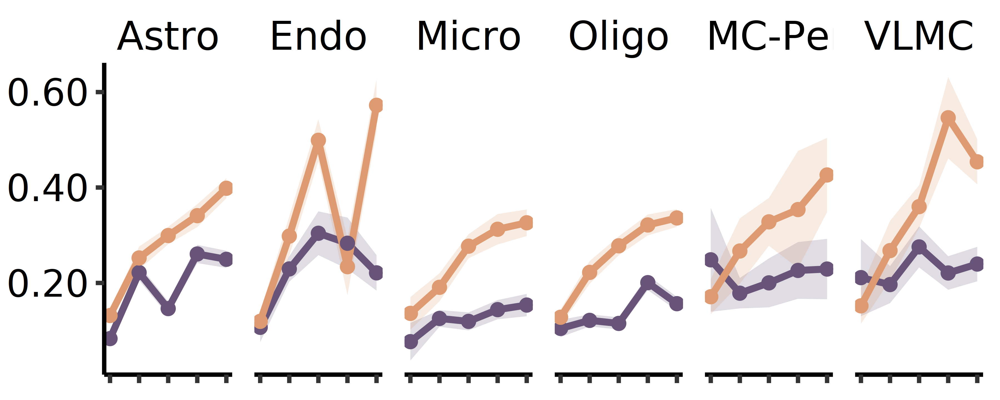

In [156]:
goi <- 'Pcsk1'
df <- data.frame(counts = logcounts(final_obj_sce_non)[goi,],
                Timepoint = colData(final_obj_sce_non)$Timepoint,
                Treatment = colData(final_obj_sce_non)$Treatment,
                Subtype = colData(final_obj_sce_non)$subtype)

tgc_non <- summarySE(df, measurevar="counts", groupvars=c("Timepoint","Treatment","Subtype"))

tgc_non$Timepoint <- as.numeric(substr(tgc_non$Timepoint, 2, nchar(tgc_non$Timepoint)))

tgc_non$Subtype <- factor(tgc_non$Subtype,levels=c('Astro','Endo','Micro','Oligo','SMC-Peri','VLMC'))

strip <- strip_themed(background_x = elem_list_rect(fill = c('white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white',
                                                             'white')))
scaleFUN <- function(x) sprintf("%.2f", x)
#pd <- position_dodge(0.1)
p1 <- ggplot(tgc_non, aes(x=Timepoint, y=counts, colour=Treatment)) + 
   # geom_errorbar(aes(ymin=counts-se, ymax=counts+se), width=.2,size=1) +
    geom_ribbon(aes(x=as.numeric(Timepoint),ymax = counts + se, ymin = counts - se, fill = Treatment),
              alpha = 0.2,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=0.8) +
    geom_point(size=1.5) +
    facet_wrap2(~ Subtype, ncol = 6, strip = strip,trim_blank=FALSE) +
    labs(x = "",
       y = "log(CPM + 1)") +
    ggtitle(goi) +
  theme_classic() +
  theme(legend.position = 'none',
        plot.title = element_blank(),
        axis.text = element_text(color = 'black'),
        axis.line = element_line(color='black'),
        panel.spacing = unit(0.5, "lines"),
        axis.title = element_blank(),
            panel.background = element_rect(fill='transparent'), #transparent panel bg
    plot.background = element_rect(fill='transparent', color=NA), #transparent plot bg
    panel.grid.major = element_blank(), #remove major gridlines
    panel.grid.minor = element_blank(), #remove minor gridlines
    legend.background = element_rect(fill='transparent'), #transparent legend bg
    legend.box.background = element_rect(fill='transparent'),
        axis.text.y = element_text(size = 12,color='black'),
        axis.text.x = element_blank(),
        strip.text = element_text(color = "black", size = 12.7,margin = margin(-0.05,0,1,0, "mm")),
        strip.background = element_rect(colour = 'transparent',fill='transparent')) + 
scale_y_continuous(labels=scaleFUN) +
scale_color_manual(values = c("#675478FF","#DE9B71FF")) + scale_fill_manual(values = c("#675478FF","#DE9B71FF")) + scale_x_continuous(breaks=c(7,14,21,28,35))
options(repr.plot.width = 6 * 6/8, repr.plot.height = 1.8,repr.plot.res=800)
p1

# Visualize DEGs of interest in heatmap for Fig. 1

In [2]:
# Read RDS object
final_obj <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230726_final_obj_peakset_geneactivity_impute.rds')
res_list_edger_RNA <- readRDS('250508_res_listv3_edger.rds')

In [24]:
# Combine edgeR results to single dataframe
res_list_edger_name <- mclapply(res_list_edger_RNA, function(x) { x$gene_name <- rownames(x); x
                                                    }, mc.cores = 10)
DEG_df <- dplyr::bind_rows(res_list_edger_name, .id = "condition")

# Add cell-type & timepoint columns
DEG_df$celltype <- do.call(rbind, str_split(DEG_df$condition,'_'))[,1]
DEG_df$timepoint <- do.call(rbind, str_split(DEG_df$condition,'_'))[,2]

# Set the log2FC of non-significant DEGs to 0
DEG_df[(DEG_df$FDR >=0.05) | (is.na(DEG_df$FDR)),'logFC'] <- 0

# Subset excitatory, inhibitory, and non-neuronal cells
DEG_df_ex <- DEG_df[DEG_df$celltype %in% c('L2/3','L4','L5IT','L5PT','L5NP','L6CT','L6IT','L6b'),]
DEG_df_in <- DEG_df[DEG_df$celltype %in% c('Lamp5+','Pvalb+','Sst+','Vip+','Immature','CR cells','Meis2+'),]
DEG_df_non <- DEG_df[DEG_df$celltype %in% c('Astro','Endo','Oligo','Micro','SMC-Peri','VLMC'),]

In [422]:
# Cast dataframe to create gene vs. cell-type dataframe composed of log2FoldChange values of sig. genes
goi <- 'Thbs2'
DEG_df_ex_dcast <- as.data.frame(dcast(setDT(DEG_df_ex[DEG_df_ex$gene_name == goi,]), celltype~timepoint, value.var = 'logFC'))
DEG_df_ex_dcast[is.na(DEG_df_ex_dcast)] <- 0
rownames(DEG_df_ex_dcast) <- DEG_df_ex_dcast$celltype
DEG_df_ex_dcast <- DEG_df_ex_dcast[,-1]

# fill in missing data
cell_names <- c('L2/3','L4','L5IT','L5PT','L5NP','L6CT','L6IT','L6b')

# Loop through each cell name
for (i in cell_names) {
  if (!(i %in% rownames(DEG_df_ex_dcast))) {
    # Create a new row of 0s with same column names
    new_row <- as.data.frame(matrix(0, nrow = 1, ncol = 5))
    colnames(new_row) <- colnames(DEG_df_ex_dcast)
    rownames(new_row) <- i
    
    # Add the new row
    DEG_df_ex_dcast <- rbind(DEG_df_ex_dcast, new_row)
  }
}

# Arrange order 
DEG_df_ex_dcast <- DEG_df_ex_dcast[c('L2/3','L4','L5IT','L5PT','L5NP','L6IT','L6CT','L6b'),]

In [ ]:
# Generate plot
options(repr.plot.width = 4.5 , repr.plot.height = 4,repr.plot.res=300)

col_fun = colorRamp2(seq(-1,1,length.out=3), c('#675478','grey95','#de9b71'))

p1 <- ComplexHeatmap::pheatmap(DEG_df_ex_dcast, 
         cluster_rows = F,
         cluster_cols = F,
         fontsize = 22,
        col = col_fun,  
        row_names_side = "left",
        column_title = NULL,
        border_color = 'grey30',
        legend = TRUE,
        heatmap_legend_param = list(direction = "horizontal",
             at = c(-1,0, 1),
             labels = c('-1','ns','1'),
             title = "log2FC\nNR vs. DR",
             labels_gp = gpar(fontsize = 18),
             title_gp = gpar(fontsize = 18,lineheight = 0.8),
             title_gp = gpar(fontface = 'plain'),
             legend_height = unit(4, "mm") 
             ),
         show_rownames = F,
         show_colnames = F)

In [424]:
# Cast dataframe to create gene vs. cell-type dataframe composed of log2FoldChange values of sig. genes
goi <- 'Btbd11'
DEG_df_in_dcast <- as.data.frame(dcast(setDT(DEG_df_in[DEG_df_in$gene_name == goi,]), celltype~timepoint, value.var = 'logFC'))
DEG_df_in_dcast[is.na(DEG_df_in_dcast)] <- 0
rownames(DEG_df_in_dcast) <- DEG_df_in_dcast$celltype
DEG_df_in_dcast <- DEG_df_in_dcast[,-1]

# fill in missing data
cell_names <- c('Lamp5+','Pvalb+','Sst+','Vip+','Immature','CR cells','Meis2+')

# Loop through each cell name
for (i in cell_names) {
  if (!(i %in% rownames(DEG_df_in_dcast))) {
    # Create a new row of 0s with same column names
    new_row <- as.data.frame(matrix(0, nrow = 1, ncol = 5))
    colnames(new_row) <- colnames(DEG_df_in_dcast)
    rownames(new_row) <- i
    
    # Add the new row
    DEG_df_in_dcast <- rbind(DEG_df_in_dcast, new_row)
  }
}

# Arrange order 
DEG_df_in_dcast <- DEG_df_in_dcast[c('Pvalb+','Sst+','Vip+','Immature','Meis2+','Lamp5+','CR cells'),]

In [ ]:
# Generate plot
options(repr.plot.width = 4.5 , repr.plot.height = 4 * 7/8,repr.plot.res=300)

col_fun = colorRamp2(seq(-1,1,length.out=3), c('#675478','grey95','#de9b71'))

p2 <- ComplexHeatmap::pheatmap(DEG_df_in_dcast, 
         cluster_rows = F,
         cluster_cols = F,
         fontsize = 18,
        col = col_fun,  
        row_names_side = "left",
        column_title = NULL,
        border_color = 'grey30',
        legend = TRUE,
        heatmap_legend_param = list(direction = "horizontal",
             at = c(-1,0, 1),
             labels = c('-1','ns','1'),
             title = "log2FC\nNR vs. DR",
             labels_gp = gpar(fontsize = 18),
             title_gp = gpar(fontsize = 18,lineheight = 0.8),
             title_position = "topcenter",
             title_gp = gpar(fontface = 'plain'),
             legend_height = unit(4, "mm") 
             ),
         show_rownames = F,
         show_colnames = F)

In [426]:
# Cast dataframe to create gene vs. cell-type dataframe composed of log2FoldChange values of sig. genes
goi <- 'Ezr'
DEG_df_non_dcast <- as.data.frame(dcast(setDT(DEG_df_non[DEG_df_non$gene_name == goi,]), celltype~timepoint, value.var = 'logFC'))
DEG_df_non_dcast[is.na(DEG_df_non_dcast)] <- 0
rownames(DEG_df_non_dcast) <- DEG_df_non_dcast$celltype
DEG_df_non_dcast <- DEG_df_non_dcast[,-1]

# fill in missing data
cell_names <- c('Astro','Endo','Oligo','OPC','Micro','SMC-Peri','VLMC')

# Loop through each cell name
for (i in cell_names) {
  if (!(i %in% rownames(DEG_df_non_dcast))) {
    # Create a new row of 0s with same column names
    new_row <- as.data.frame(matrix(0, nrow = 1, ncol = 5))
    colnames(new_row) <- colnames(DEG_df_non_dcast)
    rownames(new_row) <- i
    
    # Add the new row
    DEG_df_non_dcast <- rbind(DEG_df_non_dcast, new_row)
  }
}

# Arrange order 
DEG_df_non_dcast <- DEG_df_non_dcast[c('Astro','Oligo','OPC','SMC-Peri','VLMC','Endo','Micro'),]

In [ ]:
# Generate plot
col_fun = colorRamp2(seq(-1,1,length.out=3), c('#675478','grey95','#de9b71'))

p3 <- ComplexHeatmap::pheatmap(DEG_df_non_dcast, 
         cluster_rows = F,
         cluster_cols = F,
         fontsize = 18,
        col = col_fun,  
        row_names_side = "left",
        column_title = NULL,
        border_color = 'grey30',
        legend = TRUE,
        heatmap_legend_param = list(direction = "horizontal",
             at = c(-2,0, 2),
             labels = c('-1','ns','1'),
             title = "log2FC\nNR vs. DR",
             labels_gp = gpar(fontsize = 18),
             title_gp = gpar(fontsize = 18,lineheight = 0.8),
             title_position = "topcenter",
             title_gp = gpar(fontface = 'plain'),
             legend_height = unit(4, "mm") 
             ),
         show_rownames = F,
         show_colnames=F)

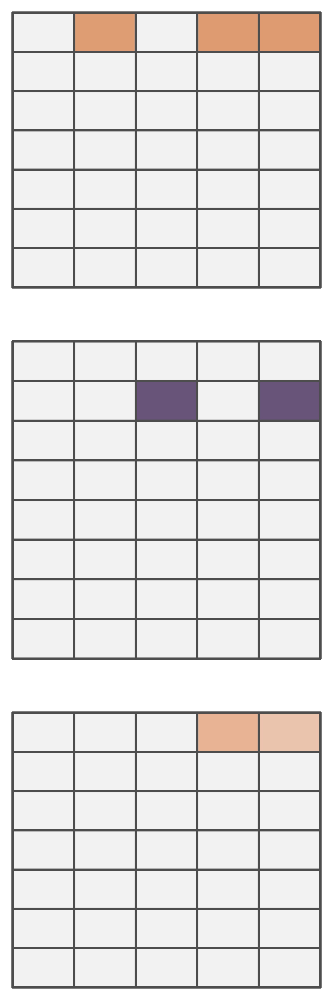

In [428]:
# Generate plot with legend
options(repr.plot.width = 2, repr.plot.height = 6,repr.plot.res=800)
plot_grid(grid.grabExpr(draw(p3,show_heatmap_legend = FALSE)),
          NULL,
          grid.grabExpr(draw(p1,show_heatmap_legend = FALSE)),
          NULL,
          grid.grabExpr(draw(p2,show_heatmap_legend = FALSE)), 
  ncol = 1,
          rel_heights = c(7/8,1/12,1,1/12,7/8)
)

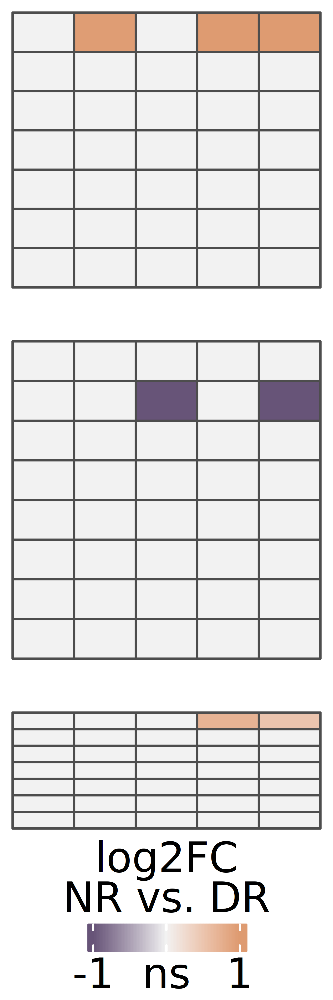

In [429]:
# Generate plot with legend
options(repr.plot.width = 2, repr.plot.height = 6,repr.plot.res=800)
plot_grid(grid.grabExpr(draw(p3,show_heatmap_legend = FALSE)),
          NULL,
          grid.grabExpr(draw(p1,show_heatmap_legend = FALSE)),
          NULL,
          grid.grabExpr(draw(p2,heatmap_legend_side='bottom')), 
  ncol = 1,
          rel_heights = c(7/8,1/12,1,1/12,7/8)
)

# Add motif information to Seurat object

In [ ]:
# Collect a list of motif position frequency matrices from the JASPAR database
pfm <- getMatrixSet(
  x = JASPAR2020,
  opts = list(collection = "CORE", tax_group = 'vertebrates', all_versions = FALSE)
)

In [ ]:
# add motif information to signac object
DefaultAssay(final_obj) <- 'peaks'
final_obj_motif <- AddMotifs(object = final_obj, genome = BSgenome.Mmusculus.UCSC.mm10, pfm = pfm)

In [ ]:
# Save RDS file
saveRDS(final_obj_motif, '/n/groups/neuroduo/Bruno/RDS_files/230809_final_obj_motif.rds')

# Compute single-cell chromVAR deviation scores

In [ ]:
# Run Rscript job on O2 and load RDS file 

In [ ]:
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

# Export data for GEO upload

In [8]:
# Read RDS object
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [9]:
# Add replicate info as metadata column (if not already present)
final_obj_motif_chromVAR$Replicatev2 <- ifelse(grepl('1a|1b', final_obj_motif_chromVAR$orig.ident) & final_obj_motif_chromVAR$Sex == 'F', '1',
                              ifelse(grepl('1a|1b', final_obj_motif_chromVAR$orig.ident) & final_obj_motif_chromVAR$Sex == 'M', '2',
                                     ifelse(final_obj_motif_chromVAR$Sex == 'F','3','4')))

In [17]:
# Remove unused metadata columns
final_obj_motif_chromVAR@meta.data$RNA_snn_res.0.2 <- NULL
final_obj_motif_chromVAR@meta.data$library <- NULL
final_obj_motif_chromVAR@meta.data$clus14 <- NULL
final_obj_motif_chromVAR@meta.data$clus14 <- NULL
final_obj_motif_chromVAR@meta.data$doublet_score <- NULL
final_obj_motif_chromVAR@meta.data$predicted_doublet <- NULL
final_obj_motif_chromVAR@meta.data$DoubletCall <- NULL
final_obj_motif_chromVAR@meta.data$DoubletScore <- NULL
final_obj_motif_chromVAR@meta.data$nCount_SCT <- NULL
final_obj_motif_chromVAR@meta.data$nFeature_SCT <- NULL
final_obj_motif_chromVAR@meta.data$DF.classification <- NULL
final_obj_motif_chromVAR@meta.data$DF.pANN <- NULL
final_obj_motif_chromVAR@meta.data$SCT_snn_res.0.8 <- NULL
final_obj_motif_chromVAR@meta.data$seurat_clusters <- NULL
final_obj_motif_chromVAR@meta.data$TimepointTreatment <- NULL
final_obj_motif_chromVAR@meta.data$Replicate <- NULL
final_obj_motif_chromVAR@meta.data$sample_index <- NULL
final_obj_motif_chromVAR@meta.data$sublibrary <- NULL
final_obj_motif_chromVAR@meta.data$Treatment_replicate <- NULL
names(final_obj_motif_chromVAR@meta.data)[names(final_obj_motif_chromVAR@meta.data) == 'Replicatev2'] <- 'Replicate'

In [24]:
saveRDS(final_obj_motif_chromVAR, '/n/groups/neuroduo/Bruno/GEO_upload/Multiome/V1_SHAREseq_seurat_obj.rds')

# Identify DARs by pooling P21-P35 timepoints vs. P7-P14 timepoints

In [3]:
# Read RDS object
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [4]:
# Add replicate info as metadata column (if not already present)
final_obj_motif_chromVAR$Replicatev2 <- ifelse(grepl('1a|1b', final_obj_motif_chromVAR$orig.ident) & final_obj_motif_chromVAR$Sex == 'F', '1',
                              ifelse(grepl('1a|1b', final_obj_motif_chromVAR$orig.ident) & final_obj_motif_chromVAR$Sex == 'M', '2',
                                     ifelse(final_obj_motif_chromVAR$Sex == 'F','3','4')))

In [19]:
# Combine treatment and replicate info into single metadata column (if not already present)
final_obj_motif_chromVAR$Treatment_replicatev2 <- paste0(final_obj_motif_chromVAR$Treatment, '_', final_obj_motif_chromVAR$Replicatev2)

In [20]:
# Combine cell-type and timepoint info into single metadata column (if not already present)
final_obj_motif_chromVAR$Celltype_timepoint <- paste0(final_obj_motif_chromVAR$subtype, '_', final_obj_motif_chromVAR$Timepoint)

In [21]:
# Group cells into late (P21, P28, P35) vs. early (P07, P14)
final_obj_motif_chromVAR$Celltype_phase <- ifelse(grepl('P21|P28|P35', final_obj_motif_chromVAR$Timepoint),
                                                 paste0(final_obj_motif_chromVAR$subtype,'_late'),
                                                 paste0(final_obj_motif_chromVAR$subtype,'_early'))

In [ ]:
# Convert Seurat to SingleCellExperiment object
final_obj_ATAC <- CreateSeuratObject(final_obj_motif_chromVAR[['peaks']])
final_obj_ATAC <- AddMetaData(final_obj_ATAC, final_obj_motif_chromVAR@meta.data)           
final_obj_ATAC_sce <- as.SingleCellExperiment(final_obj_ATAC)

In [ ]:
# Split sce object into list of objects for each cluster & timepoint
sce_list <- list()
for (i in unique(colData(final_obj_ATAC_sce)$Celltype_phase)){
  try({
      sce_list[[i]] <- final_obj_ATAC_sce[,colData(final_obj_ATAC_sce)$Celltype_phase == i]
  })
}

In [ ]:
# Drop out comparisons with extreme group imbalance (4-fold difference) or low cell numbers (<15)
row_lt1 <- which(sapply(sce_list, function(x) {sum(table(colData(x)$Treatment) < 15)}) > 0)

row_lt2 <- which(sapply(sce_list, function(x) { table(colData(x)$Treatment)[2] /
                                                table(colData(x)$Treatment)[1] }) > 4 | 
                 sapply(sce_list, function(x) { table(colData(x)$Treatment)[2] /
                                                table(colData(x)$Treatment)[1] }) < 0.25)
sce_list_filt <- sce_list[-c(row_lt1,row_lt2)]

In [ ]:
# Aggregate counts across cells per treatment+replicate ('pseudo-bulk SUM') for each cluster-timepoint pairing
bulk_matrix_listv2 <- mclapply(sce_list_filt, function(x) {
                                                    df <- aggregate(t(counts(x)),
                                                                    list(colData(x)$Treatment_replicatev2),
                                                                    FUN=sum)
                                                    }, mc.cores = 10)

In [ ]:
# Convert pseudo-bulk matrix to dataframe
bulk_df_listv2 <- mclapply(bulk_matrix_listv2, function(x) {
                                                        x_df <- as.data.frame(t(x))
                                                        x_df[] <- lapply(x_df, as.numeric);
                                                        x_df
                                                    }, mc.cores = 10)

# Remove blacklist site
bulk_df_listv2 <- mclapply(bulk_df_listv2, function(x) {
                                                        df <- x[!(row.names(x) %in% c('chr17-39843025-39848729')),]
                                                    }, mc.cores = 10)

In [ ]:
# Filter out cluster-timepoint pairings without all bio reps
bulk_df_listv2_subset <- bulk_df_listv2[lengths(bulk_df_listv2) == 8]

In [ ]:
# Create metadata dataframe for each cluster-timepoint pairing
metadata_listv2 <- mclapply(bulk_df_listv2_subset, function(x) {
                          metadata_df <- data.frame(Sample = colnames(bulk_df_listv2_subset[[1]]),
                          Treatment = c('DR','DR','DR','DR','NR','NR','NR','NR'),
                          Replicate = c('1','2','3','4','1','2','3','4'))
                                                }, mc.cores = 10)
metadata_listv2 <- mclapply(metadata_listv2, function(x) {rownames(x) <- x$Sample; x
                                                }, mc.cores = 10)
names(metadata_listv2) <- names(bulk_df_listv2_subset)

In [ ]:
# Create edgeR object
edgeR_obj_listv2 <- list()
for (i in names(bulk_df_listv2_subset)){
  try({
      edgeR_obj_listv2[[i]] <- DGEList(counts = bulk_df_listv2_subset[[i]], samples = metadata_listv2[[i]])
  })
}
names(edgeR_obj_listv2) <- names(bulk_df_listv2_subset)

In [ ]:
# Filter objects by counts
edgeR_obj_listv2_filt <- list()
for (i in names(edgeR_obj_listv2)){
  try({
      # threshold based on scaled counts per sample
      thresh <- mean(colSums(edgeR_obj_listv2[[i]]$counts) * 0.000004)
      edgeR_obj_listv2_filt[[i]] <- edgeR_obj_listv2[[i]][rowSums(edgeR_obj_listv2[[i]]$counts > thresh) >= 3, , keep.lib.sizes=FALSE]
  })
}
names(edgeR_obj_listv2_filt) <- names(edgeR_obj_listv2)

In [ ]:
# Normalize sample
edgeR_obj_listv2_filt_norm <- list()
for (i in names(edgeR_obj_listv2_filt)){
  try({
      edgeR_obj_listv2_filt_norm[[i]] <- calcNormFactors(edgeR_obj_listv2_filt[[i]])
  })
}
names(edgeR_obj_listv2_filt_norm) <- names(edgeR_obj_listv2_filt)

In [ ]:
# Create design
designv2 <- model.matrix(~ Treatment, data = edgeR_obj_listv2_filt_norm[[1]]$samples)

In [ ]:
# Estimate dispersions
edgeR_obj_listv2_filt_norm_disp <- list()
for (i in names(edgeR_obj_listv2_filt_norm)){
  try({
      edgeR_obj_listv2_filt_norm_disp[[i]] <- estimateDisp(edgeR_obj_listv2_filt_norm[[i]], designv2)
  })
}
names(edgeR_obj_listv2_filt_norm_disp) <- names(edgeR_obj_listv2_filt_norm)

In [ ]:
# Run QLFit
fit_listv2 <- list()

for (i in names(edgeR_obj_listv2_filt_norm_disp)){
  try({
      fit_listv2[[i]] <- glmQLFit(edgeR_obj_listv2_filt_norm_disp[[i]], designv2)
  })
}
names(fit_listv2) <- names(edgeR_obj_listv2_filt_norm_disp)

In [ ]:
qlf_listv2 <- list()
for (i in names(edgeR_obj_listv2_filt_norm_disp)){
  try({
      qlf_listv2[[i]] <- glmQLFTest(fit_listv2[[i]], coef=2)
  })
}
names(qlf_listv2) <- names(edgeR_obj_listv2_filt_norm_disp)

In [ ]:
res_listv2_edger <- list()
for (i in names(qlf_listv2)){
  try({
      res_listv2_edger[[i]] <- as.data.frame(topTags(qlf_listv2[[i]], n=Inf))
  })
}
names(res_listv2_edger) <- names(qlf_listv2)

In [ ]:
# Save output for v2 results
saveRDS(res_listv2_edger, '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/res_listv2_edger.rds')

In [17]:
# Read output for v2 results
res_listv2_edger <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/res_listv2_edger.rds')

In [18]:
# Export data to individual csv files for supplementary table 1
names(res_listv2_edger) <- gsub('L2/3', 'L23', names(res_listv2_edger),fixed=F) # Replace dash to avoid file save issue
names(res_listv2_edger) <- gsub('Sst\\+/Chodl+', 'Sst+Chodl+', names(res_listv2_edger),fixed=F) # Replace dash to avoid file save issue

for (i in names(res_listv2_edger)){
  try({
      res_listv2_edger[[i]]$peak <- rownames(res_listv2_edger[[i]])
      res_listv2_edger[[i]] <- res_listv2_edger[[i]][,c(6,1,2,3,4,5)]
      write.table(data.frame(res_listv2_edger[[i]][order(res_listv2_edger[[i]]$PValue),]),
            paste0('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/DAR_output/',i,'.csv'),
            quote = FALSE,
            col.names=TRUE,
            row.names=FALSE,
            sep = ',')
      
  })
}

# Plot # of DARs by cell type

In [31]:
# Read in edgeR v2 results
res_listv2_edger <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/res_listv2_edger.rds')

In [32]:
# Collect number of up-regulated and down-regulated genes per celltype-timepoint pairing
up_peak_list <- mclapply(res_listv2_edger, function(x) { y <- x[complete.cases(x),]
                                                dim(y[(y$FDR < 0.1) &
                                                               (y$logFC > 0),])[1]
                                                    }, mc.cores = 10)
names(up_peak_list) <- names(res_listv2_edger)
down_peak_list <- mclapply(res_listv2_edger, function(x) { y <- x[complete.cases(x),]
                                                    dim(y[(y$FDR < 0.1) &
                                                               (y$logFC < 0),])[1]
                                                    }, mc.cores = 10)
names(down_peak_list) <- names(res_listv2_edger)

In [33]:
# Convert lists to dataframes
up_peak_df <- as.data.frame(unlist(up_peak_list))
names(up_peak_df) <- 'Peak_count'
down_peak_df <- as.data.frame(unlist(down_peak_list))
names(down_peak_df) <- 'Peak_count'

In [34]:
# Split rownames into cell-type and treatment columns, then cast the dataframe
down_peak_df$Celltype <- do.call(rbind, strsplit(rownames(down_peak_df), '_'))[,1]
down_peak_df$Timepoint <- do.call(rbind, strsplit(rownames(down_peak_df), '_'))[,2]

up_peak_df$Celltype <- do.call(rbind, strsplit(rownames(up_peak_df), '_'))[,1]
up_peak_df$Timepoint <- do.call(rbind, strsplit(rownames(up_peak_df), '_'))[,2]

down_peak_df_dcast <- as.data.frame(dcast(setDT(down_peak_df), Celltype~Timepoint, value.var = 'Peak_count'))
up_peak_df_dcast <- as.data.frame(dcast(setDT(up_peak_df), Celltype~Timepoint, value.var = 'Peak_count'))

In [35]:
# Set NA values to 0
up_peak_df_dcast[is.na(up_peak_df_dcast)] <- 0
down_peak_df_dcast[is.na(down_peak_df_dcast)] <- 0

In [36]:
# Set row names
rownames(up_peak_df_dcast) <- up_peak_df_dcast[,1]
up_peak_df_dcast <- up_peak_df_dcast[,-1]
colnames(up_peak_df_dcast) <- c('P7-P14','P21-P35')

rownames(down_peak_df_dcast) <- down_peak_df_dcast[,1]
down_peak_df_dcast <- down_peak_df_dcast[,-1]
colnames(down_peak_df_dcast) <- c('P7-P14','P21-P35')

In [37]:
sum_peak_df_dcast <- up_peak_df_dcast + down_peak_df_dcast

Warning message:
"The `size` argument of `element_line()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead."


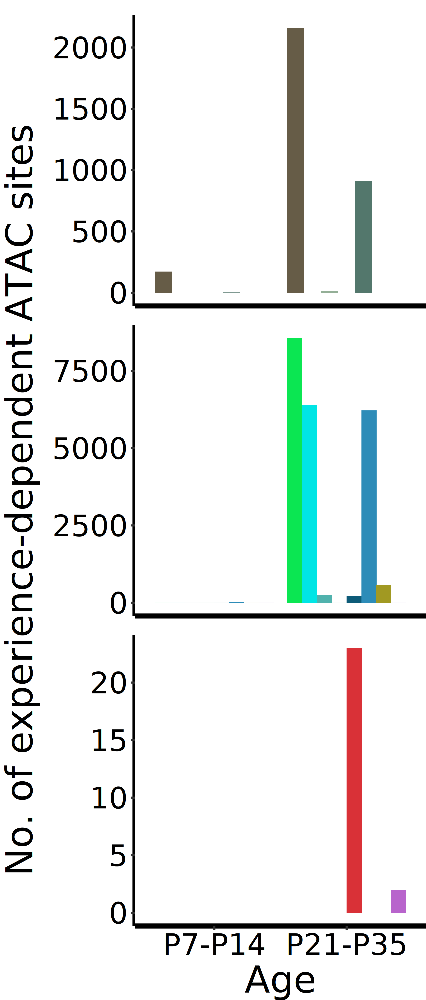

In [38]:
# Generate plot for excitatory neurons
options(repr.plot.width = 4 , repr.plot.height = 9.375,repr.plot.res=500)

sum_peak_df_dcast_ex <- sum_peak_df_dcast[row.names(sum_peak_df_dcast) %in% c('L2/3',
                                                                           'L4',
                                                                           'L5IT',
                                                                           'L5NP',
                                                                           'L5PT',
                                                                           'L6b',
                                                                           'L6CT',
                                                                           'L6IT'),]

sum_peak_df_dcast_in <- sum_peak_df_dcast[row.names(sum_peak_df_dcast) %in% c('CR cells',
                                                                           'Vip+',
                                                                           'Meis2+',
                                                                           'Lamp5+',
                                                                           'Sst+/Chodl+',
                                                                           'Sst+',
                                                                           'Pvalb+',
                                                                           'Immature'),]

sum_peak_df_dcast_non <- sum_peak_df_dcast[row.names(sum_peak_df_dcast) %in% c('Astro',
                                                                            'Endo',
                                                                            'Micro',
                                                                            'Oligo',
                                                                            'OPC',
                                                                            'SMC-Peri',
                                                                            'VLMC'),]

p1 <- ggplot(data=reshape2::melt(as.matrix(sum_peak_df_dcast_non)), aes(x=Var2, y=value, fill=Var1)) +
  geom_bar(position='dodge',stat='identity',aes(fill=Var1)) + theme_classic() +
theme(legend.position='none',
      axis.text.y = element_text(size=20,color='black'),
      axis.text.x = element_blank(),
      axis.title.x = element_blank(),
      axis.title.y = element_blank(),
      axis.ticks.x = element_blank(),
          axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2),
     plot.margin = margin(10, 0, 0, 10)) +
scale_fill_manual(values = c('Astro' = col_df_filt[col_df_filt$subtype=='Astro','color'],
                              'Endo' = col_df_filt[col_df_filt$subtype=='Endo','color'],
                              'Micro' = col_df_filt[col_df_filt$subtype=='Micro','color'],
                              'Oligo' = col_df_filt[col_df_filt$subtype=='Oligo','color'],
                              'OPC' = col_df_filt[col_df_filt$subtype=='OPC','color'],
                              'SMC-Peri' = col_df_filt[col_df_filt$subtype=='SMC-Peri','color'],
                              'VLMC' = col_df_filt[col_df_filt$subtype=='VLMC','color']))  +
guides(fill=guide_legend("Cell type", title.position = "top"))

p2 <- ggplot(data=reshape2::melt(as.matrix(sum_peak_df_dcast_ex)), aes(x=Var2, y=value, fill=Var1)) +
  geom_bar(position='dodge',stat='identity',aes(fill=Var1)) + theme_classic() +
theme(legend.position='none',
      axis.text.y = element_text(size=20,color='black'),
      axis.text.x = element_blank(),
      axis.title.x = element_blank(),
      axis.title.y = element_blank(),
      axis.ticks.x = element_blank(),
          axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2),
     plot.margin = margin(10, 0, 0, 10)) +
xlab('Age') + ylab('No. DEGs per cell type') +
scale_fill_manual(values = c(  'L2/3' = col_df_filt[col_df_filt$subtype=='L2/3','color'],
                                'L4' = col_df_filt[col_df_filt$subtype=='L4','color'],
                                'L5IT' = col_df_filt[col_df_filt$subtype=='L5IT','color'],
                                'L5NP' = col_df_filt[col_df_filt$subtype=='L5NP','color'],
                                'L5PT' = col_df_filt[col_df_filt$subtype=='L5PT','color'],
                                'L6IT' = col_df_filt[col_df_filt$subtype=='L6IT','color'],
                                'L6CT' = col_df_filt[col_df_filt$subtype=='L6CT','color'],
                                'L6b' = col_df_filt[col_df_filt$subtype=='L6b','color'])) +
guides(fill=guide_legend("Cell type", title.position = "top"))

p3 <- ggplot(data=reshape2::melt(as.matrix(sum_peak_df_dcast_in)), aes(x=Var2, y=value, fill=Var1)) +
  geom_bar(position='dodge',stat='identity',aes(fill=Var1)) + theme_classic() +
theme(legend.position ='none',
     axis.text = element_text(size=20,color='black'),
     axis.title.x = element_text(size=25),
     axis.title.y = element_blank(),
          axis.line.x=element_line(size=1.2),
      axis.line.y=element_line(size=1.2),
     plot.margin = margin(10, 0, 0, 10),
     ) +
xlab('Age') +
scale_fill_manual(values = c('Pvalb+' = col_df_filt[col_df_filt$subtype=='Pvalb+','color'],
                              'Lamp5+' = col_df_filt[col_df_filt$subtype=='Lamp5+','color'],
                              'Sst+' = col_df_filt[col_df_filt$subtype=='Sst+','color'],
                              'Vip+' = col_df_filt[col_df_filt$subtype=='Vip+','color'],
                              'Immature' = col_df_filt[col_df_filt$subtype=='Immature','color'],
                              'Meis2+' = col_df_filt[col_df_filt$subtype=='Meis2+','color'],
                              'CR cells' = col_df_filt[col_df_filt$subtype=='CR cells','color'],
                              'Sst+/Chodl+' = col_df_filt[col_df_filt$subtype=='Sst+/Chodl+','color'])) +
guides(fill=guide_legend("Cell type", title.position = "top"))


grid.arrange(gtable_frame(ggarrange(p1, p2, p3, draw=F)),
             left = textGrob("No. of experience-dependent ATAC sites",rot=90,gp = gpar(fontsize=25)))

# Generate cell type x chromVAR motif padj value heatmap for Fig. 2

In [3]:
# Read RDS
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [4]:
final_obj_motif_chromVAR$Phase_treatment <- ifelse(grepl('P21|P28|P35', final_obj_motif_chromVAR$Timepoint),
                                                 paste0("Late_", final_obj_motif_chromVAR$Treatment),
                                                 paste0("Early_",final_obj_motif_chromVAR$Treatment))

In [5]:
# Subset to P21 time point
final_obj_motif_chromVAR_P21 <- subset(final_obj_motif_chromVAR, subset = Timepoint == 'P21')

In [200]:
# Compare chromVAR score between NR and DR in each cell type
chromVAR_P21_diff_list <- list()

DefaultAssay(final_obj_motif_chromVAR_P21) <- 'chromvar'
Idents(final_obj_motif_chromVAR_P21) <- 'Treatment'

for (i in unique(final_obj_motif_chromVAR_P21$subtype)) { # Loop over loop.vector
            res <- FindMarkers(subset(final_obj_motif_chromVAR_P21, 
                                        subset = subtype == i), 
                                 ident.1 = 'NR', 
                                 ident.2 = 'DR',
                                test.use='MAST')
            res$motif <- ConvertMotifID(final_obj_motif_chromVAR_P21@assays$peaks@motifs,id = rownames(res))
            res$logpadj <- -log10(res$p_val_adj)
            res$scaled_logpadj <- res$logpadj / res[1,'logpadj']
            chromVAR_P21_diff_list[[i]] <- res
            chromVAR_P21_diff_list[[i]]$celltype <- i
}

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
"NaNs produced"
Warning message in mean.fxn(object[features, cells.2, drop = FALSE]):
"NaNs produced"

 Completed [>-------------------------------------------]   2% with 0 failures

 Completed [>-------------------------------------------]   3% with 0 failures

 Completed [=>------------------------------------------]   4% with 0 failures

 Completed [=>------------------------------------------]   5% with 0 failures

 Completed [=>------------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   6% with 0 failures

 Completed [==>-----------------------------------------]   7% with 0 failures

 Completed [==>-----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   8% with 0 failures

 Completed [===>----------------------------------------]   9% with 0 failures

 Completed [===>-----------

ERROR: Error in ValidateCellGroups(object = object, cells.1 = cells.1, cells.2 = cells.2, : Cell group 1 has fewer than 3 cells


In [202]:
# Save results
saveRDS(chromVAR_P21_diff_list, '/n/groups/neuroduo/Bruno/RDS_files/chromVAR_P21_diff_list.rds')

In [6]:
# Read results
chromVAR_P21_diff_list <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/chromVAR_P21_diff_list.rds')

In [7]:
# Combine into single dataframe
df <- do.call(rbind, chromVAR_P21_diff_list)

In [8]:
# Collect top 2 motifs per cell type
top_motifs <- list()
for (i in unique(df$celltype)) { # Loop over loop.vector
            top2 <- df[df$celltype ==i,][1:2,'motif']
    top_motifs[[i]] <- data.frame(motifs = top2,
                                  celltype = rep(i,2))
}

# Combine into single df
top_motif_df <- do.call(rbind, top_motifs)

# Drop out ns cell-types
top_motif_df_filt <- top_motif_df[top_motif_df$celltype %notin% c('L6b',
                                                                 'Meis2+',
                                                                 'Lamp5+',
                                                                 'Sst+/Chodl+',
                                                                 'OPC',
                                                                 'L5NP'),]
# Collect unique motifs for plotting
uniq_motifs <- unique(top_motif_df_filt$motifs)

In [9]:
# Subset results for unique motifs
sig_df <- df[df$motif %in% uniq_motifs,]

In [10]:
# Collect relevant columns for plotting
plot_df <- sig_df[,c('motif',
                    'scaled_logpadj',
                    'celltype')]

In [11]:
# Cast dataframe to wide form
plot_df_cast <- acast(setDT(plot_df), celltype~motif,value.var='scaled_logpadj')
plot_df_cast[is.na(plot_df_cast)] <- 0

In [12]:
# Exclude cell types with 0 significant motifs
plot_df_cast <- plot_df_cast[rownames(plot_df_cast) %notin% c('L6b','L5NP','Lamp5+','Sst+/Chodl+','Meis2+','OPC'),]

In [52]:
# Order cell types by class
plot_df_cast_reorder <- plot_df_cast[c('L2/3',
              'L4',
              'L5IT',
              'L5PT',
              'L6IT',
              'L6CT',
              'Pvalb+',
              'Sst+',
              'Vip+',
              'Micro',
              'Oligo',
              'Endo',
              'SMC-Peri',
              'VLMC',
              'Astro'),]

# Order motifs
plot_df_cast_reorder <- plot_df_cast_reorder[,c('FOSL2::JUND',
                                                'FOS::JUN',  
                                                'FOSL2::JUN',    
                                                'FOSL2',
                                                'FOSL1::JUN',
                                                'FOS::JUNB',
                                                'FOS::JUND',
                                                'JUND',
                                                'BATF::JUN',
                                                'FOSL1',
                                                'JUNB',
                                                'MAFK',
                                                'BATF',
                                                'BATF3',
                                                'Smad2::Smad3',
                                                'SP8',
                                                'SP9',
                                                'NFIB',
                                                'NR3C1')]

In [55]:
# Re-label Smad2::Smad3 for space, re-label NR3C1 and NFIB motifs
colnames(plot_df_cast_reorder)[colnames(plot_df_cast_reorder) == 'Smad2::Smad3'] <- 'Smad2/3'
colnames(plot_df_cast_reorder)[colnames(plot_df_cast_reorder) == 'NR3C1'] <- 'GR'
colnames(plot_df_cast_reorder)[colnames(plot_df_cast_reorder) == 'NFIB'] <- 'NFI'

Warning message:
"`legend_height` you specified is too small, use the default minimal
height."


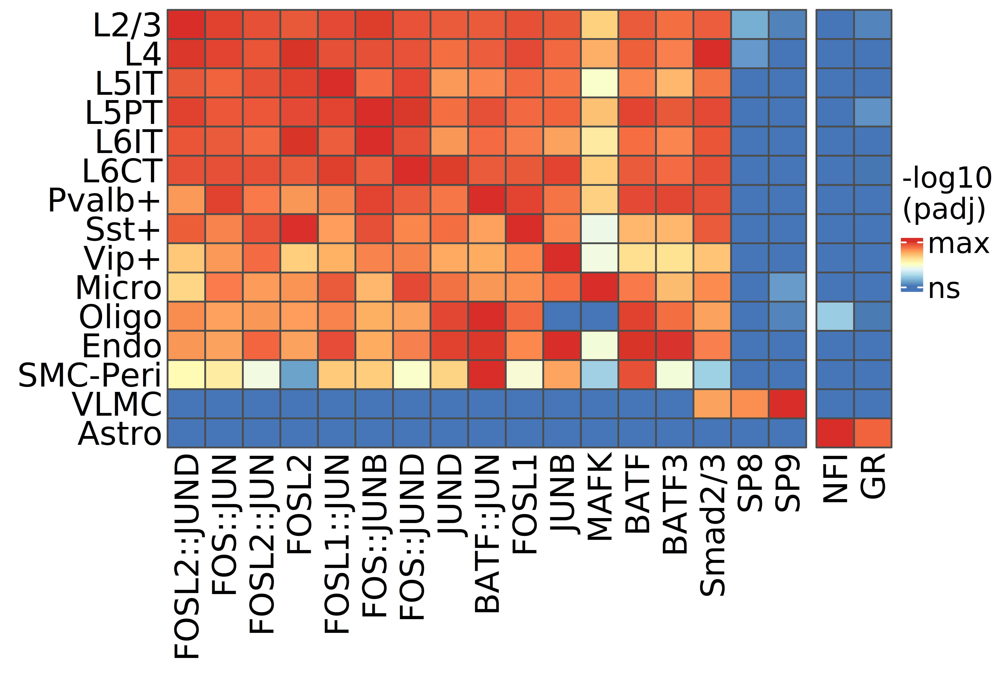

In [107]:
# Display DEG number on heatmap instead of line plot
options(repr.plot.width = 7.7 , repr.plot.height = 5.2,repr.plot.res=900)


col_fun = colorRamp2(seq(0, 1,length.out=9), rev(brewer.pal(9, "RdYlBu")))

p <- ComplexHeatmap::pheatmap(plot_df_cast_reorder, 
         cluster_rows = F,
         cluster_cols = F,
         fontsize = 18,
        col = col_fun,  
        row_names_side = "left",
        column_split = c(rep("Group1", 17), rep("Group2", 2)),
        column_gap = unit(2, "mm"),
        column_title = NULL,
        border_color = 'grey30',
        legend = FALSE,
         show_rownames = T)

custom_lgd <- Legend(
    col_fun = col_fun,
  title = "-log10\n(padj)",
  legend_height = unit(0.1, "cm"),
  legend_width = unit(.5, "cm"),  
  at = c(0,1),
  title_position = "topleft",
  labels = c('ns','max'),
  title_gp = gpar(fontsize = 16),
  labels_gp = gpar(fontsize = 16),
  title_gap = unit(4, "mm")  # <-- This WILL work here
)



draw(p, heatmap_legend_side="right",  heatmap_legend_list = list(custom_lgd))

# Run LinkPeaks for astrocyte DEGs and compare with GR binding sites

In [3]:
# Load RDS file
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [4]:
# Subset to astrocytes
final_obj_motif_chromVAR_astro <- subset(final_obj_motif_chromVAR, subset = subtype == 'Astro')

In [5]:
# Read in DEGs
res_listv2_edger <- readRDS('250508_res_listv3_edger.rds')

In [6]:
# Collect unique induced genes
uniq_up_astro_DEG <- unique(c(rownames(res_listv2_edger[['Astro_P14']][(res_listv2_edger[['Astro_P14']]$FDR < 0.05) &
                                                                       (res_listv2_edger[['Astro_P14']]$logFC > 0),]),
                           rownames(res_listv2_edger[['Astro_P21']][res_listv2_edger[['Astro_P21']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P21']]$logFC > 0),]),
                           rownames(res_listv2_edger[['Astro_P28']][res_listv2_edger[['Astro_P28']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P28']]$logFC > 0),]),
                           rownames(res_listv2_edger[['Astro_P35']][res_listv2_edger[['Astro_P35']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P35']]$logFC > 0),])))

In [7]:
# Collect unique suppressed genes
uniq_down_astro_DEG <- unique(c(rownames(res_listv2_edger[['Astro_P14']][(res_listv2_edger[['Astro_P14']]$FDR < 0.05) &
                                                                       (res_listv2_edger[['Astro_P14']]$logFC < 0),]),
                           rownames(res_listv2_edger[['Astro_P21']][res_listv2_edger[['Astro_P21']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P21']]$logFC < 0),]),
                           rownames(res_listv2_edger[['Astro_P28']][res_listv2_edger[['Astro_P28']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P28']]$logFC < 0),]),
                           rownames(res_listv2_edger[['Astro_P35']][res_listv2_edger[['Astro_P35']]$FDR < 0.05 &
                                                                       (res_listv2_edger[['Astro_P35']]$logFC < 0),])))

In [8]:
library(future)
plan("multicore", workers = 6)
options(future.globals.maxSize = 200 * 1024 ^ 3)


Attaching package: 'future'


The following object is masked from 'package:AnnotationFilter':

    value




In [45]:
# Run linkPeaks for all induced genes
uniq_up_links <- LinkPeaks(final_obj_motif_chromVAR,
          expression.assay ='RNA',
          pvalue_cutoff = 1,
          score_cutoff = 0,
          peak.assay = 'peaks',
          genes.use = uniq_up_astro_DEG)

Testing 875 genes and 285942 peaks

Found gene coordinates for 806 genes

Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-2') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this che

In [47]:
# Run linkPeaks for all induced genes
uniq_down_links <- LinkPeaks(final_obj_motif_chromVAR,
          expression.assay ='RNA',
          pvalue_cutoff = 1,
          score_cutoff = 0,
          peak.assay = 'peaks',
          genes.use = uniq_down_astro_DEG)

Testing 383 genes and 285942 peaks

Found gene coordinates for 350 genes

Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-2') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this che

In [49]:
# Save RDS objects
saveRDS(as.data.frame(Links(uniq_down_links)),'/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/uniq_down_links.rds')
saveRDS(as.data.frame(Links(uniq_up_links)),  '/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/uniq_up_links.rds')

In [32]:
# Read in data
uniq_down_links_df <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/uniq_down_links.rds')
uniq_up_links_df <- readRDS('/n/groups/neuroduo/Bruno/Postnatal_SHARE_seq/uniq_up_links.rds')

In [33]:
# Convert links to dataframe and granges objects
uniq_down_gr <- GRanges(seqnames = do.call(rbind,str_split(uniq_down_links_df$peak,'-'))[,1],
                       IRanges(start = as.numeric(do.call(rbind,str_split(uniq_down_links_df$peak,'-'))[,2]),
                               end = as.numeric(do.call(rbind,str_split(uniq_down_links_df$peak,'-'))[,3])))   

uniq_up_gr <- GRanges(seqnames = do.call(rbind,str_split(uniq_up_links_df$peak,'-'))[,1],
                       IRanges(start = as.numeric(do.call(rbind,str_split(uniq_up_links_df$peak,'-'))[,2]),
                               end = as.numeric(do.call(rbind,str_split(uniq_up_links_df$peak,'-'))[,3])))    

In [34]:
# Load in GR sites
GR_sites <- rtracklayer::import.bed('/n/groups/neuroduo/Bruno/Cell_type_GR_CnR_v2/Astro_DR_NR/CR01_count_edger_report_str_FC25.col.bed')

# Isolate GR-overlapping links from non-overlapping links
overlap_down_df <- as.data.frame(uniq_down_gr[unique(queryHits(findOverlaps(uniq_down_gr, GR_sites)))])
overlap_up_df <- as.data.frame(uniq_up_gr[unique(queryHits(findOverlaps(uniq_up_gr, GR_sites)))])

uniq_down_links_df$GR_pos <- ifelse(uniq_down_links_df$peak %in% paste0(overlap_down_df$seqnames,'-',overlap_down_df$start,'-',overlap_down_df$end),
                          'GR+','GR-')

uniq_up_links_df$GR_pos <- ifelse(uniq_up_links_df$peak %in% paste0(overlap_up_df$seqnames,'-',overlap_up_df$start,'-',overlap_up_df$end),
                          'GR+','GR-')


# Compute -log10pval
uniq_down_links_df$logp <- -log10(uniq_down_links_df$pvalue)
uniq_up_links_df$logp <- -log10(uniq_up_links_df$pvalue)

In [118]:
uniq_up_links_df$direction <- 'Up'
uniq_down_links_df$direction <- 'Down'
rbind_links_df <- rbind(uniq_down_links_df,uniq_up_links_df)

In [161]:
t.test(rbind_links_df[(rbind_links_df$GR_pos == 'GR-') & (rbind_links_df$direction == 'Down'),'score'],
       rbind_links_df[(rbind_links_df$GR_pos == 'GR-') & (rbind_links_df$direction == 'Up'),'score'])$p.value
t.test(rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Down'),'score'],
       rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Up'),'score'])$p.value

[1] 0.0001591694

[1] 4.650457e-199

In [162]:
cohens_d(score ~ direction, data = rbind_links_df[rbind_links_df$GR_pos == 'GR-',])
cohens_d(score ~ direction, data = rbind_links_df[rbind_links_df$GR_pos == 'GR+',])

Cohens_d,CI,CI_low,CI_high
<dbl>,<dbl>,<dbl>,<dbl>
-0.02018544,0.95,-0.03109108,-0.009279738


Cohens_d,CI,CI_low,CI_high
<dbl>,<dbl>,<dbl>,<dbl>
-0.8281819,0.95,-0.896738,-0.7595533


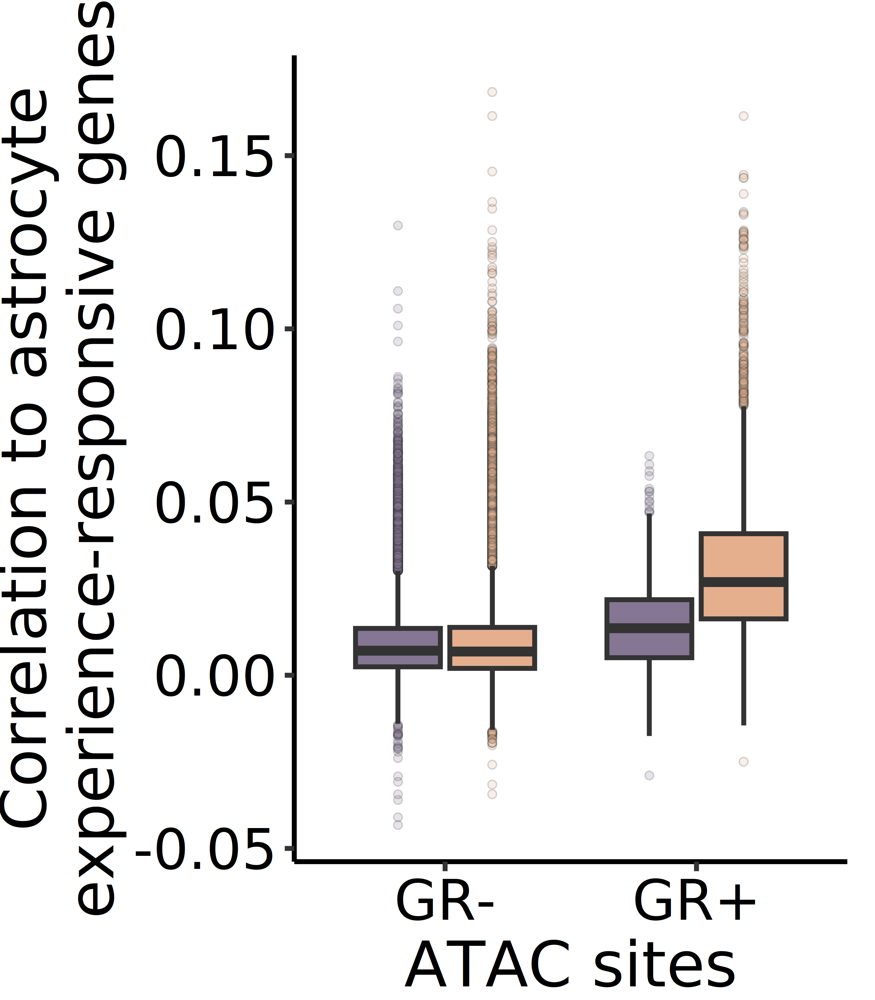

In [165]:
options(repr.plot.width=3.5, repr.plot.height=4,repr.plot.res=900)

p <- ggplot(rbind_links_df, aes(x=GR_pos, y=score,fill=direction)) + 
  geom_boxplot(outlier.stroke = 0.2,outlier.size=1,outlier.alpha=0.2,outlier.shape=21) + theme_classic() + theme(legend.position='none',
                                          axis.text.y = element_text(color='black',size=16),
                                           axis.text.x = element_text(color='black',size=16),
                                          axis.title.y = element_text(color='black',size=18),
                                          axis.title.x = element_text(color='black',size=18),
                                          plot.margin = margin(16,8,0,0),
                                          legend.title.position = 'top'
                                          ) + ylab('Correlation to astrocyte\nexperience-responsive genes') + xlab('ATAC sites') + 
scale_fill_manual(values=c("#857693","#e5af8d")) #+   geom_signif(
    #y_position = c(0.18,0.18), xmin = c(0.8,1.8), xmax = c(1.2,2.2),textsize=5,
    #annotation = c('1.6e-4',"4.7e-199"), tip_length = 0) + ylim(c(-0.05,0.19))
p

In [163]:
t.test(rbind_links_df[(rbind_links_df$GR_pos == 'GR-') & (rbind_links_df$direction == 'Down'),'logp'],
       rbind_links_df[(rbind_links_df$GR_pos == 'GR-') & (rbind_links_df$direction == 'Up'),'logp'])$p.value
t.test(rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Down'),'logp'],
       rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Up'),'logp'])$p.value

[1] 7.219385e-05

[1] 5.775263e-133

In [164]:
cohens_d(logp ~ direction, data = rbind_links_df[rbind_links_df$GR_pos == 'GR-',])
cohens_d(logp ~ direction, data = rbind_links_df[rbind_links_df$GR_pos == 'GR+',])

Cohens_d,CI,CI_low,CI_high
<dbl>,<dbl>,<dbl>,<dbl>
0.01920619,0.95,0.008300509,0.03011181


Cohens_d,CI,CI_low,CI_high
<dbl>,<dbl>,<dbl>,<dbl>
-0.4697848,0.95,-0.5371478,-0.4023793


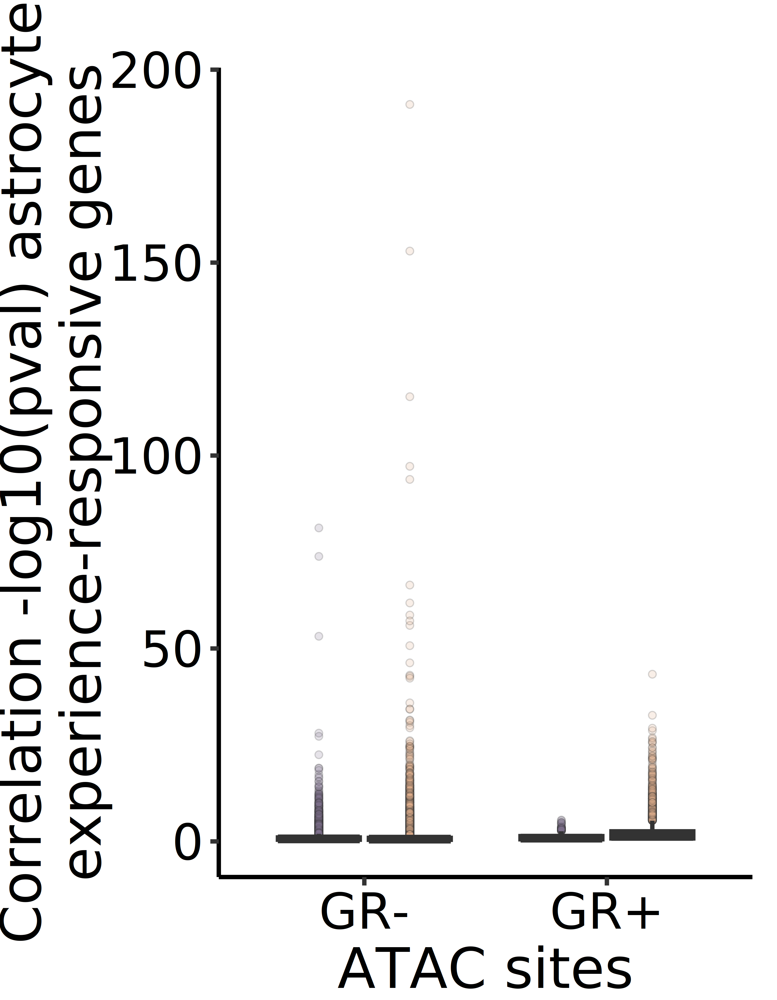

In [166]:
options(repr.plot.width=3.5, repr.plot.height=4.5,repr.plot.res=900)

p <- ggplot(rbind_links_df, aes(x=GR_pos, y=logp,fill=direction)) + 
  geom_boxplot(outlier.stroke = 0.2,outlier.size=1,outlier.alpha=0.2,outlier.shape=21) + theme_classic() + theme(legend.position='none',
                                          axis.text.y = element_text(color='black',size=16),
                                           axis.text.x = element_text(color='black',size=16),
                                          axis.title.y = element_text(color='black',size=18),
                                          axis.title.x = element_text(color='black',size=18),
                                          plot.margin = margin(22,8,0,0),
                                          legend.title.position = 'top'
                                          ) + ylab('Correlation -log10(pval) astrocyte\nexperience-responsive genes') + xlab('ATAC sites') + 
scale_fill_manual(values=c("#857693","#e5af8d"))
p

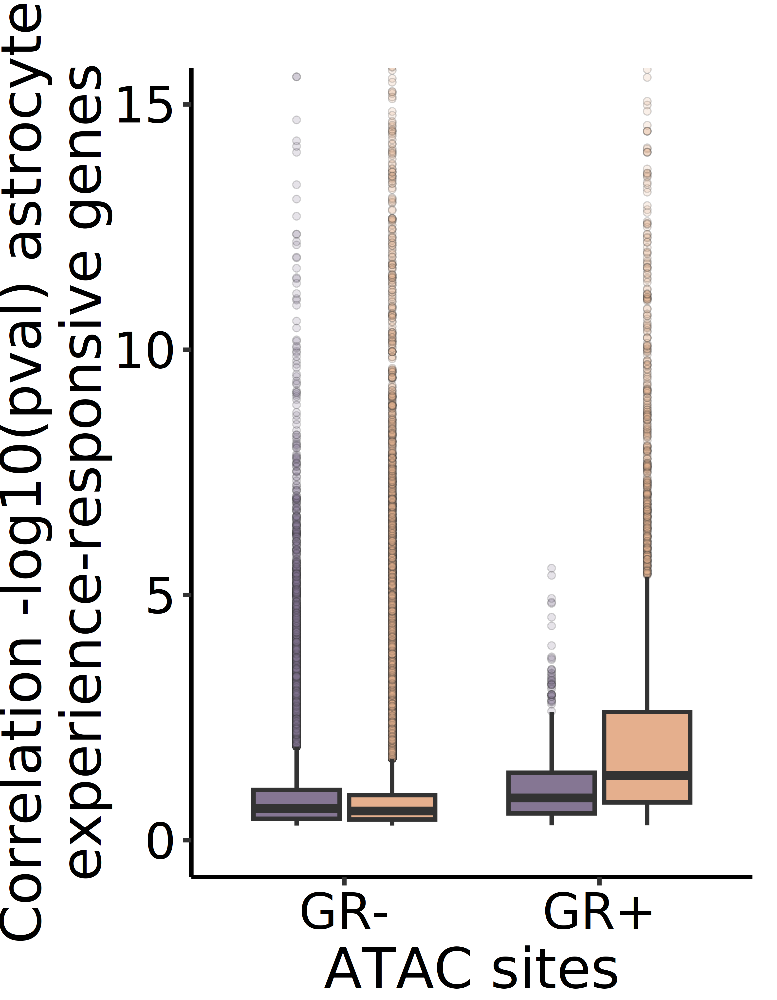

In [167]:
options(repr.plot.width=3.5, repr.plot.height=4.5,repr.plot.res=900)

p <- ggplot(rbind_links_df, aes(x=GR_pos, y=logp,fill=direction)) + 
  geom_boxplot(outlier.stroke = 0.2,outlier.size=1,outlier.alpha=0.2,outlier.shape=21) + theme_classic() + theme(legend.position='none',
                                          axis.text.y = element_text(color='black',size=16),
                                           axis.text.x = element_text(color='black',size=16),
                                          axis.title.y = element_text(color='black',size=18),
                                          axis.title.x = element_text(color='black',size=18),
                                          plot.margin = margin(22,8,0,0),
                                          legend.title.position = 'top'
                                          ) + ylab('Correlation -log10(pval) astrocyte\nexperience-responsive genes') + xlab('ATAC sites') + 
scale_fill_manual(values=c("#857693","#e5af8d")) + coord_cartesian(ylim = c(0,15)) #+   geom_signif(
    #y_position = c(0.18,0.18), xmin = c(0.8,1.8), xmax = c(1.2,2.2),textsize=5,
    #annotation = c('1.6e-4',"4.7e-199"), tip_length = 0) + ylim(c(-0.05,0.19))
p

In [186]:
rbind_links_df$GR_pos_direction <- paste0(rbind_links_df$GR_pos, '_', rbind_links_df$direction)

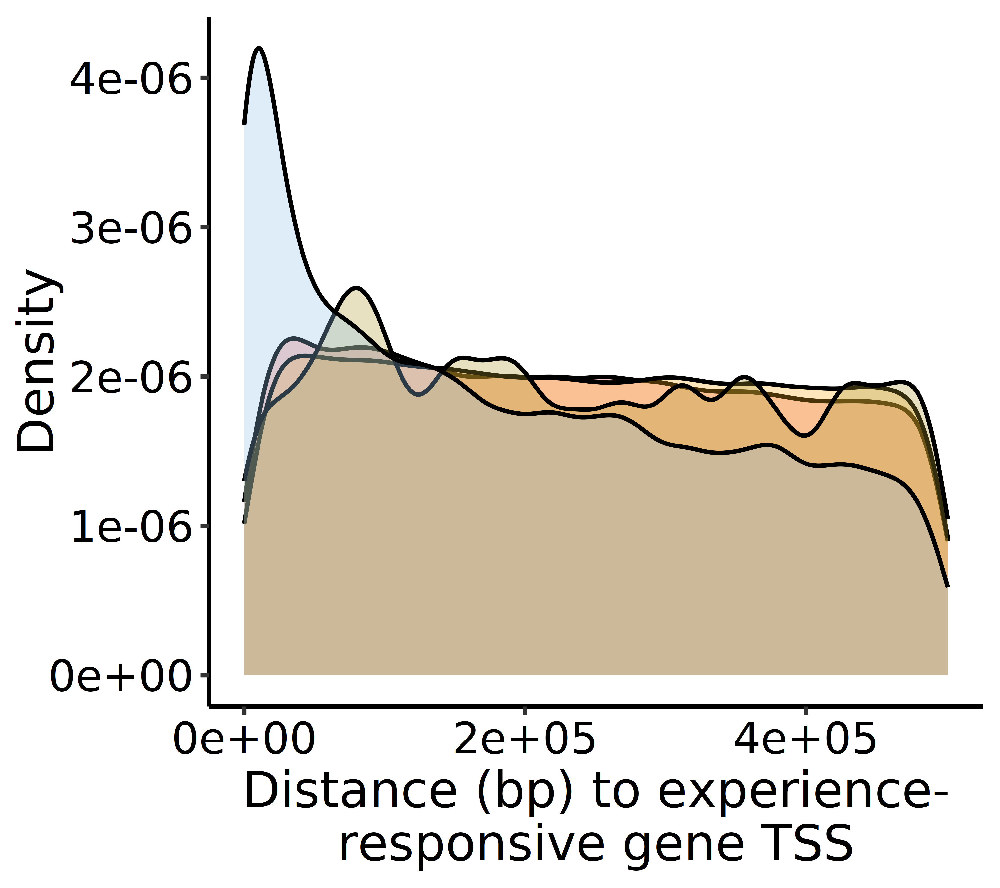

In [246]:
options(repr.plot.width=4.5, repr.plot.height=4,repr.plot.res=900)

ggplot(rbind_links_df, aes(x = width)) + 
  geom_density(bw=15000,aes(fill=factor(GR_pos_direction)),lwd = 0.5, alpha = 0.3) + theme_classic() + 
theme(legend.position='none',
     axis.title = element_text(size=16,color='black'),
      axis.text = element_text(size=14,color='black')) + 
xlab('Distance (bp) to experience-\nresponsive gene TSS') +
ylab('Density') + 
scale_fill_manual(values = as.vector(paletteer::paletteer_d("fishualize::Pseudocheilinus_tetrataenia")[1:4])) + 
scale_x_continuous(breaks=c(0,200000,400000))

In [251]:
ks.test(rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Down'),'width'],
       rbind_links_df[(rbind_links_df$GR_pos == 'GR+') & (rbind_links_df$direction == 'Up'),'width'])$p.value

Warning message in ks.test.default(rbind_links_df[(rbind_links_df$GR_pos == "GR+") & :
"p-value will be approximate in the presence of ties"


[1] 1.659783e-13

# Volcano plot of experience-dependent TF motifs in astrocytes

In [205]:
astro_chromvar_res <- chromVAR_P21_diff_list[['Astro']] 

In [206]:
astro_chromvar_res$diff_expressed <- ifelse((astro_chromvar_res$p_val_adj < 0.01) & (astro_chromvar_res$avg_log2FC > 0),'Up',
                                            ifelse((astro_chromvar_res$p_val_adj < 0.01) & (astro_chromvar_res$avg_log2FC < 0),'Down','ns'))

In [222]:
astro_chromvar_res$diff_expressed <- factor(astro_chromvar_res$diff_expressed,levels = c('Up','Down','ns'))

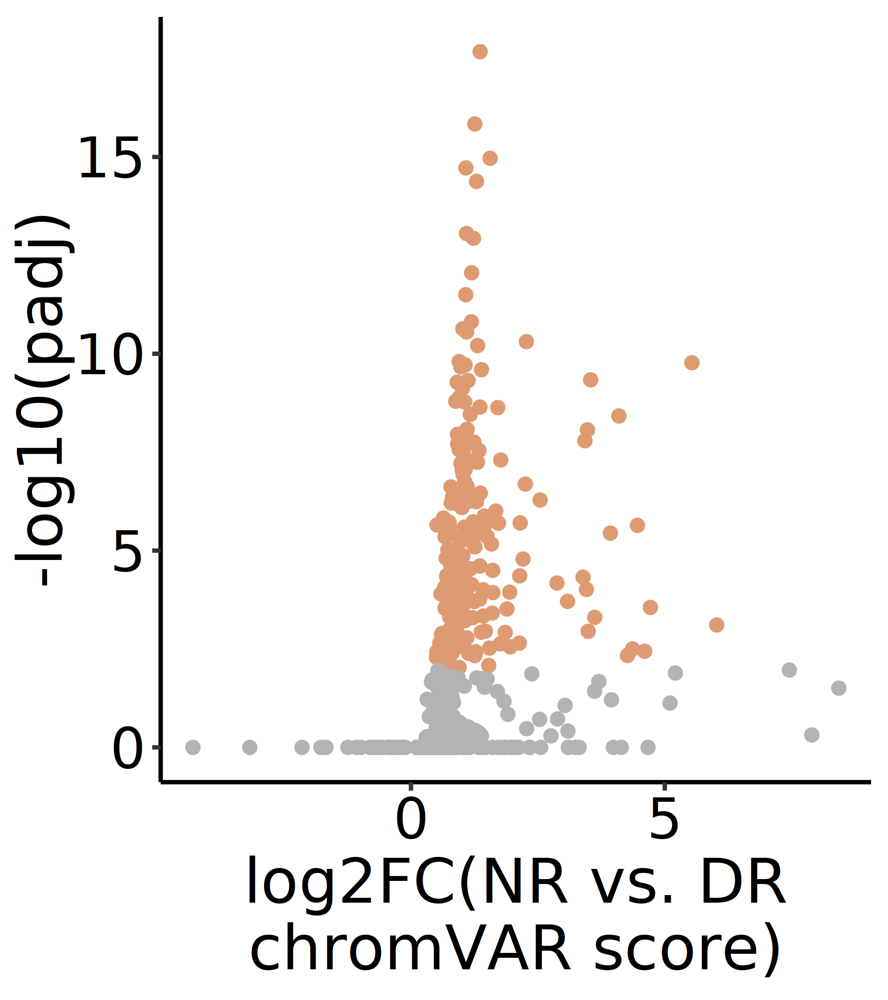

In [235]:
options(repr.plot.width=4, repr.plot.height=4.5)

# Make Volcano plot
p8 <- ggplot(data = astro_chromvar_res %>% arrange(diff_expressed), aes(x = avg_log2FC, y = -log10(p_val_adj), col = diff_expressed)) + geom_point(size=1.5) + 
    theme_classic() + 
    scale_color_manual(values = c("#DE9B71FF","grey70", "#675478FF")) +
    theme(axis.text = element_text(size = 18, color = 'black'),
          axis.title = element_text(size = 20),
          plot.title = element_text(size = 20, hjust = 0.5),
          legend.position = 'None') +
    xlab('log2FC(NR vs. DR\nchromVAR score)') +
    ylab('-log10(padj)')# +
p8

# Visualize NR3C1 chromvar score as line plots for Fig. 2

In [ ]:
# Load RDS file
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [147]:
# Subset astrocytes
Astro <- subset(final_obj_motif_chromVAR, subset = Identity == 'Astro')

In [148]:
# Create dataframe of chromvar score
astro_nr3c1_df <- data.frame(counts = GetAssayData(Astro, assay = "chromvar", slot = "data")['MA0113.3',],
      Treatment = Astro$Treatment,
      Timepoint = Astro$Timepoint)

# Add time variable for plotting
astro_nr3c1_df$Time <- ifelse(astro_nr3c1_df$Timepoint=='P07',7,
                        ifelse(astro_nr3c1_df$Timepoint=='P14',14,
                               ifelse(astro_nr3c1_df$Timepoint=='P21',21,
                                      ifelse(astro_nr3c1_df$Timepoint=='P28',28,35))))

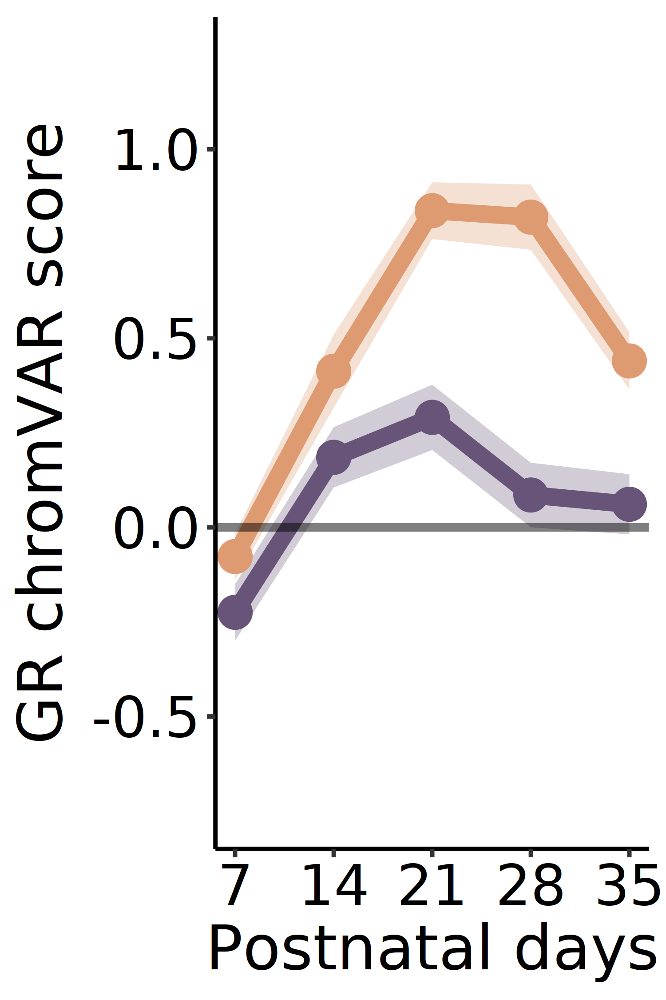

In [165]:
# Visualize astrocyte chromVAR NR3C1 motif score as trendline plot
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

astro_nr3c1_df_summary <- summarySE(astro_nr3c1_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(astro_nr3c1_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + ci, ymin = counts - ci,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +

scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

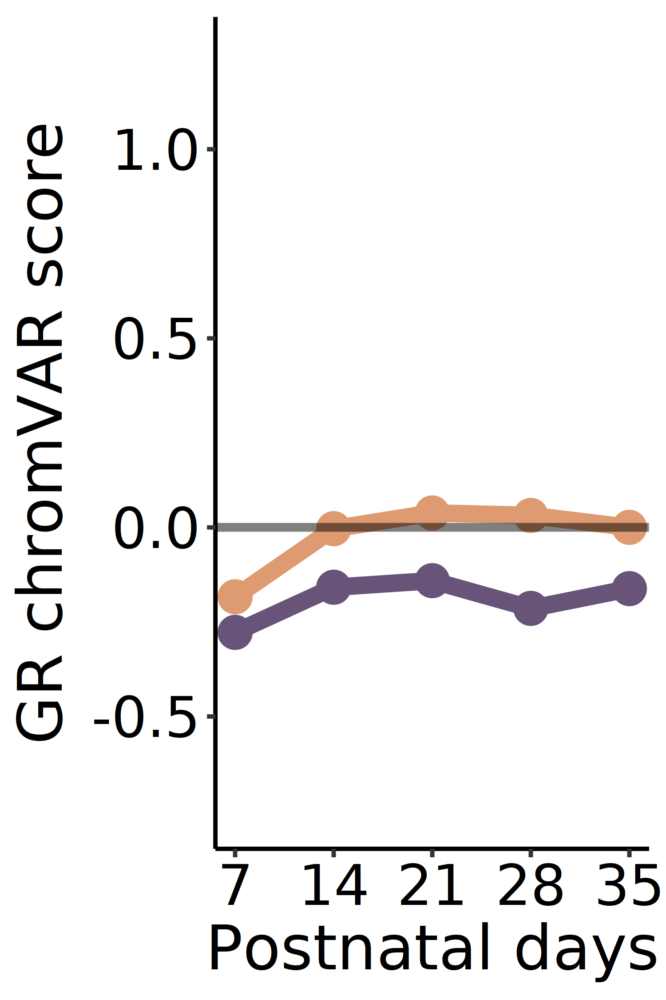

In [168]:
## Generate GR chromvar score line plots for excitatory neurons 
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('EX'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
geom_line(aes(group=Treatment),linewidth=2) +
geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + 
theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

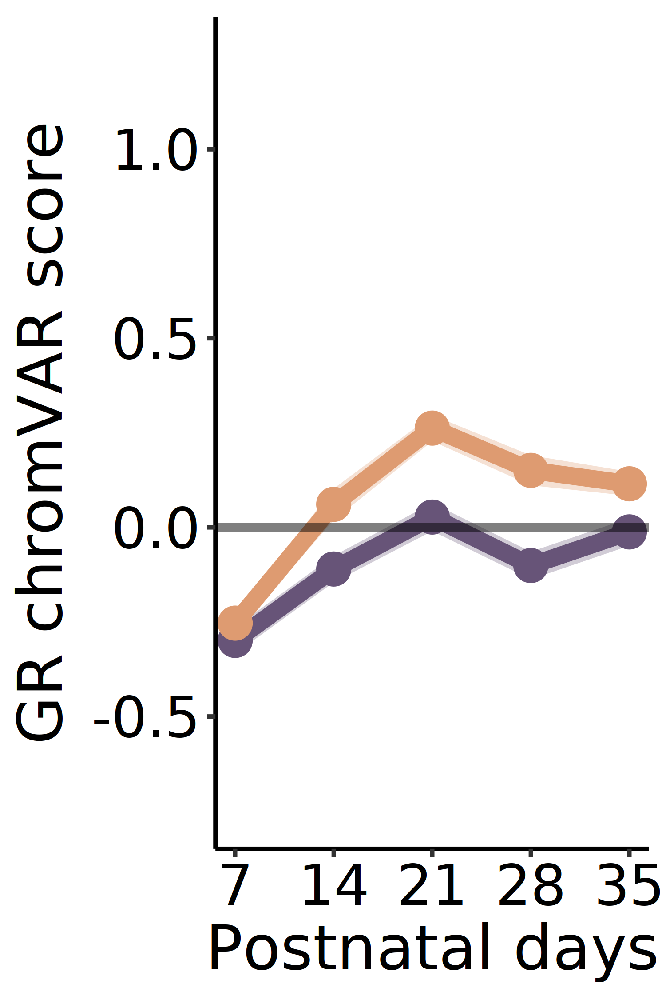

In [169]:
## Generate GR chromvar score line plots for inhibitory neurons 
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('CGE IN','MGE IN'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

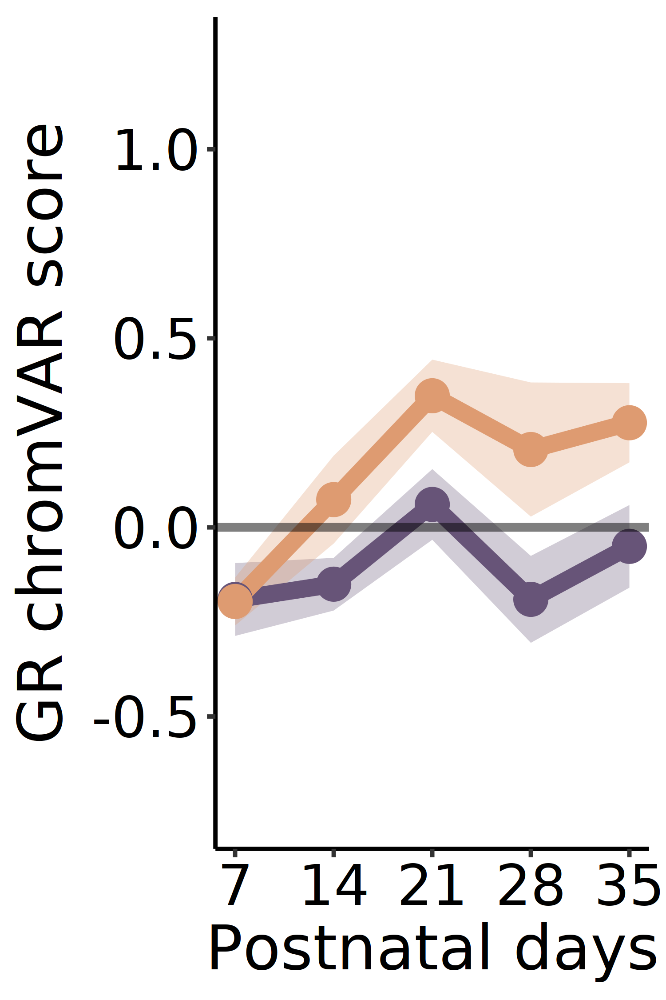

In [171]:
## Generate GR chromvar score line plots for endothelial cells  
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('Endo'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

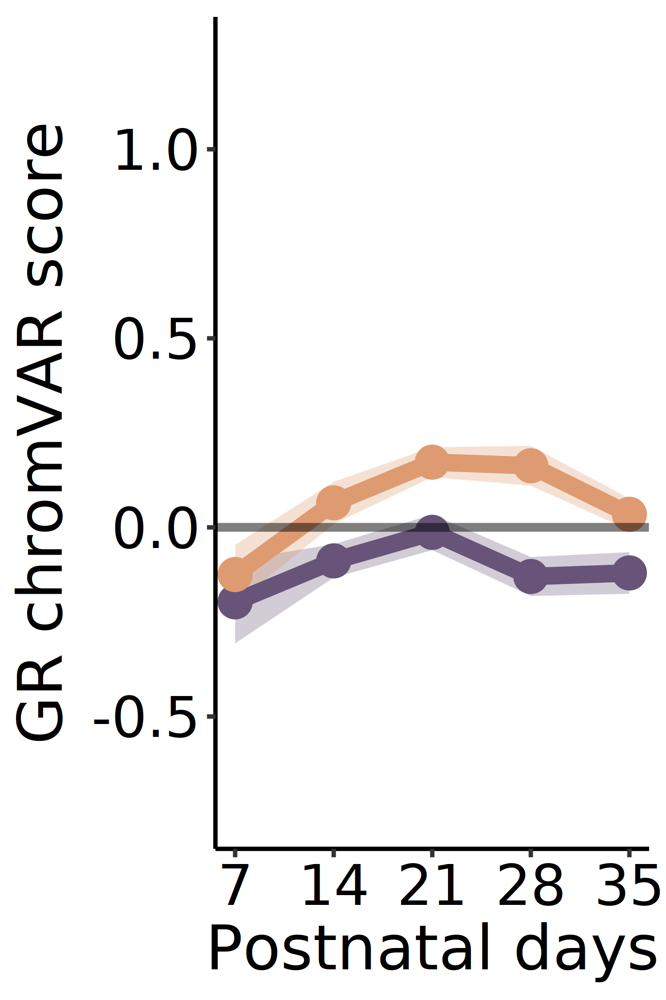

In [172]:
## Generate GR chromvar score line plots for microglia  
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('Micro'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))


# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

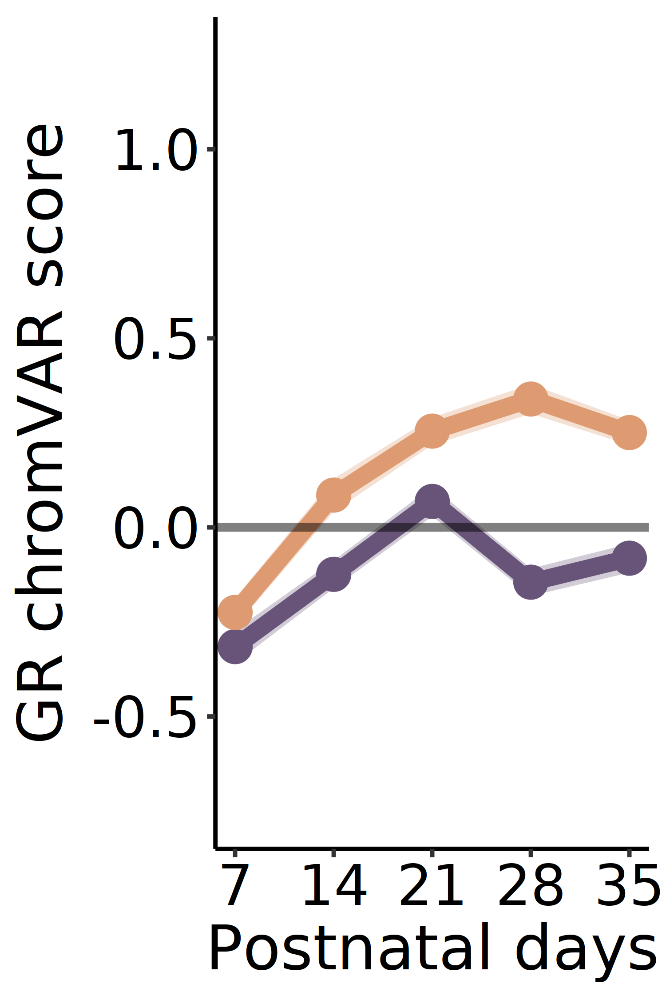

In [173]:
## Generate GR chromvar score line plots for oligodendrocytes
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('Oligo','OPC'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

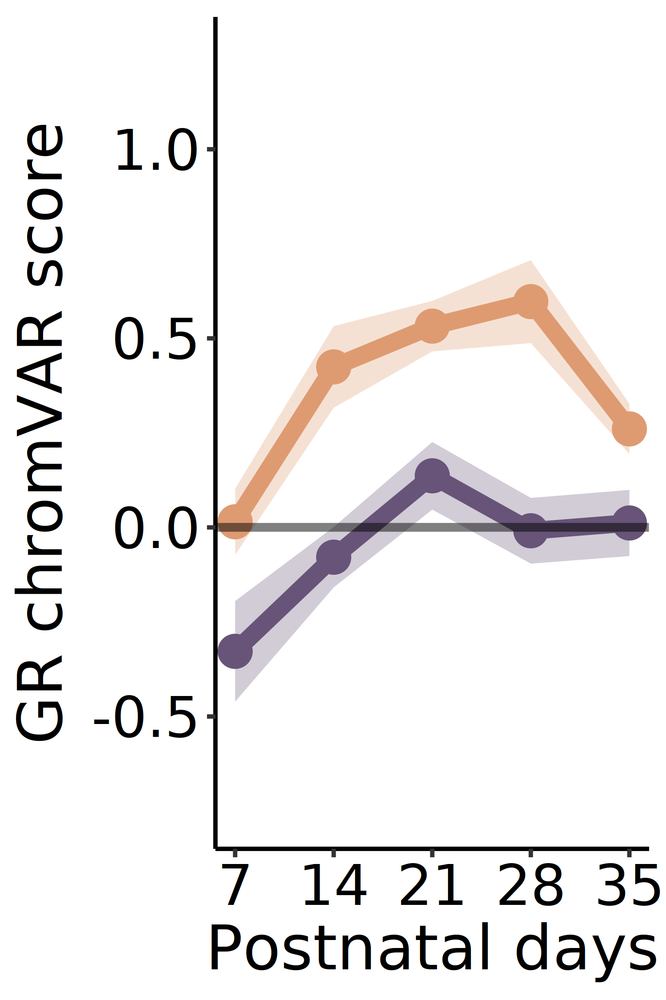

In [174]:
## Generate GR chromvar score line plots for perivascular cells
# Create dataframe of chromvar score
moi <- 'MA0113.3'
ct_obj <- subset(final_obj_motif_chromVAR, subset = Identity %in% c('SMC-Peri','VLMC'))
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR NR3C1 motif score as trendline plot for Fig. 2b
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) + 
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('GR chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) + coord_cartesian(ylim=c(-0.75,1.25))

# MAST test to identify experience-dependent chromVAR motif scores that are cell type-enriched

In [3]:
# Read in dataset
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [4]:
# Combine metadata
final_obj_motif_chromVAR$Phase_treatment <- ifelse(grepl('P21|P28|P35', final_obj_motif_chromVAR$Timepoint),
                                                 paste0("Late_", final_obj_motif_chromVAR$Treatment),
                                                 paste0("Early_",final_obj_motif_chromVAR$Treatment))

In [5]:
# Subset late timepoints
final_obj_motif_chromVAR_late <- subset(final_obj_motif_chromVAR, subset = Phase_treatment %in% c('Late_DR','Late_NR'))

In [ ]:
# Calculate the experience- and cell type-differential chromVAR motifs for each cell type
celltype <- 'L2/3'

Idents(final_obj_motif_chromVAR_late) <- 'subtype'
DefaultAssay(final_obj_motif_chromVAR_late) <- 'chromvar'
test <- FindMarkers(final_obj_motif_chromVAR_late,
                   ident.1 = celltype,
                    test.use='MAST',
                   only.pos=TRUE)

Idents(final_obj_motif_chromVAR_late) <- 'Treatment'
DefaultAssay(final_obj_motif_chromVAR_late) <- 'chromvar'
test2 <- FindMarkers(subset(final_obj_motif_chromVAR_late, subset = subtype == celltype),
                   ident.1 = 'NR',
                     ident.2 = 'DR',
                     test.use='MAST',
                   only.pos=TRUE)

DefaultAssay(final_obj_motif_chromVAR_late) <- 'peaks'
test$TF <- ConvertMotifID(Motifs(final_obj_motif_chromVAR_late),id=rownames(test),assay='chromvar')

DefaultAssay(final_obj_motif_chromVAR_late) <- 'peaks'
test2$TF <- ConvertMotifID(Motifs(final_obj_motif_chromVAR_late),id=rownames(test2),assay='chromvar')

In [ ]:
# Calculate rank-product of 2 tests, order by rank-product & select TFs for plotting
test$rank <- rank(test$p_val_adj,ties.method='first')
test2$rank <- rank(test2$p_val_adj,ties.method='first')

test2_filt <- test2[test2$TF %in% test$TF,]
merge_df <- merge(test, test2_filt, by = 'TF')
merge_df$RP <- (merge_df$rank.x ) * (merge_df$rank.y )

In [ ]:
# VLMC = Sp9, Sp8, Klf11, Sp3, NR1I3, RXRB, KLF16, KLF4, Rxrg, Rxra, Hsf1, Foxd2, Spdef, Tead1, Klf14
# Endo = ETV4, Klf4, Etv2, Sp2, Erf, Etv1, Elk4, Klf11, Sp9, Rel, Klf2, Sp8, Zbtb7a, Nr1l3, Rela
# Micro = Ikzf1, Spi1, Spib, Zkscan5, Etv2, Elf5, Ets2, Ehf, Elf3, Gabpa, Etv4, Etv1, Elf1, 
# Astro = Nr3c1, Nr3c2, Ar, Znf384, Nfib, Nfix, Nfic, Arid3a, Nfic, Sox3, Rarg, Irf1, Znf24,
# Oligo = Sox4, Sox3, Sox6, Sox10, Sox15, Foxd3, Foxe1, Foxc2, Ctcf, Jdp2,Ctclf, Foxq1
# OPC = None
# SMC = Foxc2, Tead4, Klf5, Sp4, Foxf1, Zfx, Tead3, Foxj3,Foxl2, Foxd3, Foxp2, Klf14, Stat2, Znf384, Irf7, Irf9, Irf1,

 
# PV+ = Jdp2, Nfe2l1, Maf, Nfe2l2, Arnt, Hey2, Mafa,Myc, Tcf12, Maf, Mnt, Hey1, Nhlh2, Pknox1, Pbx2, Nhlh1, Esrra, Npas2, Ascl2, Nr5a1, Esrrb,Esrrg, Myf5, Max, Sohlh2,Mycn, 
# Sst+ = Nfe2, Nfe2l1, Maf, Nfe2l2, Mafk, Mafa, Nhlh1, Ascl1, Tcf12, Maf, Ascl2, Zic2, Myog, Ptf1a, Myf5
# Vip+ =  Nhlh1, Tcf12,Ptf1a, Myf5, Nhlh2, Bhlha15,Tfap4, Myod1, Atoh1, Creb1, Atf2, Jun, Pbx3, Atf3, Pknox1,  
# Lamp5 = Nrl, Rarg, Maff, Mlxip, 
# Meis2 = None
#Sst/Chodl = None

# L2/3 = Nfe2l2, Wt1, Klf9, Egr1, Klf17, Gli2, Zkscan5, Gli3, Znf75d, Znf281, Klf11, Egr4, Znf740, Znf263, Klf10, Egr3, Tbx18, Klf4, Sp8, Rreb1, Klf16, Npas2, Thap1, Hic2, 
# L4 = NEUROD1, Neurog2, Hand2, Tal1, Atoh7, Bhlha15, Ptfa1, Neurod2, Snai3, Ptf1a, 
# L5PT = nothing
# L5IT = Eomes, Tbr1, Mga, Tbx18
# L5NP = None
# L6IT = Bach2, Nfe2
# L6CT = Jun, Jund,, Tbx1, TBX21, NFE2L1, TBX15, TBX3, MAFK, Nfe2l2, Ptf1a, Tbx6,Tbx2, Tbx4, Tbx5,Zkscan5, Zbtb18, Tbx20, Atoh1, Bhlha15, Pknox2, Tgif2, Tgif1, 
# L6b = None

In [6]:
# Create RNA & motif matrices 
DefaultAssay(final_obj_motif_chromVAR) <- 'chromvar'
chromvar_df <- GetAssayData(final_obj_motif_chromVAR)
rownames(chromvar_df) <- ConvertMotifID(final_obj_motif_chromVAR@assays$peaks@motifs,
                  id = rownames(GetAssayData(final_obj_motif_chromVAR)))
rownames(chromvar_df) <- str_to_title(rownames(chromvar_df))

In [11]:
final_obj_motif_chromVAR$subype_phase_treatment <- paste0(final_obj_motif_chromVAR$subtype,'_',
                                                         final_obj_motif_chromVAR$Phase_treatment)

# Create metadata dataframe for cell grouping
meta_df <- data.frame(cell = colnames(final_obj_motif_chromVAR),
           group = final_obj_motif_chromVAR$subype_phase_treatment)
meta_df$group <- gsub('CR cells', 'CRcells',meta_df$group)

# Exclude groups with 1 cell
meta_df <- meta_df[meta_df$group %notin% names(table(meta_df$group)[table(meta_df$group) ==1]),]

# Drop out immature cells
meta_df <- meta_df[!grepl('Immature', meta_df$group),]

# Keep only late groups
meta_df_late <- meta_df[grepl('Late',meta_df$group),]

In [28]:
agg_list <- list()
for (i in unique(meta_df_late$group)){
    rm <- rowMeans(chromvar_df[,colnames(chromvar_df) %in% meta_df_late[meta_df_late$group == i,'cell']])
    agg_list[[i]] <- rm
}
agg_chromvar_late_data = t(do.call(rbind, agg_list))
agg_chromvar_late_data_melt <- reshape2::melt(agg_chromvar_late_data)

In [30]:
agg_chromvar_late_data_melt$celltype <- do.call(rbind,str_split(agg_chromvar_late_data_melt$Var2,'_'))[,1]
agg_chromvar_late_data_melt$rearing <- do.call(rbind,str_split(agg_chromvar_late_data_melt$Var2,'_'))[,3]

In [31]:
library(RColorBrewer)
blups <- rev(brewer.pal(9, 'RdBu'))

In [39]:
options(repr.plot.width=12, repr.plot.height=5.5,repr.plot.res=900)

# Code to return mean & FC for motif of interest 
moi <- c('Egr1', # L2/3
         'Wt1',# L2/3
             'Klf9',
             'Gli2',
             'Gli3',
             'Atoh7', # L4
         'Neurod1', # L4
         'Neurod2', # L4
         'Neurog2', # L4
         'Eomes', # L5IT
         'Tbr1', # L5IT
         'Mga', # L5IT
        'Tbx18', # L5IT
        'Bach2', #L6IT
        'Nfe2', #L6IT
             'Nfe2l1', # L6CT
             'Mafk', # L6CT
             'Nfe2l2', # L6CT
        'Esrrg', #PV+
        'Esrra', #PV+
        'Maf', #PV/SST
        'Mafa',#PV/SST
            'Nhlh2',# PV/SST/VIP
             'Nhlh1', # PV/SST/VIP
             'Tcf12', # PV/SST/VIP
             'Myf5', # PV/SST/VIP

             'Nrl', # Lamp5?
            'Maff', # Lamp5?
        'Nr3c1', #Astro
        'Nr3c2', #Astro
                          'Ikzf1', #Micro
             'Spi1', #Micro
             'Sox6', #Oligo
             'Sox4', #Oligo
            'Klf4', #Endo
            'Sp2', #Endo
            'Klf2', #Endo
            'Sp9', #VLMC/SMC
            'Sp8', #VLMC/SMC
             'Sp3', #VLMC/SMC
             'Tead3', #SMC
             'Tead4' #SMC
            )

celltype_order <- rev(c('L2/3',
                      'L4',
                      'L5IT',
                      'L5NP',
                      'L5PT',
                      'L6IT',
                      'L6CT',
                      'L6b', 
                      'PV+',
                      'Sst+',
                      'Vip+',
                      'Sst+/Chodl+',
                    'Lamp5+',
                      'CR_cells',
                      'Astro',
                      'Micro',
                      'Oligo',
                      'OPC',
                      'Endo',
                    'VLMC',
                      'SMC-Peri'))



# Calculate FC
FC <- agg_chromvar_late_data_melt[agg_chromvar_late_data_melt$Var1 %in% moi,] %>% arrange(rearing) %>% 
group_by(celltype,Var1) %>% 
mutate(fold_change = value[2] - value[1]) %>% filter(rearing == 'NR')

# Calculate mean
avg_diff <- agg_chromvar_late_data_melt[agg_chromvar_late_data_melt$Var1 %in% moi,] %>% group_by(celltype,Var1) %>% summarise(mean = mean(value))

# Combine
avg_diff$fold_change <- pull(FC %>% arrange(celltype, avg_diff$celltype),'fold_change')

# Scale fold-change
avg_diff <- avg_diff %>% group_by(Var1) %>% mutate(fc_scale = scale(fold_change))

# Scale mean
avg_diff <- avg_diff %>% group_by(Var1) %>% mutate(mean_scale = scale(mean))

# Set plot order
avg_diff$Var1 <- factor(avg_diff$Var1, levels = moi)
avg_diff$celltype <- gsub('Pvalb+','PV', avg_diff$celltype) # Re-label PV
avg_diff$celltype <- factor(avg_diff$celltype, levels = celltype_order)


color = colorRampPalette(rev(brewer.pal(11, "RdGy") ))(100)

# Generate bubble plot
ggplot(na.omit(avg_diff), aes(x = Var1, y = celltype)) + 
  geom_point(aes(size = mean_scale, fill = fc_scale), color='grey40',alpha = 0.75, shape = 21) + theme_classic() + ylab('') + xlab('') +
scale_radius(#limits = c(min(avg_diff$mean_scale), 2),
            # breaks=c(-1,0,2),
             range = c(0.1,6)) + scale_fill_gradientn(oob = scales::squish,
                                                    limits=c(-1, 2.5),
                                                    colors = blups,
                                                    breaks = c(-1, 2.5)) + 
theme(axis.text.x = element_text(size=14, angle=90,color='black',hjust=1,vjust=0.5),
     axis.text.y = element_text(size=14,color='black'),
      legend.text = element_text(size=10,color='black'),
      legend.title = element_text(size=12,color='black'),
    legend.key.height = unit(3, 'mm'),
     legend.position='right') + labs(fill = 'Scaled NR-DR\nchromVAR FC',
                                      size='Scaled\nchromVAR score')  + guides(fill = guide_colorbar(title.position = "top"),
                                                                           size = guide_legend(title.position = "top"))

`summarise()` has grouped output by 'celltype'. You can override using the
`.groups` argument.


# Generate ESRRG, SPI1, TBR1 chromVAR line plots and RNA expression dot plots

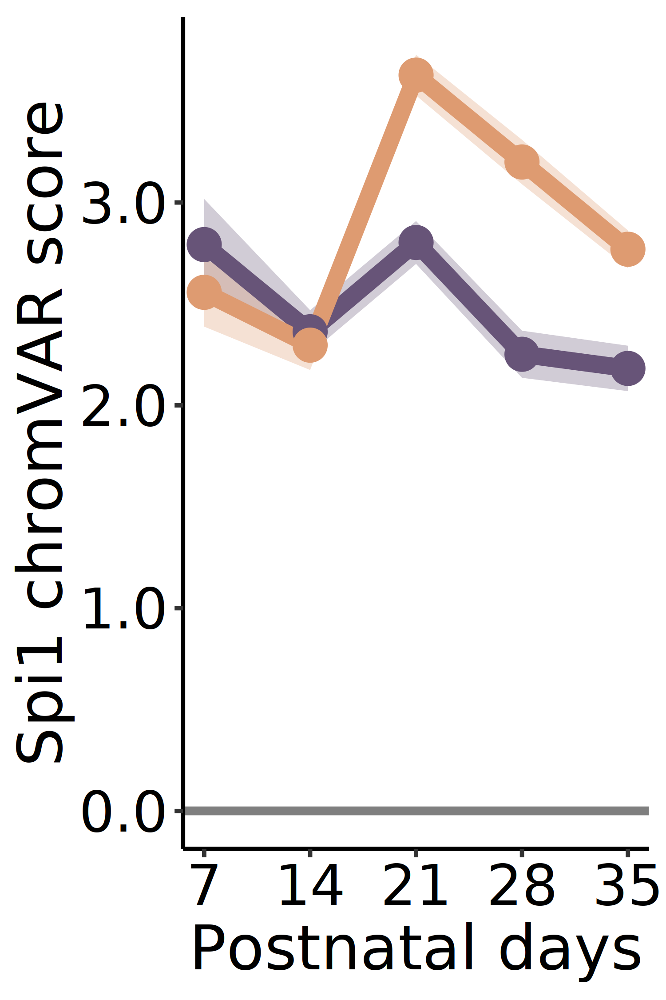

In [373]:
## Generate line plots of cell type-enriched, experience-responsive TF motifs

# Create dataframe of chromvar score
moi <- 'MA0080.5'
ct <- 'Micro'
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR motif score as trendline plot
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) +
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('Spi1 chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) #+ coord_cartesian(ylim=c(-1,1.5))

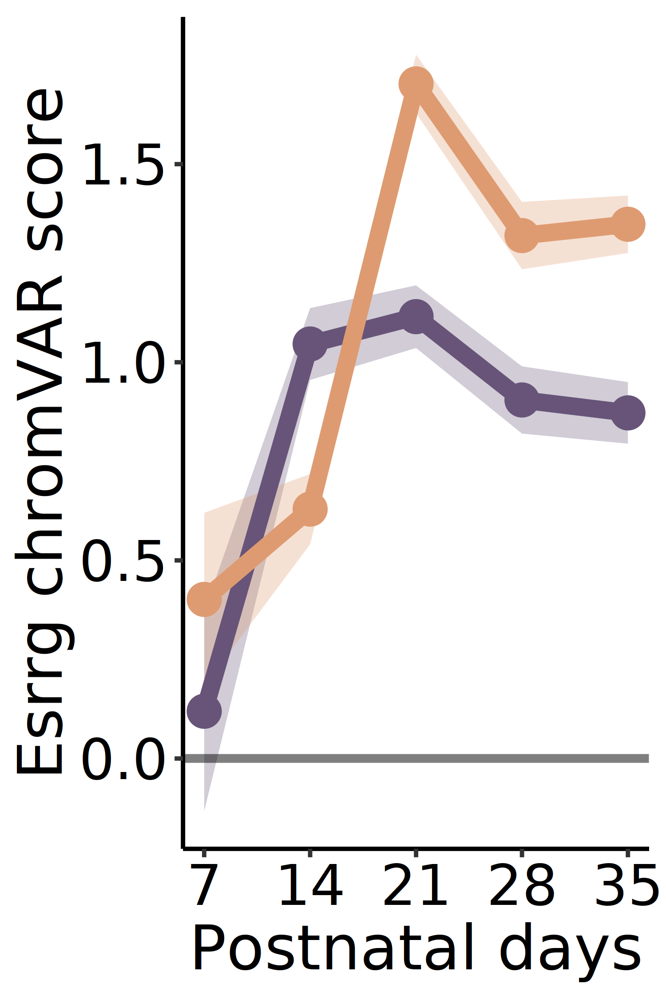

In [374]:
## Generate line plots of cell type-enriched, experience-responsive TF motifs

# Create dataframe of chromvar score
moi <- 'MA0643.1'
ct <- 'Pvalb+'
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR motif score as trendline plot
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) +
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('Esrrg chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) #+ coord_cartesian(ylim=c(-1,1.5))

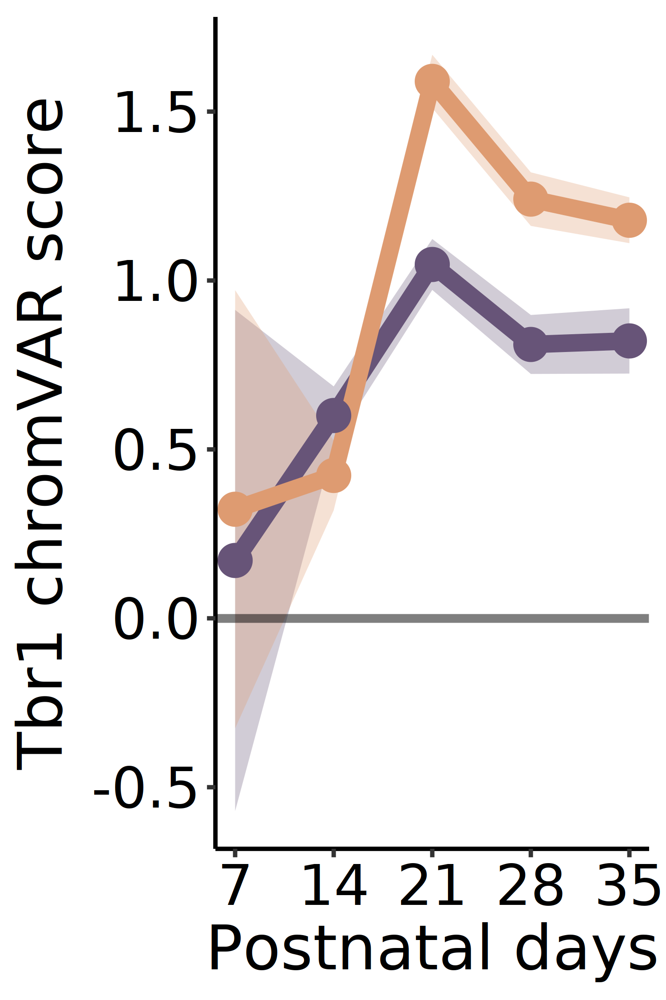

In [375]:
## Generate line plots of cell type-enriched, experience-responsive TF motifs

# Create dataframe of chromvar score
moi <- 'MA0802.1'
ct <- 'L5IT'
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)
ct_df <- data.frame(counts = GetAssayData(ct_obj, 
                                          assay = "chromvar", 
                                          slot = "data")[moi,],
      Treatment = ct_obj$Treatment,
      Timepoint = ct_obj$Timepoint)

# Add time variable for plotting
ct_df$Time <- ifelse(ct_df$Timepoint=='P07',7,
                        ifelse(ct_df$Timepoint=='P14',14,
                               ifelse(ct_df$Timepoint=='P21',21,
                                      ifelse(ct_df$Timepoint=='P28',28,35))))

# Visualize chromVAR motif score as trendline plot
options(repr.plot.width=3, repr.plot.height=4.5,repr.plot.res=500)

scaleFUN <- function(x) sprintf("%.1f", x)

ct_df_summary <- summarySE(ct_df, measurevar="counts", conf.interval = 0.95, groupvars=c("Treatment","Time"))

ggplot(ct_df_summary, aes(x=Time, y=counts, colour=Treatment)) + 
    geom_ribbon(aes(x=as.numeric(Time),ymax = counts + se, ymin = counts - se,fill=Treatment),
              alpha = 0.3,
              linetype=0) + 
    geom_line(aes(group=Treatment),linewidth=2) +
    geom_point(size=4.5) +
geom_hline(yintercept=0,lwd=1,linetype=1,alpha=0.5) + theme_classic() + scale_x_continuous(breaks=seq(7, 35,7)) +
scale_color_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
scale_fill_manual(values=rev(c("#DE9B71FF", "#675478FF"))) +
ylab('Tbr1 chromVAR score') +
xlab('Postnatal days') +
scale_y_continuous(labels=scaleFUN) +
theme(legend.position='none',
     axis.text=element_text(size=18,color='black'),
     axis.title=element_text(size=20,color='black'),
     axis.title.y = element_text(margin = margin(0,5,0,0))) #+ coord_cartesian(ylim=c(-1,1.5))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for size is already present.
Adding another scale for size, which will replace the existing scale.


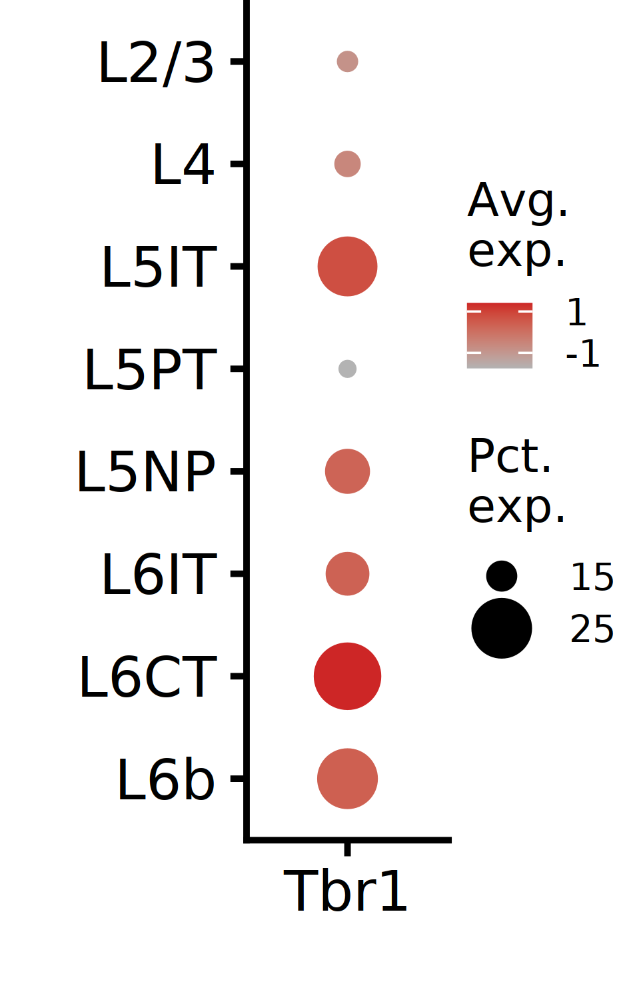

In [393]:
# Generate dot plot of Tbr1 expression in excitatory neurons
options(repr.plot.width=1.9, repr.plot.height=3,repr.plot.res=500)

ct <- c('L2/3','L4','L5IT','L5PT','L5NP','L6IT','L6CT','L6b')
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)

ct_obj$subtype <- factor(ct_obj$subtype, levels = rev(ct))

DefaultAssay(ct_obj) <- 'RNA'
DotPlot(ct_obj, features = c('Tbr1'), 
               group.by = 'subtype') + xlab('') + ylab('') + theme(legend.position='right',
                                                                   legend.title=element_text(size=10,hjust=0),
                                                                   legend.text=element_text(size=8),
                                                                   legend.key.height = unit(0.1, 'cm'),
                                                                   legend.margin = margin(0,5,0,-10),
                                                                   plot.margin = margin(0,0,0,0),
                                                                   legend.key.width = unit(0.5, 'cm')) +
guides(colour = guide_colorbar(title.position = "top"),
      size = guide_legend(title.position = "top")) + scale_color_gradient(low='grey70',high='firebrick3',breaks=c(-1,1)) +
labs(colour="Avg.\nexp.", size='Pct.\nexp.') + scale_radius(breaks=c(15,25))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for size is already present.
Adding another scale for size, which will replace the existing scale.


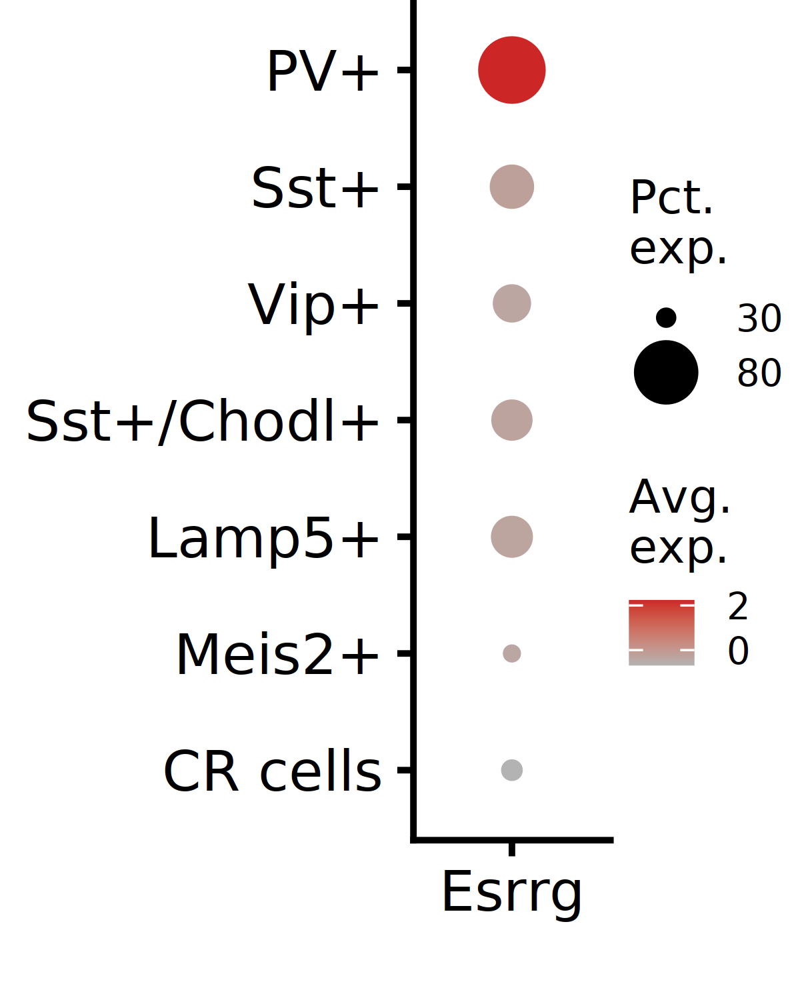

In [41]:
# Generate dot plot of Esrrg expression in inhibitory neurons

options(repr.plot.width=2.4, repr.plot.height=3,repr.plot.res=500)

ct <- c('Pvalb+','Sst+','Vip+','Sst+/Chodl+','Lamp5+','Meis2+','CR cells')
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)

ct_ord <- c('PV+','Sst+','Vip+','Sst+/Chodl+','Lamp5+','Meis2+','CR cells')
ct_obj$subtype_plotting <- gsub('Pvalb+', 'PV', ct_obj$subtype)
ct_obj$subtype_plotting <- factor(ct_obj$subtype_plotting, levels = rev(ct_ord))

DefaultAssay(ct_obj) <- 'RNA'
DotPlot(ct_obj, features = c('Esrrg'), 
               group.by = 'subtype_plotting') + xlab('') + ylab('') + theme(legend.position='right',
                                                                   legend.title=element_text(size=10,hjust=0),
                                                                   legend.text=element_text(size=8),
                                                                   legend.key.height = unit(0.1, 'cm'),
                                                                   legend.margin = margin(0,5,0,-10),
                                                                   plot.margin = margin(0,0,0,0),
                                                                   legend.key.width = unit(0.5, 'cm')) +
guides(colour = guide_colorbar(title.position = "top"),
      size = guide_legend(title.position = "top")) + scale_color_gradient(low='grey70',high='firebrick3',breaks=c(0,2)) +
labs(colour="Avg.\nexp.", size='Pct.\nexp.') + scale_radius(breaks=c(30,80))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for size is already present.
Adding another scale for size, which will replace the existing scale.


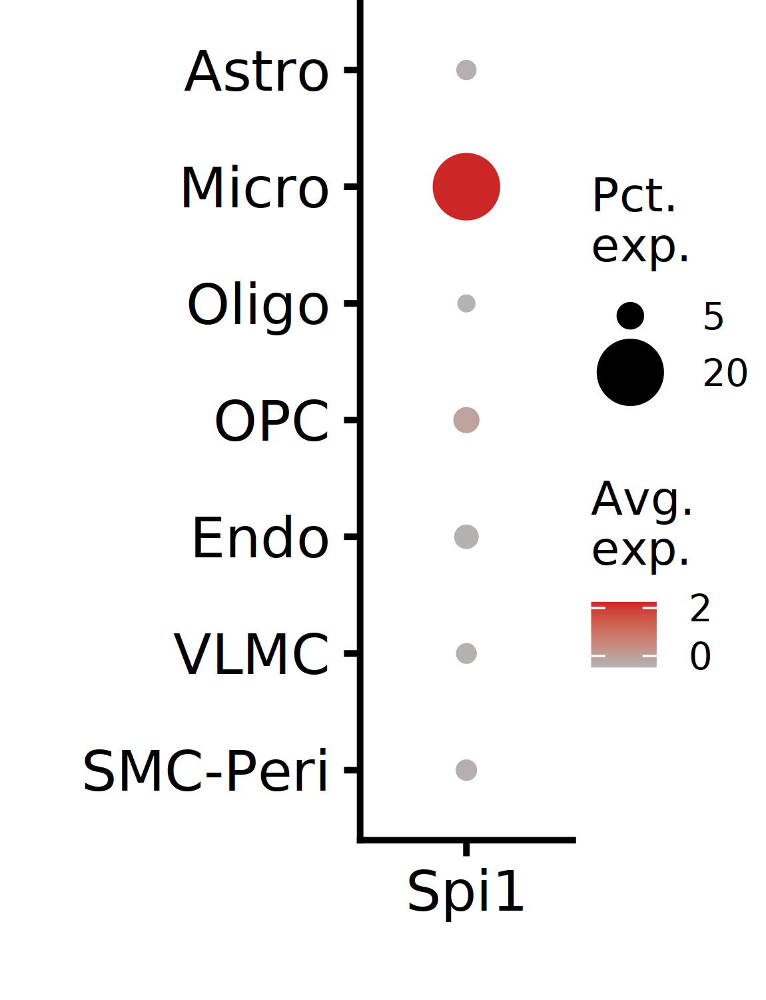

In [388]:
# Generate dot plot of Spi1 expression in non-neuronal cell types 
options(repr.plot.width=2.3, repr.plot.height=3,repr.plot.res=500)

ct <- c('Astro','Micro','Oligo','OPC','Endo','VLMC','SMC-Peri')
ct_obj <- subset(final_obj_motif_chromVAR, subset = subtype %in% ct)

ct_obj$subtype <- factor(ct_obj$subtype, levels = rev(ct))

DefaultAssay(ct_obj) <- 'RNA'
DotPlot(ct_obj, features = c('Spi1'), 
               group.by = 'subtype') + xlab('') + ylab('') + theme(legend.position='right',
                                                                   legend.title=element_text(size=10,hjust=0),
                                                                   legend.text=element_text(size=8),
                                                                   legend.key.height = unit(0.1, 'cm'),
                                                                   legend.margin = margin(0,5,0,-10),
                                                                   plot.margin = margin(0,0,0,0),
                                                                   legend.key.width = unit(0.5, 'cm')) +
guides(colour = guide_colorbar(title.position = "top"),
      size = guide_legend(title.position = "top")) + scale_color_gradient(low='grey70',high='firebrick3',breaks=c(0,2)) +
labs(colour="Avg.\nexp.", size='Pct.\nexp.') + scale_radius(breaks=c(5,20))

# Identify putative cell type regulator TFs by ATAC-RNA correlation and differential expression analysis

In [4]:
# Read in dataset
final_obj_motif_chromVAR <- readRDS('/n/groups/neuroduo/Bruno/RDS_files/230810_final_obj_motif_chromVAR.rds')

In [5]:
final_obj_motif_chromVAR$Phase_treatment <- ifelse(grepl('P21|P28|P35', final_obj_motif_chromVAR$Timepoint),
                                                 paste0("Late_", final_obj_motif_chromVAR$Treatment),
                                                 paste0("Early_",final_obj_motif_chromVAR$Treatment))

In [6]:
# Create RNA & motif matrices 
DefaultAssay(final_obj_motif_chromVAR) <- 'chromvar'
chromvar_df <- GetAssayData(final_obj_motif_chromVAR)
rownames(chromvar_df) <- ConvertMotifID(final_obj_motif_chromVAR@assays$peaks@motifs,
                  id = rownames(GetAssayData(final_obj_motif_chromVAR)))
rownames(chromvar_df) <- str_to_title(rownames(chromvar_df))

DefaultAssay(final_obj_motif_chromVAR) <- 'RNA'
RNA_df <- GetAssayData(final_obj_motif_chromVAR,slot='data')
RNA_df_subset <- RNA_df[rownames(RNA_df) %in% rownames(chromvar_df),]

Warning message:
"The `slot` argument of `GetAssayData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead."


In [7]:
# Add grouping label to metadata
final_obj_motif_chromVAR$Celltype_timepoint_condition <- paste0(final_obj_motif_chromVAR$Celltype_timepoint, '_',
                                                                final_obj_motif_chromVAR$Treatment)

In [8]:
# Create metadata dataframe for cell grouping
meta_df <- data.frame(cell = colnames(final_obj_motif_chromVAR),
           group = final_obj_motif_chromVAR$Celltype_timepoint_condition,
           subtype = final_obj_motif_chromVAR$subtype)
meta_df$group <- gsub('CR cells', 'CR_cells',meta_df$group)
meta_df$subtype <- gsub('CR cells', 'CR_cells',meta_df$subtype)

# Exclude groups with 1 cell
meta_df <- meta_df[meta_df$group %notin% names(table(meta_df$group)[table(meta_df$group) ==1]),]

In [19]:
# RNA-chromVAR score correlation at cell-type level
agg_list <- list()
for (i in unique(meta_df$subtype)){
    rm <- rowMeans(chromvar_df[,colnames(chromvar_df) %in% meta_df[meta_df$subtype == i,'cell']])
    agg_list[[i]] <- rm
}
agg_chromvar_data = t(do.call(rbind, agg_list))

agg_list <- list()
for (i in unique(meta_df$subtype)){
    rm <- rowMeans(RNA_df_subset[,colnames(RNA_df_subset) %in% meta_df[meta_df$subtype == i,'cell']])
    agg_list[[i]] <- rm
}
agg_RNA_data = t(do.call(rbind, agg_list))

# Keep only TFs with valid chromVAR score
agg_chromvar_data <- na.omit(agg_chromvar_data)
agg_RNA_data <- agg_RNA_data[rownames(agg_RNA_data) %in% rownames(agg_chromvar_data),]

res_list <- list()
for (i in rownames(agg_RNA_data)) {
    res <- cor.test(as.vector(agg_RNA_data[i,]),
                 as.vector(agg_chromvar_data[i,]), use='complete')
    res_list[[i]] <- res$estimate
}
agg_cor_df = as.data.frame(do.call(rbind, res_list))
agg_cor_df$TF <- rownames(agg_cor_df)

Warning message in cor(x, y):
"the standard deviation is zero"
Warning message in cor(x, y):
"the standard deviation is zero"
Warning message in cor(x, y):
"the standard deviation is zero"


In [20]:
# Compute maximal FC at RNA level
test <- lapply(seq_len(ncol(agg_RNA_data)), function(x){
  apply(agg_RNA_data / (agg_RNA_data[,x]+0.1),1,max,na.rm=TRUE)
}) %>% Reduce("cbind", .) #%>% rowMaxs

maxDelta_df <- data.frame(TF = rownames(test),
           rm = rowMaxs(as.data.frame(test)))
rownames(maxDelta_df) <- maxDelta_df$TF

In [49]:
# Merge dataframes
merge_df <- merge(agg_cor_df, maxDelta_df,by='TF')

In [50]:
# Add grouping level
merge_df$label <- ifelse((abs(merge_df$cor) > 0.3) &
                         (merge_df$rm > 1),
                         'YES',
                         'NO')

In [51]:
merge_df_filt <- merge_df[merge_df$label=='YES',]

Warning message:
"The `size` argument of `element_line()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`)."


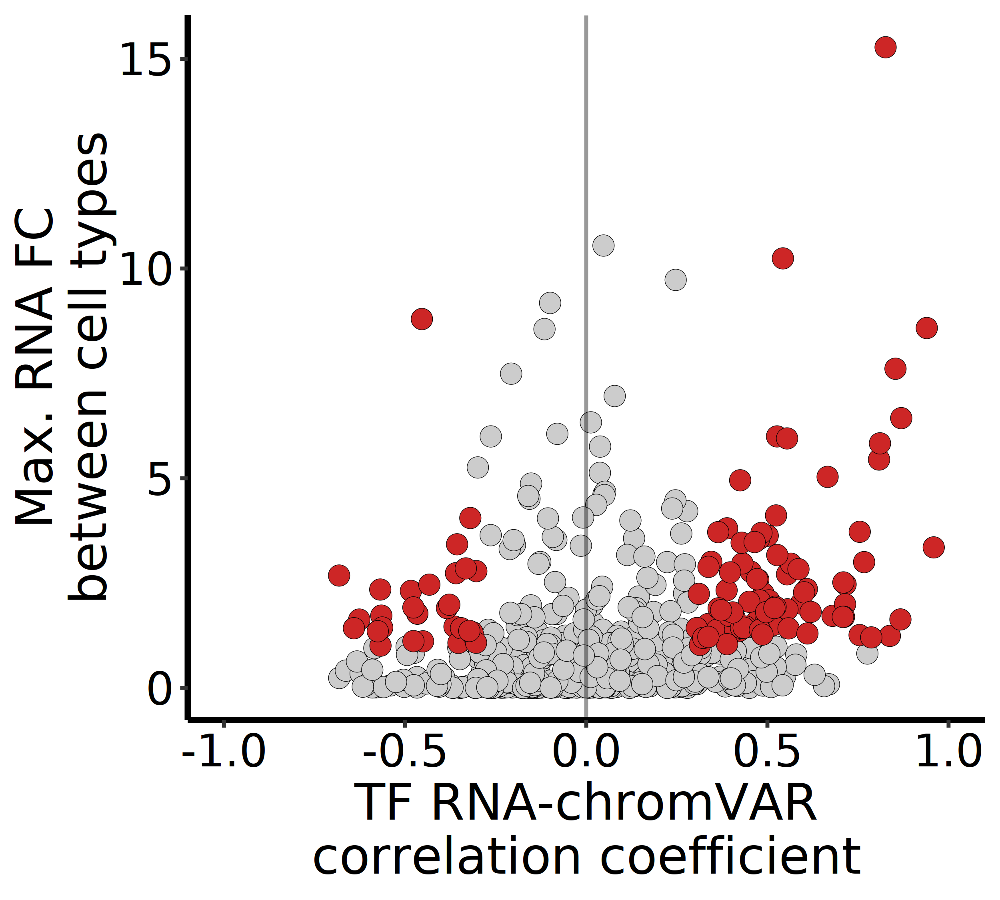

In [52]:
options(repr.plot.width=5, repr.plot.height=4.5,repr.plot.res=500)

ggplot(merge_df %>% arrange(label), aes(x=cor,y=rm,fill=label)) + 
geom_point(size=3.5,shape=21,stroke=0.1) + 
geom_vline(xintercept=0,linetype=1,lwd=0.5,alpha=0.4) +
theme_classic() + 
xlim(c(-1,1)) +scale_fill_manual(values=c('grey80','firebrick3')) + ylab('Max. RNA FC\nbetween cell types') +
xlab('TF RNA-chromVAR\ncorrelation coefficient') + 
theme(legend.position='none',
          axis.line.x=element_line(size=0.8),
      axis.line.y=element_line(size=0.8),
     axis.text=element_text(size=16,color='black'),
     axis.title=element_text(size=18,color='black'))

In [ ]:
# Micro = Spi1, Ikzf1, Elf4,Irf8,Runx1
# Endo = Ets1,Lef1,Elk3,Ppard
# Oligo/OPC = Sox2,Olig2,Sox8
# OPC = E2f7,E2f8
#VLMC=Elf1,Tcf7l1,Nfe2l2
#SMC = Osr1,Zic2
#Astro=Srebf1,Nfia,Sox9,Pou3f2


# Vip = Prox1
# Sst = Maf,Mafb,Rarb
# Sst/Chodl = Sp9
# CR cells = Ebf3, Ebf2,Lhx1,Emx2,Lhx5
# Pvalb = Mitf, Esrrg, 
# Meis2 = Sp9, Dlx6
# Immature ?
#Lamp5?

# L2/3 = Rfx3
# L4 = Rorb, Rora, Atoh7
# L5IT = Atoh7,Rora
# L5NP = Atoh7
#L5PT = Bcl6
# L6b = Tbr1
# L6CT = Tbr1
# L6IT = Tbr1

# Pan-excitatory=Neurod2
# Pan-inhibitory= Dlx1,Dlx2,Dlx5
# Pan-nonneuronal = Tcf7l2,Creb3l2
# Pan-MGE = Arx

In [58]:
# Plot results on heatmap
options(repr.plot.width=6, repr.plot.height=9,repr.plot.res=200)

features <- c('Rfx3',
                                        'Rorb',
                                        'Rora',
                                        'Atoh7',
                                        'Bcl6',
                                        'Pou3f1',
                                        'Tbr1',
               'Mitf',
               'Esrrg',
               'Maf',
               'Mafb',
                'Rarb',
                'Sp9',
                'Dlx6',
                'Prox1',
                'Ebf3', 'Ebf2','Lhx1',
               'Srebf1',
               'Sox9',
               'Nfia',
               'Ets1',
               'Lef1',
               'Spi1',
               'Ikzf1',
               'Sox2',
               'Olig2',
                                       'E2f7','E2f8',
                                       'Osr1','Zic2',
                                       'Elf1','Tcf7l1')

plot_df <- as.data.frame(agg_RNA_data[features,])

celltype_order <- c('L2/3',
                      'L4',
                      'L5IT',
                      'L5NP',
                      'L5PT',
                      'L6IT',
                      'L6CT',
                      'L6b', 
                      'Pvalb+',
                    'Immature',
                      'Sst+',
                      'Sst+/Chodl+',
                      'Meis2+',
                    'Lamp5+',
                      'Vip+',
                      'CR_cells',
                      'Astro',
                      'Endo',
                      'Micro',
                      'Oligo',
                      'OPC',
                      'SMC-Peri',
                      'VLMC')
plot_df <- plot_df[,celltype_order]
names(plot_df) <- gsub('Pvalb+', 'PV', names(plot_df)) # re-label PV
color = colorRampPalette(rev(brewer.pal(11, "RdGy") ))(100)
colnames(plot_df) <- gsub('CR_cells', 'CR cells', colnames(plot_df))

breaks <- seq(-3, 3, length.out = 100)
p1 <- ComplexHeatmap::pheatmap(t(scale(t(plot_df))),
                         #scale='row',
                         breaks = breaks,
                         color = color,
                         cluster_rows=F,
                              fontsize = 18,
                        row_names_side = "left",
                              border_color = 'grey50',
                        heatmap_legend_param = list(color_bar = "continuous",
                                        title = "Scaled TF\nexpression",
                                                    at = c(-2, 0, 2),      
                                     labels = c("-2","0","2"),
                                     legend_height = unit(1, "cm"),
                                     legend_width = unit(1.2, "cm"),
                                                    grid_width=unit(5, "mm"),
                                                    legend_width = unit(1.2, "cm"),
                                     #title_position = "topcenter",
                                     legend_direction = "vertical", 
                                     title_gp = gpar(fontsize = 13),
                                     labels_gp = gpar(fontsize = 12)),
                         cluster_cols=F)

In [59]:
options(repr.plot.width=8, repr.plot.height=9,repr.plot.res=900)

color = colorRampPalette(rev(brewer.pal(11, "PuOr") ))(100)
breaks <- seq(-1, 1, length.out = 100)

subset_merge_df <- merge_df[merge_df$TF %in% features,]
subset_merge_df <- subset_merge_df[match(features,subset_merge_df$TF),]
rownames(subset_merge_df) <- subset_merge_df$TF

p2 <- ComplexHeatmap::pheatmap(subset_merge_df[,2,drop=FALSE],
                         breaks = breaks,
                         color = color,
                         cluster_rows=F,
                              fontsize = 18,
                        show_rownames=FALSE,
                               show_colnames=FALSE,
                              border_color = 'grey50',
                        heatmap_legend_param = list(color_bar = "continuous",
                                        title = "Pearson\ncoef",
                                                    at = c(-1, 0, 1),      
                                     labels = c("-1","0","1"),
                                     legend_height = unit(1, "cm"),
                                     
                                                    grid_width=unit(5, "mm"),
                                                    legend_width = unit(1.2, "cm"),
                                     #title_position = "topcenter",
                                     legend_direction = "vertical", 
                                     title_gp = gpar(fontsize = 13),
                                     labels_gp = gpar(fontsize = 12)),
                         cluster_cols=F)

ht_list <- p1 + p2

draw(ht_list, heatmap_legend_side="right", padding = unit(c(10, 5, 0, 10), "mm"), annotation_legend_side="bottom")

Warning message:
"The input is a data frame, convert it to the matrix."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
Warning message:
"`legend_height` you specified is too small, use the default minimal
height."
